In [1]:
# import os
# os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

import time
import torch
from torch_geometric.loader import DataLoader
import argparse
import yaml
from torch_geometric.nn import radius
from torch.optim import Adam
import torch.autograd.profiler as profiler
from torch.profiler import profile, record_function, ProfilerActivity

from rbfConv import RbfConv
# from dataset import compressedFluidDataset, prepareData

import inspect
import re
def debugPrint(x):
    frame = inspect.currentframe().f_back
    s = inspect.getframeinfo(frame).code_context[0]
    r = re.search(r"\((.*)\)", s).group(1)
    print("{} [{}] = {}".format(r,type(x).__name__, x))
%matplotlib notebook
import copy

import time
import torch
from torch_geometric.loader import DataLoader
from tqdm.notebook import trange, tqdm
import argparse
import yaml
from torch_geometric.nn import radius
from torch.optim import Adam
import torch.autograd.profiler as profiler
from torch.profiler import profile, record_function, ProfilerActivity

from rbfConv import RbfConv
from dataset import compressedFluidDataset, prepareData

import inspect
import re
def debugPrint(x):
    frame = inspect.currentframe().f_back
    s = inspect.getframeinfo(frame).code_context[0]
    r = re.search(r"\((.*)\)", s).group(1)
    print("{} [{}] = {}".format(r,type(x).__name__, x))


import tomli
from scipy.optimize import minimize
import matplotlib.patches as patches
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LogNorm
from matplotlib.ticker import MaxNLocator
import matplotlib.ticker as mticker
import matplotlib.pyplot as plt

seed = 0


import random 
import numpy as np
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
# print(torch.cuda.device_count())
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print('running on: ', device)
torch.set_num_threads(1)

from joblib import Parallel, delayed

from cutlass import *
from rbfConv import *
from tqdm.notebook import tqdm

from datautils import *
# from sphUtils import *
from lossFunctions import *

In [2]:

from plotting import *
plt.style.use('dark_background')
# plt.style.use('default')
from tqdm.notebook import trange, tqdm

In [3]:
# import itertools
# from itertools import permutations

# options_x = ['rbf square', 'rbf linear', 'rbf bump', 'rbf spiky', 'rbf cubic_spline', 'rbf gaussian', 'fourier', 'chebyshev']
# options_y = options_x

# options_x = ['-x chebyshev -y chebyshev', '-x chebyshev -y fourier', '-x linear -y linear', '-x "rbf cubic_spline" -y "rbf cubic_spline"', '-x "rbf gaussian" -y "rbf gaussian"']
# options_y = ['-cmap cartesian', '-cmap polar', '-cmap preserving']

# options_x = ['-n 2 -m 2','-n 4 -m 4','-n 5 -m 5','-n 9 -m 9','-n 15 -m 15','-n 31 -m 31']
# options_y = ['-w "Wendland2"','-w "Wendland2_1D"','-w "Wendland4"','-w "cubicSpline"','-w "none"','-w "none"','-w "none"']

# combinations = []

# for x in options_x:
#     for y in options_y:
#         combinations.append((x,y))

    
# # debugPrint(len(combinations))


# for x,y in combinations:
#     print("clear && python densityNetTraining.py --epochs=25 -n 9 -m 9 -w 'none' %s %s" % ( x,y))

In [4]:
from datautils import *

In [5]:
basePath = '~/servus05/dev/datasets/generative2D/train'
basePath = '/mnt/data/datasets/generative2D/train'
basePath = os.path.expanduser(basePath)

simulationFiles = [basePath + '/' + f for f in os.listdir(basePath) if f.endswith('.hdf5')]
debugPrint(simulationFiles)

simulationFiles [list] = ['/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-16-02.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-08-20.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-28-47.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-18-34.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-39-18.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-34-07.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-01-01.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-26-18.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-31-28.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-05-55.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-10-55.hdf5', '/mnt/data/datasets/generative2D/train/generative - 2023-03-13_10-23-46.hdf5', '/mnt/data/datasets/genera

In [6]:
from tqdm.notebook import tqdm

In [7]:


which_x = 'rbf_x'
which_y = 'windowFunction'
which_z = 'networkSeed'

In [8]:
# trainFolder = '/mnt/c/Users/Rimuru/trainingData'
trainFolder = '~/trainingdata_2D_deltaSPH_001'
trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste'
# trainFolder = '~/servus03/torchSPH2/Cconv/trainingData'
# trainFolder = '~/servus03/torchSPH2/Cconv/trainingDataWindows'
# trainFolder = '~/servus03/torchSPH2/Cconv/trainingAdjusted'
# trainFolder = '~/servus03/torchSPH2/Cconv/trainingDataNormalization'
# trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataSeedVariance'
# trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataLongEpoch'
trainFolder = os.path.expanduser(trainFolder)
subfolders = [ f.path for f in os.scandir(trainFolder) if f.is_dir() ]
# subfolders = [ f.path for f in os.scandir('./trainingDataBasisFunctions8x8') if f.is_dir() ]
print(len(subfolders))

subfolders = [s for s in subfolders if os.path.exists(s + '/results.json')]
print(len(subfolders))

dataDict = {}

# subfolders = [subfolders[0]]
for s in tqdm(subfolders):
    with open("%s/results.json" % s, "r") as read_file:
        decodedArray = json.load(read_file)
        dataDict[s] = decodedArray
#         print(decodedArray['hyperParameters'])   

204
204


  0%|          | 0/204 [00:00<?, ?it/s]

In [9]:
print(subfolders)

['/home/winchenbach/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste/default - n=[ 4, 4] rbf=[fourier,fourier] map = cartesian window = cubicSpline d = 16 e = 25 arch 32 64 64 3 distance = 16 - 2023-05-28_12-17-04 seed 4', '/home/winchenbach/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste/default - n=[ 4, 4] rbf=[rbf square,rbf square] map = cartesian window = Linear d = 16 e = 25 arch 32 64 64 3 distance = 16 - 2023-05-28_16-35-53 seed 4', '/home/winchenbach/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste/default - n=[ 4, 4] rbf=[chebyshev,chebyshev] map = cartesian window = None d = 16 e = 25 arch 32 64 64 3 distance = 16 - 2023-05-29_11-02-27 seed 5', '/home/winchenbach/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste/default - n=[ 4, 4] rbf=[ubf quartic_spline,ubf quartic_spline] map = cartesian window = cubicSpline d = 16 e = 25 arch 32 64 64 3 distance = 16 - 2023-05-30_09-34-22 seed 5', '/home/winchenbach/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste/default 

In [10]:
print(dataDict[subfolders[0]].keys())

dict_keys(['hyperParameters', 'dataSet', 'epochData', 'files'])


In [11]:
trainingLosses = {}
# validationLosses = {}
for s in subfolders:
    trainingEpochLosses = [np.asarray(dataDict[s]['epochData'][k]['training']) for k in dataDict[s]['epochData'].keys()]
#     validationEpochLosses = [np.asarray(dataDict[s]['epochData'][k]['validation']) for k in dataDict[s]['epochData'].keys()]
    trainingLosses[s] = trainingEpochLosses
#     validationLosses[s] = validationEpochLosses
# debugPrint(trainingLosses)

In [12]:
import seaborn as sns

In [13]:

losses = {}
for s in subfolders:
    trainingEpochLosses = trainingLosses[s]
    overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])
    losses[s] = overallLosses


In [14]:
from matplotlib.lines import Line2D
# cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
# legend_elements = [Line2D([0], [0], color=cols[xvars.index(x) % len(cols)], lw=4, label='%s = %s' % (which_x, x)) for x in xvars]

In [15]:


which_x = 'rbf_x'
which_y = 'windowFunction'
which_z = 'networkSeed'
means = [np.mean(losses[s][-1,:,0]) for s in subfolders]
idx = np.argsort(means)

xvars = []
yvars = []
zvars = []
for ss in idx:
    s = subfolders[ss]
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
    xv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
    if xv not in xvars:
        xvars.append(xv)
    if yv not in yvars:
        yvars.append(yv)
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
# xvars.sort()
# yvars.sort()
zvars.sort()

xvars [list] = ['fourier x fourier @ 4', 'chebyshev x chebyshev @ 4', 'chebyshev 2 x chebyshev 2 @ 4', 'rbf linear x rbf linear @ 4', 'ubf cubic_spline x ubf cubic_spline @ 4', 'ubf quartic_spline x ubf quartic_spline @ 4', 'ubf gaussian x ubf gaussian @ 4', 'ubf poly6 x ubf poly6 @ 4', 'ubf wendland2 x ubf wendland2 @ 4', 'abf poly6 x abf poly6 @ 4', 'rbf square x rbf square @ 4', 'abf gaussian x abf gaussian @ 4', 'abf cubic_spline x abf cubic_spline @ 4', 'abf quartic_spline x abf quartic_spline @ 4', 'rbf spiky x rbf spiky @ 4', 'abf wendland2 x abf wendland2 @ 4', 'abf bump x abf bump @ 4']
yvars [list] = ['poly6', 'cubicSpline', 'Linear', 'None']
zvars [list] = [4, 3, 5]


<IPython.core.display.Javascript object>


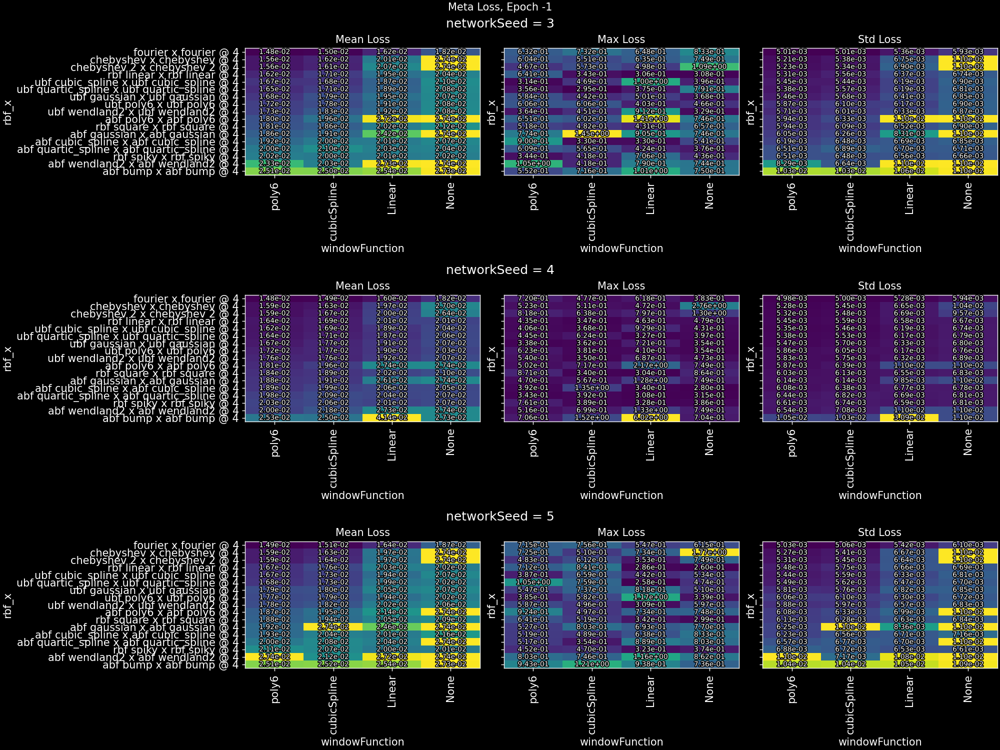

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm


# which_y = 'arch'
# which_x = 'n'
# which_z = 'frameDistance'

# xvars = []
# yvars = []
# zvars = []
# for s in subfolders:
#     xv = dataDict[s]['hyperParameters'][which_x]
#     if xv not in xvars:
#         xvars.append(xv)
#     yv = dataDict[s]['hyperParameters'][which_y]
#     if yv not in yvars:
#         yvars.append(yv)
#     zv = dataDict[s]['hyperParameters'][which_z]
#     if zv not in zvars:
#         zvars.append(zv)
# debugPrint(xvars)
# debugPrint(yvars)
# debugPrint(zvars)
# xvars.sort()
# yvars.sort()
# zvars.sort()

import matplotlib.patheffects as path_effects
txtLabels = []
def plotToAxis(axis, mat, bounds = None, label = None):
    if label is not None:
        axis.set_title(label)
    if bounds is None:
        im = axis.imshow(mat, vmin=mat[np.logical_not(np.isnan(mat))].min(), vmax=mat[np.logical_not(np.isnan(mat))].max(), aspect='auto')
    else:
        im = axis.imshow(mat, norm=colors.LogNorm(vmin=bounds[0], vmax=bounds[1]), aspect='auto')
#         im = axis.imshow(mat, vmin=bounds[0], vmax=bounds[1])
    for (j,i),label in np.ndenumerate(mat):
        if not np.isnan(label):
            st = '%1.2e' % label
            txtLabels.append(axis.text(i,j,st,ha='center',va='center', color = 'white', fontsize=8, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])

    axis.set_yticks(np.arange(len(xvars)))
    axis.set_yticklabels(xvars, minor = False, rotation =0, fontsize = 12)
    axis.set_ylabel('%s' % which_x, fontsize = 12)
    axis.set_xlabel('%s' % which_y, fontsize = 12)
    axis.set_xticks(np.arange(len(yvars)))
    axis.set_xticklabels(yvars, minor = False, rotation =90, fontsize = 12)
    
    return im

def plot_funcMeta(epoch, shareCmap = True):
    global txtLabels
    for lbl in txtLabels:
        lbl.remove()
        
    fig.suptitle('Meta Loss, Epoch %d' % (epoch))
    for i in range(len(zvars)):
        for j, a in enumerate(axs[i][0,:]):
            a.cla()
#             a.set_title('%s = %s' %(which_y, yvars[j]))
#         axs[i][0,0].set_title('Mean Loss')
#         axs[i][0,1].set_title('Max Loss')
#         axs[i][0,2.set_title('Stddev Loss')
    meanDict = {}
    maxDict = {}
    stdDict = {}
    for i in range(len(zvars)):
        meanDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
        maxDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
        stdDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
    
    for s in subfolders:
        xs = dataDict[s]['hyperParameters'][which_x]        
        ys = dataDict[s]['hyperParameters'][which_y]
        zs = dataDict[s]['hyperParameters'][which_z]
#         xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
        xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
#         print('xs:', xs, 'ys:', ys, 'zs:', zs)
        meanDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,0])
        maxDict[zs][xvars.index(xs), yvars.index(ys)] = np.max(losses[s][epoch,:,1])
        stdDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,3])
    
    minMaxMean = np.array([1e10,-1e10])
    minMaxMax = np.array([1e10,-1e10])
    minMaxStd = np.array([1e10,-1e10])
    for i in range(len(zvars)):
        minMaxMean[0] = min(minMaxMean[0], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
        minMaxMean[1] = max(minMaxMean[1], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
        minMaxMax[0] = min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
        minMaxMax[1] = max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
        minMaxStd[0] = min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
        minMaxStd[1] = max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxMax  = (min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])), max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])))
#         minMaxStd  = (min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])),max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
        
#     print(minMaxMean)
#     print(minMaxMax)
#     print(minMaxStd)
    if shareCmap:
        for i in range(len(zvars)):
            means = meanDict[zvars[i]]
    #         print(means, means.shape)
            plotToAxis(axs[i][0,0], meanDict[zvars[i]], label = 'Mean Loss', bounds = minMaxMean)
            plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss', bounds = minMaxMax)
            plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss', bounds = minMaxStd)
    else:        
        for i in range(len(zvars)):
            means = meanDict[zvars[i]]
    #         print(means, means.shape)
            plotToAxis(axs[i][0,0], meanDict[zvars[i]], label = 'Mean Loss')
            plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss')
            plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss')
    fig.canvas.draw_idle()
    
fig = plt.figure(layout='constrained', figsize=(4 * 4, 4 * len(zvars)))
fig.suptitle('Mean Loss, Epoch %d' % -1)
subfigs = fig.subfigures(len(zvars), 1, wspace=0.07, squeeze = False)

epoch = -1

axs = []
for i in range(len(zvars)):
    subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
    lax = subfigs[i,0].subplots(1, 3, sharey=True, squeeze = False)
    axs.append(lax)    
    
plot_funcMeta(-1, shareCmap = False)
    
    

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm


# which_y = 'arch'
# which_x = 'n'
# which_z = 'frameDistance'

# xvars = []
# yvars = []
# zvars = []
# for s in subfolders:
#     xv = dataDict[s]['hyperParameters'][which_x]
#     if xv not in xvars:
#         xvars.append(xv)
#     yv = dataDict[s]['hyperParameters'][which_y]
#     if yv not in yvars:
#         yvars.append(yv)
#     zv = dataDict[s]['hyperParameters'][which_z]
#     if zv not in zvars:
#         zvars.append(zv)
# debugPrint(xvars)
# debugPrint(yvars)
# debugPrint(zvars)
# xvars.sort()
# yvars.sort()
# zvars.sort()

import matplotlib.patheffects as path_effects
txtLabels = []


<IPython.core.display.Javascript object>


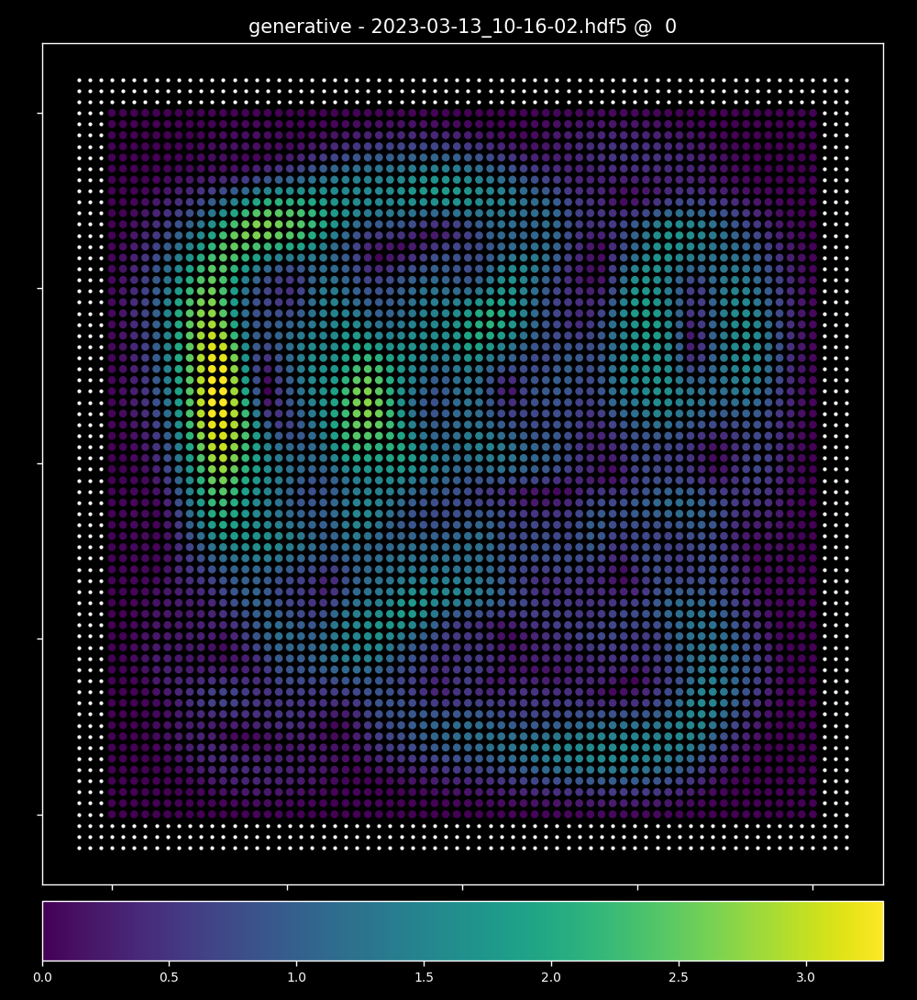

/home/winchenbach/anaconda3/envs/torch_env/lib/python3.9/site-packages/ipykernel/pylab/backend_inline.py:11: DeprecationWarning: `ipykernel.pylab.backend_inline` is deprecated, directly use `matplotlib_inline.backend_inline`
  warnings.warn(


interactive(children=(Dropdown(description='file', options=('/mnt/data/datasets/generative2D/train/generative …

<function __main__.plotNetwork(file, frame)>

In [18]:

fig, axis = plt.subplots(1, 1, figsize=(8,8*1.09), sharex = False, sharey = False, squeeze = False)

attributes, inputData, groundTruthData = loadFrame(simulationFiles[0], 0, 1 + np.arange(1), 1)


x = inputData['fluidPosition'][:,0].detach().cpu().numpy()
y = inputData['fluidPosition'][:,1].detach().cpu().numpy()

# v = (gt[:,-1:] - modelOutput) ** 2
v = torch.linalg.norm(inputData['fluidVelocity'],dim=1)

axis[0,0].set_title('Velocity')
# sc = axis[1,0].scatter(x,y,c = v,s=0.25)
GTsc = axis[0,0].scatter(x,y,c = v.detach().cpu().numpy(), s= 16)
axis[0,0].axis('equal')
axis[0,0].set_xlim(-1.2,1.2)
axis[0,0].set_ylim(-1.2,1.2)
# axis[0,1].axvline(-2)
# axis[0,1].axvline(2)
# axis[0,1].axhline(-2)
# axis[0,1].axhline(2)
axis[0,0].scatter(inputData['boundaryPosition'][:,0], inputData['boundaryPosition'][:,1], c = 'white', s =2 )
axis[0,0].set_xticklabels([])
axis[0,0].set_yticklabels([])
ax1_divider = make_axes_locatable(axis[0,0])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
GTcbar = fig.colorbar(GTsc, cax=cax1,orientation='horizontal')
GTcbar.ax.tick_params(labelsize=8) 
fig.tight_layout()


def plotNetwork(file, frame):
    attributes, inputData, groundTruthData = loadFrame(file, frame, 1 + np.arange(1), 1)

    data = inputData['fluidDensity'].detach().cpu().numpy()
    positions = inputData['fluidPosition'].detach().cpu().numpy()
    
    data = torch.linalg.norm(inputData['fluidVelocity'],dim=1).detach().cpu().numpy()
#     debugPrint(data.shape)
    positions = inputData['fluidPosition'].detach().cpu().numpy()
    GTsc.set_offsets(positions)
    GTsc.set_array(data)
    GTcbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))

    axis[0,0].set_title('%s @ %2d' % (file.split('/')[-1], frame))
    fig.canvas.draw()
    fig.canvas.flush_events()



# plotNetwork(simulationFiles[0], 0, subfolders[0], epochs - 1)

interact(plotNetwork, file = simulationFiles, frame = widgets.IntSlider(value=0, min=0, max=2000 -1, step=1))



In [19]:

from rbfConv import *
from datautils import *
from rbfNet import *

In [20]:


def loadRbfModel(file, frame, networkPath, epoch):
    with open(os.path.expanduser("%s/results.json" % networkPath), "r") as read_file:
        decodedArray = json.load(read_file)
        dataDict = decodedArray
    
    n = dataDict['hyperParameters']['n']
    m = dataDict['hyperParameters']['m']
    coordinateMapping = dataDict['hyperParameters']['coordinateMapping']
    windowFn = getWindowFunction(dataDict['hyperParameters']['windowFunction'])
    rbf_x = dataDict['hyperParameters']['rbf_x']
    rbf_y = dataDict['hyperParameters']['rbf_y']
    dist = dataDict['hyperParameters']['frameDistance']
    unroll = dataDict['hyperParameters']['maxRollOut']
    arch = [32, 64, 64, 2]
    arch = [16, 32, 32, 2]
    arch = dataDict['hyperParameters']['arch']
    arch = [int(a) for a in arch.split(' ') if a != '']
    epochs = dataDict['hyperParameters']['epochs']
#     print(arch)
#     print(n, m)
#     print(dataDict['hyperParameters']['windowFunction'])
#     print(rbf_x)
#     print(rbf_y)

    attributes, inputData, groundTruthData = loadFrame(file, frame, 1 + np.arange(unroll), dist)
    inputData['fluidGravity'] = inputData['fluidGravity'][:,:2]
    
    
    fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
#     print(fluidFeatures.shape)
#     print(boundaryFeatures.shape)
    if 'network' not in dataDict['hyperParameters']:
        model = RbfNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, )
    else:
        network = dataDict['hyperParameters']['network']
        model = None
        if network == 'default':
            model = RbfNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, normalized = False )
        if network == 'denormalized':
            model = RbfNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, normalized = False)
        if network == 'split':
            model = RbfSplitNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, )
        if network == 'interleaved':
            model = RbfInterleaveNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, )
        if network == 'input':
            model = RbfInputNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, )
        if network == 'output':
            model = RbfOutputNet(fluidFeatures.shape[1],boundaryFeatures.shape[1], layers = arch, coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32, )


    model.load_state_dict(torch.load(os.path.expanduser('%s/model_%03d.torch' % (networkPath, epoch if epoch >= 0 else epochs - 1))))
    model = model.to(device)
    model.train(False)
    return model, dataDict['hyperParameters']

In [21]:
# [print(i, s) for i,s in zip(np.arange(len(subfolders)),subfolders)];

In [22]:
from tqdm.notebook import tqdm

In [23]:

@torch.jit.script
def wendland(q, h):
    C = 7 / np.pi
    b1 = torch.pow(1. - q, 4)
    b2 = 1.0 + 4.0 * q
    return b1 * b2 * C / h**2    
@torch.jit.script
def wendlandGrad(q,r,h):
    C = 7 / np.pi    
    return - r * C / h**3 * (20. * q * (1. -q)**3)[:,None]
    

In [24]:
def getParticleQuantities(positions, bPositions, area, boundaryArea, attributes):
    # bPositions = boundaryPositions.to(device)
    # area = inputData['fluidArea'].to(device)
    # boundaryArea = inputData['boundaryArea'].to(device)

    fi, fj = radius(positions, positions, attributes['support'], max_num_neighbors = 256, batch_x = None, batch_y = None)
    bf, bb = radius(bPositions, positions, attributes['support'], max_num_neighbors = 256, batch_x = None, batch_y = None)
    bi, bj = radius(bPositions, bPositions, attributes['support'], max_num_neighbors = 256, batch_x = None, batch_y = None)

    i, ni = torch.unique(fi, return_counts = True)
    b, nb = torch.unique(bf, return_counts = True)

    fluidNeighbors = torch.stack([fi, fj], dim = 0)
    fluidDistances = (positions[fi] - positions[fj])
    fluidRadialDistances = torch.linalg.norm(fluidDistances,axis=1)
    fluidDistances[fluidRadialDistances < 1e-5,:] = 0
    fluidDistances[fluidRadialDistances >= 1e-5,:] /= fluidRadialDistances[fluidRadialDistances >= 1e-5,None]
    fluidRadialDistances /= attributes['support']

    boundaryNeighbors = torch.stack([bf, bb], dim = 0)
    boundaryDistances = (positions[bf] - bPositions[bb])
    boundaryRadialDistances = torch.linalg.norm(boundaryDistances,axis=1)
    boundaryDistances[boundaryRadialDistances < 1e-5,:] = 0
    boundaryDistances[boundaryRadialDistances >= 1e-5,:] /= boundaryRadialDistances[boundaryRadialDistances >= 1e-5,None]
    boundaryRadialDistances /= attributes['support']

    boundaryBoundaryNeighbors = torch.stack([bi, bj], dim = 0)
    boundaryBoundaryDistances = (bPositions[bi] - bPositions[bj])
    boundaryBoundaryRadialDistances = torch.linalg.norm(boundaryBoundaryDistances,axis=1)
    boundaryBoundaryDistances[boundaryBoundaryRadialDistances < 1e-5,:] = 0
    boundaryBoundaryDistances[boundaryBoundaryRadialDistances >= 1e-5,:] /= boundaryBoundaryRadialDistances[boundaryBoundaryRadialDistances >= 1e-5,None]
    boundaryBoundaryRadialDistances /= attributes['support']
    density = scatter(area[fj] * wendland(fluidRadialDistances, attributes['support']), fi, dim=0, dim_size = positions.shape[0], reduce='add') + \
        scatter(boundaryArea[bb] * wendland(boundaryRadialDistances, attributes['support']), bf, dim=0, dim_size = positions.shape[0], reduce='add')
#     densityLoss = (density - groundTruths[0][:,4].to(device))**2

    boundaryDensity = scatter(area[bf] * wendland(boundaryRadialDistances, attributes['support']), bb, dim=0, dim_size = bPositions.shape[0], reduce='add') + \
            scatter(boundaryArea[bj] * wendland(boundaryBoundaryRadialDistances, attributes['support']), bi, dim=0, dim_size = bPositions.shape[0], reduce='add')
    # print(boundaryDensity)
    colorField = scatter(area[fj]/density[fj] * wendland(fluidRadialDistances, attributes['support']), fi, dim=0, dim_size = positions.shape[0], reduce='add') + \
        scatter(boundaryArea[bb]/boundaryDensity[bb] * wendland(boundaryRadialDistances, attributes['support']), bf, dim=0, dim_size = positions.shape[0], reduce='add')
    boundaryColorField = scatter(area[bf]/density[bf] * wendland(boundaryRadialDistances, attributes['support']), bb, dim=0, dim_size = bPositions.shape[0], reduce='add') + \
        scatter(boundaryArea[bi]/boundaryDensity[bi] * wendland(boundaryBoundaryRadialDistances, attributes['support']), bj, dim=0, dim_size = bPositions.shape[0], reduce='add')

    fluidGrad = wendlandGrad(fluidRadialDistances, fluidDistances, attributes['support'])
    boundaryGrad = wendlandGrad(boundaryRadialDistances, boundaryDistances, attributes['support'])
    colorGrad = scatter((area[fj]/density[fj] * (colorField[fj] - colorField[fi]))[:,None] * fluidGrad, fi, dim=0, dim_size = positions.shape[0], reduce='add') + \
            scatter((boundaryArea[bb]/boundaryDensity[bb] * (boundaryColorField[bb] - colorField[bf]))[:,None] * boundaryGrad, bf, dim=0, dim_size = positions.shape[0], reduce='add')

    return density, colorField, colorGrad

In [25]:
def scatterPlot(ax, positions, data, boundaryPositions, title = None):
    ax.axis('equal')
    im = ax.scatter(positions[:,0].detach().cpu().numpy(), positions[:,1].detach().cpu().numpy(), c = data.detach().cpu().numpy(), s = 2)    
    ax.scatter(boundaryPositions[:,0].detach().cpu().numpy(), boundaryPositions[:,1].detach().cpu().numpy(), s=2,c='white',alpha=0.5)
    ax.set_xlim(-1.2,1.2)
    ax.set_ylim(-1.2,1.2)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
    GTcbar = fig.colorbar(im, cax=cax1,orientation='horizontal')
    GTcbar.ax.tick_params(labelsize=8) 
    if title is not None:
        ax.set_title(title)
    return im, GTcbar

In [26]:
def getMeshQuantities(xFluid, bPositions, area, boundaryArea, density, velocity, attributes, n = 512, supportScale = 1):
    x = torch.linspace(-1,1,n, device = xFluid.device, dtype = xFluid.dtype)
    y = torch.linspace(-1,1,n, device = xFluid.device, dtype = xFluid.dtype)
    xx,yy = torch.meshgrid(x,y, indexing='xy')

    xxf = xx.flatten()
    yyf = yy.flatten()
    positions = torch.vstack((xxf, yyf)).mT
    z = yyf
    # z = torch.linalg.norm(positions,dim=1).reshape(xx.shape)
#     bPositions = boundaryPositions.to(device)
#     area = inputData['fluidArea'].to(device)
#     boundaryArea = inputData['boundaryArea'].to(device)

    xm, xf = radius(xFluid, positions, attributes['support'] * supportScale, max_num_neighbors = 256, batch_x = None, batch_y = None)


    # fluidNeighbors = torch.stack([xf, xm], dim = 0)
    fluidDistances = (positions[xm] - xFluid[xf])
    fluidRadialDistances = torch.linalg.norm(fluidDistances,axis=1)
    fluidDistances[fluidRadialDistances < 1e-5,:] = 0
    fluidDistances[fluidRadialDistances >= 1e-5,:] /= fluidRadialDistances[fluidRadialDistances >= 1e-5,None]
    fluidRadialDistances /= attributes['support'] * supportScale


    bm, bb = radius(bPositions, positions, attributes['support'] * supportScale, max_num_neighbors = 256, batch_x = None, batch_y = None)


    # fluidNeighbors = torch.stack([xf, xm], dim = 0)
    boundaryDistances = (positions[bm] - bPositions[bb])
    boundaryRadialDistances = torch.linalg.norm(boundaryDistances,axis=1)
    boundaryDistances[boundaryRadialDistances < 1e-5,:] = 0
    boundaryDistances[boundaryRadialDistances >= 1e-5,:] /= boundaryRadialDistances[boundaryRadialDistances >= 1e-5,None]
    boundaryRadialDistances /= attributes['support'] * supportScale
    
    meshDensity = scatter(area[xf] * wendland(fluidRadialDistances, attributes['support'] * supportScale), xm, dim=0, dim_size = positions.shape[0], reduce = 'add') + \
    scatter(boundaryArea[bb] * wendland(boundaryRadialDistances, attributes['support'] * supportScale), bm, dim=0, dim_size = positions.shape[0], reduce = 'add')
    
    meshVelocity = scatter((area[xf] / density[xf] * wendland(fluidRadialDistances, attributes['support'] * supportScale))[:,None] * velocity[xf], xm, dim=0, dim_size = positions.shape[0], reduce = 'add')

    meshDivergence = scatter(area[xf] / density[xf] * torch.einsum('nd, nd -> n', (wendlandGrad(fluidRadialDistances, fluidDistances, attributes['support'] * supportScale)), velocity[xf] - meshVelocity[xm]), xm, dim=0, dim_size = positions.shape[0], reduce = 'add')
    
    return positions.reshape((xx.shape[0],xx.shape[1],g2)), meshDensity.reshape((xx.shape[0],xx.shape[1])), meshVelocity.reshape((xx.shape[0],xx.shape[1],2)), meshDivergence.reshape((xx.shape[0],xx.shape[1]))

def plotMeshData(fp, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence):
    fig, axis = plt.subplots(3, 5, figsize=(16,12), sharex = False, sharey = False, squeeze = False)
    meshPlot(axis[0,0], fp, meshDensity, 'Pred Density')
    meshPlot(axis[0,1], fp, meshVelocity[:,:,0], 'Pred Velocity.x')
    meshPlot(axis[0,2], fp, meshVelocity[:,:,1], 'Pred Velocity.y')
    meshPlot(axis[0,3], fp, torch.linalg.norm(meshVelocity, dim=2), '|Pred Velocity|')
    meshPlot(axis[0,4], fp, meshDivergence, 'Pred Divergence')

    meshPlot(axis[1,0], fp, gtMeshDensity, 'GT Density')
    meshPlot(axis[1,1], fp, gtMeshVelocity[:,:,0], 'GT Velocity.x')
    meshPlot(axis[1,2], fp, gtMeshVelocity[:,:,1], 'GT Velocity.y')
    meshPlot(axis[1,3], fp, torch.linalg.norm(gtMeshVelocity, dim=2), '|GT Velocity|')
    meshPlot(axis[1,4], fp, gtMeshDivergence, 'GT Divergence')

    meshPlot(axis[2,0], fp, meshDensity - gtMeshDensity, 'Diff Density')
    meshPlot(axis[2,1], fp, meshVelocity[:,:,0] - gtMeshVelocity[:,:,0], 'Diff Velocity.x')
    meshPlot(axis[2,2], fp, meshVelocity[:,:,1] - gtMeshVelocity[:,:,1], 'Diff Velocity.y')
    meshPlot(axis[2,3], fp, torch.linalg.norm(meshVelocity - gtMeshVelocity, dim=2), '|Diff Velocity|')
    meshPlot(axis[2,4], fp, meshDivergence - gtMeshDivergence, 'Diff Divergence')

    fig.tight_layout()
    

def meshPlot(ax, positions, data, title = None):
    ax.axis('equal')
#     print(positions[:,:,0].flatten().shape)
#     print(data.shape)
    im = ax.pcolormesh(positions[:,:,0].detach().cpu().numpy(), positions[:,:,1].detach().cpu().numpy(), data.detach().cpu().numpy())    
#     ax.scatter(boundaryPositions[:,0], boundaryPositions[:,1], s=1,c='white',alpha=0.5)
    ax.set_xlim(-1.,1.)
    ax.set_ylim(-1.,1.)
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
    GTcbar = fig.colorbar(im, cax=cax1,orientation='horizontal')
    GTcbar.ax.tick_params(labelsize=8) 
    if title is not None:
        ax.set_title(title)
    return im, GTcbar

In [27]:
def analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes):    
    positionLoss = torch.linalg.norm(positions - gtPositions.to(device), dim=1)
    velocityLoss = torch.linalg.norm(velocities - gtVelocities.to(device), dim=1)
    density, colorField, colorGrad = getParticleQuantities(positions, boundaryPositions, fluidArea, boundaryArea, attributes)
    
    gTPositionLoss = torch.linalg.norm(gtPositions - gtPositions, dim=1)
    gtVelocityLoss = torch.linalg.norm(gtVelocities - gtVelocities, dim=1)
    gtDensity2, gtColorField, gtColorGrad = getParticleQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, attributes)
    
    return positionLoss, velocityLoss, density, gtDensity2, colorField, gtColorField, colorGrad, gtColorGrad
    

In [28]:
def particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = True):
    positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes)
    if plot:
        fig, axis = plt.subplots(3, 6, figsize=(12,8*1.09), sharex = False, sharey = False, squeeze = False)

        scatterPlot(axis[0,0], positions, positionLoss, boundaryPositions, 'Position Loss')
        scatterPlot(axis[0,1], positions, velocityLoss, boundaryPositions, 'Velocity Loss')
        scatterPlot(axis[0,2], positions, density, boundaryPositions, 'Density')
        scatterPlot(axis[0,3], positions, colorField, boundaryPositions, 'Color')
        scatterPlot(axis[0,4], positions, colorGrad[:,0], boundaryPositions, 'Grad.x Color')
        scatterPlot(axis[0,5], positions, colorGrad[:,1], boundaryPositions, 'Grad.y Color')

        scatterPlot(axis[1,0], gtPositions, torch.zeros_like(density), boundaryPositions, 'GT Position Loss')
        scatterPlot(axis[1,1], gtPositions, torch.zeros_like(density), boundaryPositions, 'GT Velocity Loss')
        scatterPlot(axis[1,2], gtPositions, gtDensity, boundaryPositions, 'GT Density')
        scatterPlot(axis[1,3], gtPositions, gtColorField, boundaryPositions, 'GT Color')
        scatterPlot(axis[1,4], gtPositions, gtColorGrad[:,0], boundaryPositions, 'GT Grad.x Color')
        scatterPlot(axis[1,5], gtPositions, gtColorGrad[:,1], boundaryPositions, 'GT Grad.y Color')

        scatterPlot(axis[2,0], gtPositions, positionLoss, boundaryPositions, 'Position Loss')
        scatterPlot(axis[2,1], gtPositions, velocityLoss, boundaryPositions, 'Velocity Loss')
        scatterPlot(axis[2,2], gtPositions, density - gtDensity, boundaryPositions, 'Diff Density')
        scatterPlot(axis[2,3], gtPositions, colorField - gtColorField, boundaryPositions, 'Diff Color')
        scatterPlot(axis[2,4], gtPositions, colorGrad[:,0] - gtColorGrad[:,0], boundaryPositions, 'Diff Grad.x Color')
        scatterPlot(axis[2,5], gtPositions, colorGrad[:,1] - gtColorGrad[:,1], boundaryPositions, 'Diff Grad.y Color')

        fig.tight_layout()
    return positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad

In [29]:
import scipy.stats as stats

def getPSD(data):
    image = data.detach().cpu().numpy()
    npix = image.shape[0]
    fourier_image = np.fft.fftn(image)
    fourier_amplitudes = np.abs(fourier_image)**2
    kfreq = np.fft.fftfreq(npix) * npix

    kfreq2D = np.meshgrid(kfreq, kfreq)
    knrm = np.sqrt(kfreq2D[0]**2 + kfreq2D[1]**2)
    knrm = knrm.flatten()
    fourier_amplitudes = fourier_amplitudes.flatten()
    kbins = np.arange(0.01, npix//(2*np.pi)+1, 0.5)
    kbins = np.arange(0.5, npix//2+1, 1.)

    kvals = 0.5 * (kbins[1:] + kbins[:-1])

    Abins, _, _ = stats.binned_statistic(knrm, fourier_amplitudes,
                                         statistic = "mean",
                                         bins = kbins)

    Abins *= np.pi * (kbins[1:]**2 - kbins[:-1]**2)
    return kvals, Abins

def analyzeMesh(data, filterLevels = 0):
# data = torch.linalg.norm(meshVelocity,dim=1).reshape(xx.shape)
    if filterLevels > 0 :
        filtered = scipy.ndimage.gaussian_filter(data.detach().cpu().numpy(),filterLevels)
        filtered = torch.tensor(filtered, device = data.device, dtype = data.dtype)
    else:
        filtered = data
    # data = torch.linalg.norm(meshVelocity,dim=1)
    fft = torch.fft.fftshift(torch.fft.fft2(filtered))
    # fft = torch.fft.fft2(torch.linalg.norm(meshVelocity,dim=1).reshape(xx.shape))
    fftfreq = torch.fft.fftshift(torch.fft.fftfreq(filtered.shape[0],2 / filtered.shape[0]))
    # fftfreq = (torch.fft.fftfreq(xx.shape[0],2 / xx.shape[0]))
    fx, ft = torch.meshgrid(fftfreq, fftfreq, indexing = 'xy')
    # print(fx.shape)
    # print(ft.shape)
    fp = torch.vstack((fx.flatten(),ft.flatten())).mT

    return fp, fft, getPSD(filtered), filtered

In [30]:
def meshAnalysis(positions, data, gtData,plot = True, linThresh = 1e-2, linScale = 1):
    fp, fft, psd, filtered = analyzeMesh(data)
    fp, gtFft, gtPsd, gtFiltered = analyzeMesh(gtData)
    if plot:
        fig, axis = plt.subplots(3, 4, figsize=(16,11*1.09), sharex = False, sharey = False, squeeze = False)
        meshPlot(axis[0,0], positions, data, 'Original Prediction')
        meshPlot(axis[0,1], positions, filtered, 'Filtered Prediction')
        ax = axis[0,2]
        ax.axis('equal')
        ax.set_title('FFT Prediction')
        im = ax.pcolormesh(fp[:,0].reshape(data.shape).detach().cpu().numpy(), fp[:,1].reshape(data.shape).detach().cpu().numpy(), torch.real(fft).reshape(data.shape).detach().cpu().numpy(),
                          norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))), base=10), cmap = 'twilight')    
        ax.set_xscale('symlog', linthresh=linThresh, linscale = linScale, subs = [1, 2, 3, 4, 5, 6, 7, 8, 9])  
        ax.set_yscale('symlog', linthresh=linThresh, linscale = linScale, subs = [1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax1_divider = make_axes_locatable(ax)
        cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
        GTcbar = fig.colorbar(im, cax=cax1,orientation='horizontal')
        GTcbar.ax.tick_params(labelsize=8) 
        kvals,Abins = psd
        axis[0,3].set_title('PSD Prediction')
        axis[0,3].loglog(kvals, Abins)
        axis[0,3].set_xlabel("$k$")
        axis[0,3].set_ylabel("$P(k)$")
        # axis[0,0].legend()

        meshPlot(axis[1,0], positions, gtData, 'Original Groundtruth')
        meshPlot(axis[1,1], positions, gtFiltered, 'Filtered Groundtruth')
        ax = axis[1,2]
        ax.axis('equal')
        ax.set_title('FFT Groundtruth')
        im = ax.pcolormesh(fp[:,0].reshape(data.shape).detach().cpu().numpy(), fp[:,1].reshape(data.shape).detach().cpu().numpy(), torch.real(gtFft).reshape(data.shape).detach().cpu().numpy(),
                          norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(torch.real(gtFft))), vmax=torch.max(torch.abs(torch.real(gtFft))), base=10), cmap = 'twilight')     
        ax.set_xscale('symlog', linthresh=linThresh, linscale = linScale, subs = [1, 2, 3, 4, 5, 6, 7, 8, 9])  
        ax.set_yscale('symlog', linthresh=linThresh, linscale = linScale, subs = [1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax1_divider = make_axes_locatable(ax)
        cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
        GTcbar = fig.colorbar(im, cax=cax1,orientation='horizontal')
        GTcbar.ax.tick_params(labelsize=8) 
        kvals,Abins = gtPsd
        axis[1,3].set_title('PSD Groundtruth')
        axis[1,3].loglog(kvals, Abins)
        axis[1,3].set_xlabel("$k$")
        axis[1,3].set_ylabel("$P(k)$")

        meshPlot(axis[2,0], positions, data - gtData, 'Original Difference')
        meshPlot(axis[2,1], positions, filtered - gtFiltered, 'Filtered Difference')
        ax = axis[2,2]
        ax.axis('equal')
        ax.set_title('FFT Difference')
        diff = (torch.real(fft) - torch.real(gtFft))
        im = ax.pcolormesh(fp[:,0].reshape(data.shape).detach().cpu().numpy(), fp[:,1].reshape(data.shape).detach().cpu().numpy(), diff.reshape(data.shape).detach().cpu().numpy(),
                          norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(diff)), vmax=torch.max(torch.abs(diff)), base=10), cmap = 'twilight')     
        ax.set_xscale('symlog', linthresh=linThresh, linscale = linScale, subs = [1, 2, 3, 4, 5, 6, 7, 8, 9])  
        ax.set_yscale('symlog', linthresh=linThresh, linscale = linScale, subs = [1, 2, 3, 4, 5, 6, 7, 8, 9])
        ax1_divider = make_axes_locatable(ax)
        cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
        GTcbar = fig.colorbar(im, cax=cax1,orientation='horizontal')
        GTcbar.ax.tick_params(labelsize=8) 
        kvals,Abins = gtPsd
        axis[2,3].set_title('PSD')
        axis[2,3].loglog(kvals, Abins,label = 'GT')
        kvals,Abins = psd
        axis[2,3].loglog(kvals, Abins,label = 'pred')
        axis[2,3].set_xlabel("$k$")
        axis[2,3].set_ylabel("$P(k)$")
        axis[2,3].legend()

        fig.tight_layout()
    
    return fp, fft, gtFft, psd, gtPsd

In [31]:
networkIndex = 0
simulationIndex = 0
initialFrame = 1024
unrollSteps = 32
epoch = -1
# generative2D - n=[ 2, 2] rbf=[linear,linear] map = preserving window = poly6 d = 32 e = 10 arch 32 64 64 3 distance = 32 - 2023-03-14_19-24-27
model, hyperParams = loadRbfModel(simulationFiles[simulationIndex], 0, subfolders[networkIndex], epoch)
# model, hyperParams = loadRbfModel(simulationFiles[0], 0, '/home/winchenbach/trainingdata_2D_deltaSPH_001/generative2D - n=[ 4, 4] rbf=[linear,linear] map = preserving window = poly6 d = 32 e = 10 arch 32 64 64 3 distance = 32 - 2023-03-14_20-28-56', -1)

attributes, inputData, groundTruths = loadFrame(simulationFiles[simulationIndex], initialFrame, 1 + np.arange(unrollSteps), hyperParams['frameDistance'])
# attributes['support'] = 0.01 /4 * 4.5 
fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)

fluidFeatures = fluidFeatures.to(device)

model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[0], -1)

predictedPositions = fluidPositions.to(device)
predictedVelocity = inputData['fluidVelocity'].to(device)

gravity = inputData['fluidGravity'][:,:2].to(device) #torch.zeros_like(predictedVelocity)

with torch.no_grad():
    for unrollStep in tqdm(range(unrollSteps)):
        loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[0], model, None, None, True)
    
positions = predictedPositions
velocities = predictedVelocity


gtPositions = groundTruths[unrollStep][:,:2].to(device)
gtVelocities = groundTruths[unrollStep][:,2:4].to(device)
gtDensity = groundTruths[unrollStep][:,4].to(device)

fluidArea = inputData['fluidArea'].to(device)

boundaryPositions = inputData['boundaryPosition'].to(device)
boundaryArea = inputData['boundaryArea'].to(device)



# positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes)
positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)

fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)

# plotMeshData(fp, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence)

data = torch.linalg.norm(meshVelocity,dim=2)
gtData = torch.linalg.norm(gtMeshVelocity,dim=2)

ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)

kvals,Abins = psd
kvals,gtAbins = gtPsd

  0%|          | 0/32 [00:00<?, ?it/s]

In [32]:
# outputFolder = '/mnt/data/processedDataset2'

In [33]:
# print(simulationFiles[simulationIndex])

In [34]:

# for ss in tqdm(simulationFiles):
# #     for s in tqdm(subfolders, leave = False):
# #         params = dataDict[s]['hyperParameters']
# #         base = '%s[%d] x %s[%d] @ %s - %s[%4d]' % (params['rbf_x'].split(' ')[-1], params['n'], params['rbf_y'].split(' ')[-1], params['m'], params['coordinateMapping'], params['network'] if 'network' in params else 'default', params['networkSeed']if 'networkSeed'in params else 0)
# #         model, hyperParams = loadRbfModel(simulationFiles[0], 0, s, -1)
# #     print(ss)

#     sim = ss.split('/')[-1].split('.')[0]
# #         print(sim)
#     print('Processing simulation %s' % sim)
#     outFolder = outputFolder + '/' + sim
#     if not os.path.exists(outFolder):
#         os.makedirs(outFolder)
        
# #     if os.path.exists(outFolder + '/gt.hdf5'):
# #         continue
#     exportPath = outFolder + '/gt.hdf5'
#     outFile = h5py.File(exportPath,'w')

#     for i in tqdm(range(0,3200), leave = False):
# #             print('Processing frame %4d' % (i * hyperParams['frameDistance']))
#         grp = outFile.create_group('%4d' %( i))

#         attributes, inputData, groundTruths = loadFrame(ss, i, np.arange(1), hyperParams['frameDistance'])
#         # attributes['support'] = 0.01 /4 * 4.5 
#         fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)

#         poitions = fluidPositions.to(device)

#         gtPositions = groundTruths[0][:,:2].to(device)
#         gtVelocities = groundTruths[0][:,2:4].to(device)
#         gtDensity = groundTruths[0][:,4].to(device)

#         fluidArea = inputData['fluidArea'].to(device)
#         fluidFeatures = fluidFeatures.to(device)

#         boundaryPositions = inputData['boundaryPosition'].to(device)
#         boundaryArea = inputData['boundaryArea'].to(device)

#         predictedPositions = fluidPositions.to(device)
#         predictedVelocity = inputData['fluidVelocity'].to(device)

#         unrollSteps = (3200 - i * hyperParams['frameDistance']) // hyperParams['frameDistance']
# #             unrollSteps = min(unrollSteps, 4)
# #         with torch.no_grad():
# #             for unrollStep in tqdm(range(unrollSteps), leave = False):
# #                 f = (i * hyperParams['frameDistance'] + unrollStep * hyperParams['frameDistance'])
# #         outGrp = grp.create_group('%4d' % f)
# #         print(f, grp['%4d' % f])

# #                 loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[0], model, None, None, True)
#         positions = predictedPositions
#         velocities = predictedVelocity

#         attributes, inputData, groundTruths = loadFrame(ss, i, np.arange(1), hyperParams['frameDistance'])
#         gtPositions = groundTruths[0][:,:2].to(device)
#         gtVelocities = groundTruths[0][:,2:4].to(device)
#         gtDensity = groundTruths[0][:,4].to(device)
# #             print('Done with unrolling')
# # positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes)
#         positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)
#         fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
#         state = {'particlePostions': positions.detach().cpu().numpy(), 'particleVelocity': velocities.detach().cpu().numpy(), 'particleDensity': density.detach().cpu().numpy(), 'particleColor': colorField.detach().cpu().numpy(), 'particleColorGrad':colorGrad.detach().cpu().numpy(), 
#                  'meshDensity': meshDensity.detach().cpu().numpy(), 'meshVelocity':meshVelocity.detach().cpu().numpy(), 'meshDivergence':meshDivergence.detach().cpu().numpy()}
# #                     print(torch.mean(positionLoss))
#         for k in state:
# #                         print('k')
#             grp.create_dataset(k, data = state[k])
# #                 if torch.mean(positionLoss) > 1:
# #                     break
# #             break

#     outFile.close()
#     break

# #     break

In [35]:
# outFile.close()

In [36]:
# print(exportPath)

In [37]:
# print(simulationFiles[0])

In [38]:
# print(subfolders[0])

In [39]:

# for ss in tqdm(simulationFiles):
#     for s in tqdm(subfolders, leave = False):
#         params = dataDict[s]['hyperParameters']
#         base = '%s[%d] x %s[%d] @ %s - %s[%4d]' % (params['rbf_x'].split(' ')[-1], params['n'], params['rbf_y'].split(' ')[-1], params['m'], params['coordinateMapping'], params['network'] if 'network' in params else 'default', params['networkSeed']if 'networkSeed'in params else 0)
#         model, hyperParams = loadRbfModel(simulationFiles[0], 0, s, -1)
# #         print(ss)
        
#         sim = ss.split('/')[-1].split('.')[0]
# #         print(sim)
# #         print('Processing simulation %s' % sim)
#         outFolder = outputFolder + '/' + sim
#         if not os.path.exists(outFolder):
#             os.makedirs(outFolder)
#         exportPath = outFolder + '/%s.hdf5' % base
#         outFile = h5py.File(exportPath,'w')
        
#         for i in tqdm(range(0,199,8), leave = False):
# #             print('Processing frame %4d' % (i * hyperParams['frameDistance']))
#             grp = outFile.create_group('%4d' %( i * hyperParams['frameDistance']))
            
#             attributes, inputData, groundTruths = loadFrame(ss, i * hyperParams['frameDistance'], np.arange(1), hyperParams['frameDistance'])
#             # attributes['support'] = 0.01 /4 * 4.5 
#             fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)

#             poitions = fluidPositions.to(device)

#             gtPositions = groundTruths[0][:,:2].to(device)
#             gtVelocities = groundTruths[0][:,2:4].to(device)
#             gtDensity = groundTruths[0][:,4].to(device)

#             fluidArea = inputData['fluidArea'].to(device)
#             fluidFeatures = fluidFeatures.to(device)

#             boundaryPositions = inputData['boundaryPosition'].to(device)
#             boundaryArea = inputData['boundaryArea'].to(device)

#             predictedPositions = fluidPositions.to(device)
#             predictedVelocity = inputData['fluidVelocity'].to(device)
            
#             unrollSteps = (3200 - i * hyperParams['frameDistance']) // hyperParams['frameDistance']
# #             unrollSteps = min(unrollSteps, 4)
#             with torch.no_grad():
#                 for unrollStep in tqdm(range(unrollSteps), leave = False):
#                     f = (i * hyperParams['frameDistance'] + unrollStep * hyperParams['frameDistance'])
#                     outGrp = grp.create_group('%4d' % f)
# #                     print(f, grp['%4d' % f])
                    
#                     loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[0], model, None, None, True)
#                     positions = predictedPositions
#                     velocities = predictedVelocity
                    
#                     attributes, inputData, groundTruths = loadFrame(ss, i * hyperParams['frameDistance'] + unrollStep * hyperParams['frameDistance'], np.arange(1), hyperParams['frameDistance'])
#                     gtPositions = groundTruths[0][:,:2].to(device)
#                     gtVelocities = groundTruths[0][:,2:4].to(device)
#                     gtDensity = groundTruths[0][:,4].to(device)
# #             print('Done with unrolling')
#             # positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes)
#                     positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)
#                     fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
#                     state = {'particlePostions': positions.detach().cpu().numpy(), 'particleVelocity': velocities.detach().cpu().numpy(), 'particleDensity': density.detach().cpu().numpy(), 'particleColor': colorField.detach().cpu().numpy(), 'particleColorGrad':colorGrad.detach().cpu().numpy(), 
#                              'meshDensity': meshDensity.detach().cpu().numpy(), 'meshVelocity':meshVelocity.detach().cpu().numpy(), 'meshDivergence':meshDivergence.detach().cpu().numpy()}
# #                     print(torch.mean(positionLoss))
#                     for k in state:
# #                         print('k')
#                         outGrp.create_dataset(k, data = state[k])
#                     if torch.mean(positionLoss) > 1:
#                         break
# #             break
            
#         outFile.close()
# #         break
    
#     break

In [40]:
# ss

In [41]:
# outFile.close()

In [42]:
# outFile['%4d' % 0]['%4d' % 0]['meshDensity']

In [43]:
# outFile['   0'].keys()

In [44]:
 warnings.filterwarnings("ignore", category=ResourceWarning)

In [45]:
# # trainFolder = '/mnt/c/Users/Rimuru/trainingData'
# trainFolder = '~/trainingdata_2D_deltaSPH_001'
# trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingData'
# # trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataSignalTestingv2'
# # trainFolder = '~/servus03/torchSPH2/Cconv/trainingData'
# # trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataSeedVariance'
# # trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataLongEpoch'
# trainFolder = os.path.expanduser(trainFolder)
# subfolders = [ f.path for f in os.scandir(trainFolder) if f.is_dir() ]
# # subfolders = [ f.path for f in os.scandir('./trainingDataBasisFunctions8x8') if f.is_dir() ]
# print(len(subfolders))

# subfolders = [s for s in subfolders if os.path.exists(s + '/results.json')]
# print(len(subfolders))

# dataDict = {}

# # subfolders = [subfolders[0]]
# for s in tqdm(subfolders):
#     with open("%s/results.json" % s, "r") as read_file:
#         decodedArray = json.load(read_file)
#         dataDict[s] = decodedArray
# #         print(decodedArray['hyperParameters'])   

In [46]:


# positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes)
positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)

fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)

# plotMeshData(fp, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence)

data = torch.linalg.norm(meshVelocity,dim=2)
gtData = torch.linalg.norm(gtMeshVelocity,dim=2)

ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)

kvals,Abins = psd
kvals,gtAbins = gtPsd

In [47]:
def updatePlot(fig, axis, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins):
    imPredDensity.set_array(meshDensity.detach().cpu().numpy())
    cbarPredDensity.mappable.set_clim(vmin=min(torch.min(gtMeshDensity), torch.min(meshDensity)), vmax=max(torch.max(gtMeshDensity), torch.max(meshDensity)))
    imGTDensity.set_array(gtMeshDensity.detach().cpu().numpy())
    cbarGTDensity.mappable.set_clim(vmin=min(torch.min(gtMeshDensity), torch.min(meshDensity)), vmax=max(torch.max(gtMeshDensity), torch.max(meshDensity)))

    pVel = torch.linalg.norm(meshVelocity, dim = -1)
    gVel = torch.linalg.norm(gtMeshVelocity, dim = -1)

    imPredVelocity.set_array(pVel.detach().cpu().numpy())
    cbarPredVelocity.mappable.set_clim(vmin=min(torch.min(gVel), torch.min(pVel)), vmax=max(torch.max(gVel), torch.max(pVel)))
    imGTVelocity.set_array(gVel.detach().cpu().numpy())
    cbarGTVelocity.mappable.set_clim(vmin=min(torch.min(gVel), torch.min(pVel)), vmax=max(torch.max(gVel), torch.max(pVel)))

    imPredDivergence.set_array(meshDivergence.detach().cpu().numpy())
    cbarPredDivergence.mappable.set_clim(vmin=min(torch.min(gtMeshDivergence), torch.min(meshDivergence)), vmax=max(torch.max(gtMeshDivergence), torch.max(meshDivergence)))
    imGTDivergence.set_array(gtMeshDivergence.detach().cpu().numpy())
    cbarGTDivergence.mappable.set_clim(vmin=min(torch.min(gtMeshDivergence), torch.min(meshDivergence)), vmax=max(torch.max(gtMeshDivergence), torch.max(meshDivergence)))

    imPredFFT.set_array(torch.real(fft).detach().cpu().numpy())
    cbarPredFFT.mappable.set_clim(vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))))

    axis[1,3].cla()
    axis[1,3].set_title('PSD')
    axis[1,3].loglog(kvals, Abins, label = 'Prediction')
    axis[1,3].loglog(kvals, gtAbins, label = 'Groundtruth')
    axis[1,3].set_xlabel("$k$")
    axis[1,3].set_ylabel("$P(k)$")
    axis[1,3].legend()

    fig.canvas.draw()
    fig.canvas.flush_events()
    
def updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, \
                gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor):
    
#     scDensity.set_offsets(positions.detach().cpu().numpy())
#     scDensity.set_array(density.detach().cpu().numpy())
#     cbarDensity.mappable.set_clim(vmin = torch.min(density), vmax = torch.max(density))
    
    imPredDensity.set_array(meshDensity.detach().cpu().numpy())
    cbarPredDensity.mappable.set_clim(vmin=torch.min(meshDensity), vmax = torch.max(meshDensity))
    
    sVel = torch.linalg.norm(velocities, dim = -1)
#     scVelocity.set_offsets(positions.detach().cpu().numpy())
#     scVelocity.set_array(sVel.detach().cpu().numpy())
#     cbarvelocity.mappable.set_clim(vmin = torch.min(sVel), vmax = torch.max(sVel))
    
    scDensity.set_array(gtMeshDensity.detach().cpu().numpy())
    cbarDensity.mappable.set_clim(vmin=min(torch.min(gtMeshDensity), torch.min(meshDensity)), vmax=max(torch.max(gtMeshDensity), torch.max(meshDensity)))

    pVel = torch.linalg.norm(meshVelocity, dim = -1)
    gVel = torch.linalg.norm(gtMeshVelocity, dim = -1)

    imPredVelocity.set_array(pVel.detach().cpu().numpy())
#     cbarPredVelocity.mappable.set_clim(vmin=min(torch.min(gVel), torch.min(pVel)), vmax=max(torch.max(gVel), torch.max(pVel)))
    cbarPredVelocity.mappable.set_clim(vmin=torch.min(pVel), vmax = torch.max(pVel))
    
    scVelocity.set_array(gVel.detach().cpu().numpy())
    cbarvelocity.mappable.set_clim(vmin=min(torch.min(gVel), torch.min(pVel)), vmax=max(torch.max(gVel), torch.max(pVel)))
    
    cGrad = torch.linalg.norm(colorGrad, dim = -1)
#     scColor.set_offsets(positions.detach().cpu().numpy())
#     scColor.set_array(cGrad.detach().cpu().numpy())
#     cbarColor.mappable.set_clim(vmin = torch.min(cGrad), vmax = torch.max(cGrad))
    

    imPredDivergence.set_array(meshDivergence.detach().cpu().numpy())
#     cbarPredDivergence.mappable.set_clim(vmin=min(torch.min(gtMeshDivergence), torch.min(meshDivergence)), vmax=max(torch.max(gtMeshDivergence), torch.max(meshDivergence)))
    cbarPredDivergence.mappable.set_clim(vmin=torch.min(meshDivergence), vmax = torch.max(meshDivergence))
    
    scColor.set_array(gtMeshDivergence.detach().cpu().numpy())
    cbarColor.mappable.set_clim(vmin=min(torch.min(gtMeshDivergence), torch.min(meshDivergence)), vmax=max(torch.max(gtMeshDivergence), torch.max(meshDivergence)))

    imPredFFT.set_array(torch.real(fft).detach().cpu().numpy())
    cbarPredFFT.mappable.set_clim(vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))))

    axis[1,3].cla()
    axis[1,3].set_title('PSD')
    axis[1,3].loglog(kvals, Abins, label = 'Prediction')
    axis[1,3].loglog(kvals, gtAbins, label = 'Groundtruth')
    axis[1,3].set_xlabel("$k$")
    axis[1,3].set_ylabel("$P(k)$")
    axis[1,3].legend()

    fig.canvas.draw()
    fig.canvas.flush_events()

In [48]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm


<IPython.core.display.Javascript object>


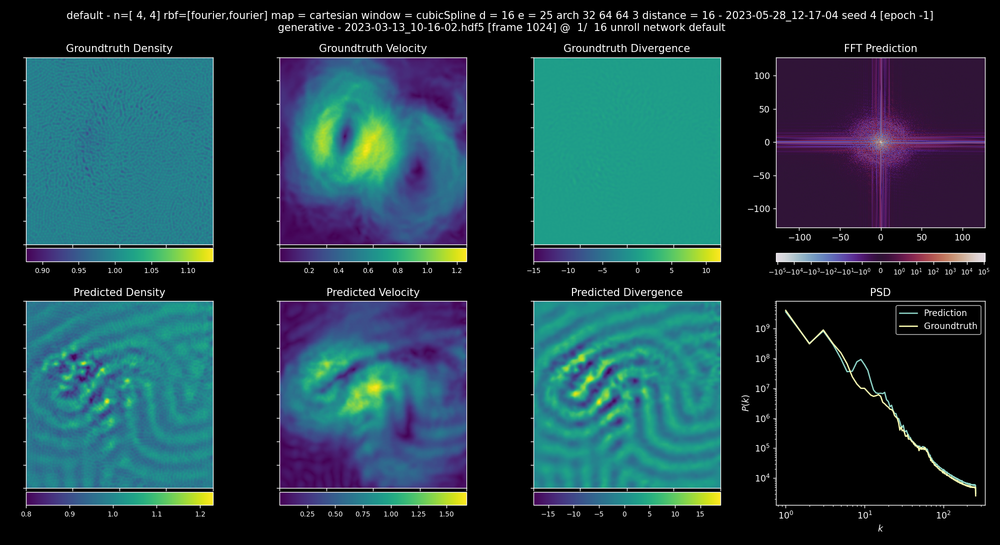

In [49]:
networkIndex = 0
simulationIndex = 0
initialFrame = 1024
unrollSteps = 64
epoch = -1
fig, axis = plt.subplots(2, 4, figsize=(16,8*1.09), sharex = False, sharey = False, squeeze = False)

fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, 0 + 1, (0+1) * hyperParams['frameDistance'], hyperParams['network'] if 'network' in hyperParams else 'default'))

# scDensity, cbarDensity = scatterPlot(axis[0,0], positions, density, boundaryPositions, 'Predicted Density')
# scVelocity, cbarvelocity = scatterPlot(axis[0,1], positions, torch.linalg.norm(velocities,dim=-1), boundaryPositions, 'Predicted Velocity')
# scColor, cbarColor = scatterPlot(axis[0,2], positions, torch.linalg.norm(colorGrad,dim=-1), boundaryPositions, 'Predicted |Grad Color|')

imPredDensity, cbarPredDensity = meshPlot(axis[1,0], fp, meshDensity, 'Predicted Density')
scDensity, cbarDensity = meshPlot(axis[0,0], fp, gtMeshDensity, 'Groundtruth Density')
imPredVelocity, cbarPredVelocity = meshPlot(axis[1,1], fp, torch.linalg.norm(meshVelocity, dim = -1), 'Predicted Velocity')
scVelocity, cbarvelocity = meshPlot(axis[0,1], fp, torch.linalg.norm(gtMeshVelocity, dim = -1), 'Groundtruth Velocity')
imPredDivergence, cbarPredDivergence = meshPlot(axis[1,2], fp, meshDivergence, 'Predicted Divergence')
scColor, cbarColor = meshPlot(axis[0,2], fp, gtMeshDivergence, 'Groundtruth Divergence')
ax = axis[0,3]
ax.set_title('FFT Prediction')
imPredFFT = ax.pcolormesh(ffp[:,0].reshape(data.shape).detach().cpu().numpy(), ffp[:,1].reshape(data.shape).detach().cpu().numpy(), torch.real(fft).detach().cpu().numpy(),
                  norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))), base=10), cmap = 'twilight')    
ax1_divider = make_axes_locatable(ax)
cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
cbarPredFFT = fig.colorbar(imPredFFT, cax=cax1,orientation='horizontal')
cbarPredFFT.ax.tick_params(labelsize=8) 
axis[1,3].set_title('PSD')
axis[1,3].loglog(kvals, Abins, label = 'Prediction')
axis[1,3].loglog(kvals, gtAbins, label = 'Groundtruth')
axis[1,3].set_xlabel("$k$")
axis[1,3].set_ylabel("$P(k)$")
axis[1,3].legend()
fig.tight_layout()

updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)


In [50]:
gtVelocities.shape

torch.Size([4096, 2])

In [51]:
groundTruths[0][:,2:4] - groundTruths[-1][:,2:4]

tensor([[ 2.9421e-03,  2.1263e-02],
        [-3.1271e-02,  3.5502e-02],
        [-1.9059e-04,  1.7869e-05],
        ...,
        [ 3.1934e-02, -8.2216e-03],
        [ 6.0975e-02,  2.0352e-03],
        [ 5.0615e-02,  1.0075e-02]])

  0%|          | 0/64 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


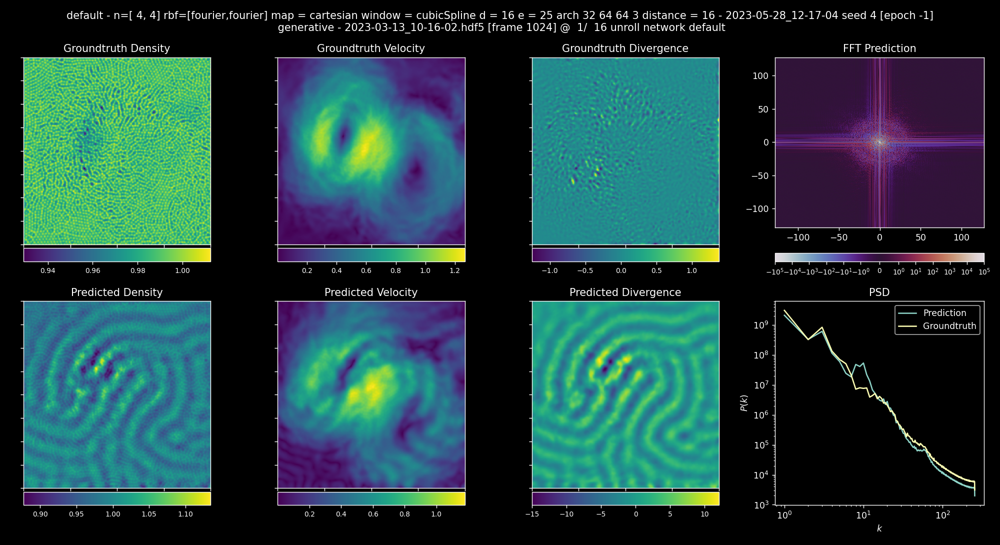

In [52]:
networkIndex = 0
simulationIndex = 0
initialFrame = 1024
unrollSteps = 64
epoch = -1
# generative2D - n=[ 2, 2] rbf=[linear,linear] map = preserving window = poly6 d = 32 e = 10 arch 32 64 64 3 distance = 32 - 2023-03-14_19-24-27
model, hyperParams = loadRbfModel(simulationFiles[simulationIndex], 0, subfolders[networkIndex], epoch)
# model, hyperParams = loadRbfModel(simulationFiles[0], 0, '/home/winchenbach/trainingdata_2D_deltaSPH_001/generative2D - n=[ 4, 4] rbf=[linear,linear] map = preserving window = poly6 d = 32 e = 10 arch 32 64 64 3 distance = 32 - 2023-03-14_20-28-56', -1)

attributes, inputData, groundTruths = loadFrame(simulationFiles[simulationIndex], initialFrame, 1 + np.arange(unrollSteps), hyperParams['frameDistance'],adjustForFrameDistance = True)
# attributes['support'] = 0.01 /4 * 4.5 
fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)

fluidFeatures = fluidFeatures.to(device)

model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[0], -1)

predictedPositions = fluidPositions.to(device)
predictedVelocity = inputData['fluidVelocity'].to(device)

gravity = inputData['fluidGravity'][:,:2].to(device) #torch.zeros_like(predictedVelocity)

with torch.no_grad():
    for unrollStep in tqdm(range(unrollSteps)):
        loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[0], model, None, None, True)
    
# unrollStep = unrollSteps - 1

positions = predictedPositions
velocities = predictedVelocity


gtPositions = groundTruths[unrollStep][:,:2].to(device)
gtVelocities = groundTruths[unrollStep][:,2:4].to(device)
gtDensity = groundTruths[unrollStep][:,4].to(device)

fluidArea = inputData['fluidArea'].to(device)

boundaryPositions = inputData['boundaryPosition'].to(device)
boundaryArea = inputData['boundaryArea'].to(device)



# positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = analyzeParticles(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes)
positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)

fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)

# plotMeshData(fp, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence)

data = torch.linalg.norm(meshVelocity,dim=2)
gtData = torch.linalg.norm(gtMeshVelocity,dim=2)

ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)

kvals,Abins = psd
kvals,gtAbins = gtPsd


# networkIndex = 0
# simulationIndex = 0
# initialFrame = 1024
# unrollSteps = 64
# epoch = -1
fig, axis = plt.subplots(2, 4, figsize=(16,8*1.09), sharex = False, sharey = False, squeeze = False)

fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, 0 + 1, (0+1) * hyperParams['frameDistance'], hyperParams['network'] if 'network' in hyperParams else 'default'))

# scDensity, cbarDensity = scatterPlot(axis[0,0], positions, density, boundaryPositions, 'Predicted Density')
# scVelocity, cbarvelocity = scatterPlot(axis[0,1], positions, torch.linalg.norm(velocities,dim=-1), boundaryPositions, 'Predicted Velocity')
# scColor, cbarColor = scatterPlot(axis[0,2], positions, torch.linalg.norm(colorGrad,dim=-1), boundaryPositions, 'Predicted |Grad Color|')

imPredDensity, cbarPredDensity = meshPlot(axis[1,0], fp, meshDensity, 'Predicted Density')
imGTDensity, cbarGTDensity = meshPlot(axis[0,0], fp, gtMeshDensity, 'Groundtruth Density')
imPredVelocity, cbarPredVelocity = meshPlot(axis[1,1], fp, torch.linalg.norm(meshVelocity, dim = -1), 'Predicted Velocity')
imGTVelocity, cbarGTVelocity = meshPlot(axis[0,1], fp, torch.linalg.norm(gtMeshVelocity, dim = -1), 'Groundtruth Velocity')
imPredDivergence, cbarPredDivergence = meshPlot(axis[1,2], fp, meshDivergence, 'Predicted Divergence')
imGTDivergence, cbarGTDivergence = meshPlot(axis[0,2], fp, gtMeshDivergence, 'Groundtruth Divergence')
ax = axis[0,3]
ax.set_title('FFT Prediction')
imPredFFT = ax.pcolormesh(ffp[:,0].reshape(data.shape).detach().cpu().numpy(), ffp[:,1].reshape(data.shape).detach().cpu().numpy(), torch.real(fft).detach().cpu().numpy(),
                  norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))), base=10), cmap = 'twilight')    
ax1_divider = make_axes_locatable(ax)
cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
cbarPredFFT = fig.colorbar(imPredFFT, cax=cax1,orientation='horizontal')
cbarPredFFT.ax.tick_params(labelsize=8) 
axis[1,3].set_title('PSD')
axis[1,3].loglog(kvals, Abins, label = 'Prediction')
axis[1,3].loglog(kvals, gtAbins, label = 'Groundtruth')
axis[1,3].set_xlabel("$k$")
axis[1,3].set_ylabel("$P(k)$")
axis[1,3].legend()
fig.tight_layout()

updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)


In [53]:
def preparePlot(networkIndex, simulationIndex = 0, initialFrame = 1024, unrollSteps = 64, epoch = -1):
    fig, axis = plt.subplots(2, 4, figsize=(16,8*1.09), sharex = False, sharey = False, squeeze = False)

    fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, 0 + 1, (0+1) * hyperParams['frameDistance'] , hyperParams['network'] if 'network' in hyperParams else 'default'))

    scDensity, cbarDensity = scatterPlot(axis[0,0], positions, density, boundaryPositions, 'Predicted Density')
    scVelocity, cbarvelocity = scatterPlot(axis[0,1], positions, torch.linalg.norm(velocities,dim=-1), boundaryPositions, 'Predicted Velocity')
    scColor, cbarColor = scatterPlot(axis[0,2], positions, torch.linalg.norm(colorGrad,dim=-1), boundaryPositions, 'Predicted |Grad Color|')

    imPredDensity, cbarPredDensity = meshPlot(axis[1,0], fp, meshDensity, 'Predicted Density')
    # imGTDensity, cbarGTDensity = meshPlot(axis[1,0], fp, gtMeshDensity, 'Groundtruth Density')
    imPredVelocity, cbarPredVelocity = meshPlot(axis[1,1], fp, torch.linalg.norm(meshVelocity, dim = -1), 'Predicted Velocity')
    # imGTVelocity, cbarGTVelocity = meshPlot(axis[1,1], fp, torch.linalg.norm(gtMeshVelocity, dim = -1), 'Groundtruth Velocity')
    imPredDivergence, cbarPredDivergence = meshPlot(axis[1,2], fp, meshDivergence, 'Predicted Divergence')
    # imGTDivergence, cbarGTDivergence = meshPlot(axis[1,2], fp, gtMeshDivergence, 'Groundtruth Divergence')
    ax = axis[0,3]
    ax.set_title('FFT Prediction')
    imPredFFT = ax.pcolormesh(ffp[:,0].reshape(data.shape).detach().cpu().numpy(), ffp[:,1].reshape(data.shape).detach().cpu().numpy(), torch.real(fft).detach().cpu().numpy(),
                      norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))), base=10), cmap = 'twilight')    
    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
    cbarPredFFT = fig.colorbar(imPredFFT, cax=cax1,orientation='horizontal')
    cbarPredFFT.ax.tick_params(labelsize=8) 
    axis[1,3].set_title('PSD')
    axis[1,3].loglog(kvals, Abins, label = 'Prediction')
    axis[1,3].loglog(kvals, gtAbins, label = 'Groundtruth')
    axis[1,3].set_xlabel("$k$")
    axis[1,3].set_ylabel("$P(k)$")
    axis[1,3].legend()
    fig.tight_layout()

    updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)
    return fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor

def unrollPlot(fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor, networkIndex, simulationIndex = 0, initialFrame = 1024, unrollSteps = 64, epoch = -1):
    unrollStep = 0
    model, hyperParams = loadRbfModel(simulationFiles[simulationIndex], 0, subfolders[networkIndex], epoch)
    fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'], hyperParams['network'] if 'network' in hyperParams else 'default' ))
    attributes, inputData, groundTruths = loadFrame(simulationFiles[simulationIndex], initialFrame, 1 + np.arange(unrollSteps), hyperParams['frameDistance'])
    fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
    fluidFeatures = fluidFeatures.to(device)
    model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[networkIndex], -1)
    predictedPositions = fluidPositions.to(device)
    predictedVelocity = inputData['fluidVelocity'].to(device)
    gravity = inputData['fluidGravity'][:,:2].to(device) 
    label = 'normalizationTest'
    sim = simulationFiles[simulationIndex].split('/')[-1].split('.')[0]#.replace(' ', '_')
    net = subfolders[networkIndex].split('/')[-1]#.replace(' ', '_')
    imageFolder = '../images/%s/%s/%s/' % (label, sim, net)
    if not os.path.exists(imageFolder):
        if not os.path.exists(imageFolder):
            os.makedirs(imageFolder)
    with torch.no_grad():
        for unrollStep in tqdm(range(unrollSteps), leave = False):
            loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[0], model, None, None, True)    
            positions = predictedPositions
            velocities = predictedVelocity
            gtPositions = groundTruths[unrollStep][:,:2].to(device)
            gtVelocities = groundTruths[unrollStep][:,2:4].to(device)
            gtDensity = groundTruths[unrollStep][:,4].to(device)
            fluidArea = inputData['fluidArea'].to(device)
            boundaryPositions = inputData['boundaryPosition'].to(device)
            boundaryArea = inputData['boundaryArea'].to(device)
            positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)
            fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
            fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)
            data = torch.linalg.norm(meshVelocity,dim=2)
            gtData = torch.linalg.norm(gtMeshVelocity,dim=2)
            ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)
            kvals,Abins = psd
            kvals,gtAbins = gtPsd
            fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'], hyperParams['network'] if 'network' in hyperParams else 'default' ))
            if unrollStep == unrollSteps -1 or unrollStep % 16 == 0:
                updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)
    #                 updatePlot(fig, axis, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins)
                imagePath = '../images/%s/%s/%s/%04d.png' % (label, sim, net, unrollStep)
                plt.savefig(imagePath, dpi = 200)
#     p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -framerate 25 -f image2 -pattern_type glob -i '*.png' -c:v libx264 -b:v 20M -r 25 out.mp4"), cwd='../images/%s/%s/%s/' % (label, sim, net))
#     p.wait()
#     p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -i out.mp4 -filter_complex 'fps=50,scale=720:-1:flags=lanczos,split[s0][s1];[s0]palettegen=max_colors=32[p];[s1][p]paletteuse=dither=bayer' output.gif"), cwd='../images/%s/%s/%s/' % (label, sim, net))
#     p.wait()
#     p = subprocess.Popen(shlex.split('cp out.mp4 ../%s.mp4' % (net.replace(' ','_'))), cwd = '../images/%s/%s/%s/' % (label, sim, net))
#     p = subprocess.Popen(shlex.split('cp output.gif ../%s.gif' % (net.replace(' ','_'))), cwd = '../images/%s/%s/%s/' % (label, sim, net))
#     p.wait()

In [54]:
def preparePlotGT(networkIndex, simulationIndex = 0, initialFrame = 1024, unrollSteps = 64, epoch = -1):
    fig, axis = plt.subplots(2, 4, figsize=(16,8*1.09), sharex = False, sharey = False, squeeze = False)

    fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, 0 + 1, (0+1) * hyperParams['frameDistance'] , hyperParams['network'] if 'network' in hyperParams else 'default'))

#     scDensity, cbarDensity = scatterPlot(axis[0,0], positions, density, boundaryPositions, 'Predicted Density')
#     scVelocity, cbarvelocity = scatterPlot(axis[0,1], positions, torch.linalg.norm(velocities,dim=-1), boundaryPositions, 'Predicted Velocity')
#     scColor, cbarColor = scatterPlot(axis[0,2], positions, torch.linalg.norm(colorGrad,dim=-1), boundaryPositions, 'Predicted |Grad Color|')

    scDensity, cbarDensity = meshPlot(axis[0,0], fp, gtMeshDensity, 'Groundtruth Density')
    scVelocity, cbarvelocity = meshPlot(axis[0,1], fp, torch.linalg.norm(gtMeshVelocity, dim = -1), 'Groundtruth Velocity')
    scColor, cbarColor = meshPlot(axis[0,2], fp, gtMeshDivergence, 'Groundtruth Divergence')
    
    
#     imGTDensity, cbarGTDensity = meshPlot(axis[0,0], fp, gtMeshDensity, 'Groundtruth Density')
#     imGTVelocity, cbarGTVelocity = meshPlot(axis[0,1], fp, torch.linalg.norm(gtMeshVelocity, dim = -1), 'Groundtruth Velocity')
#     imGTDivergence, cbarGTDivergence = meshPlot(axis[0,2], fp, gtMeshDivergence, 'Groundtruth Divergence')
    
    imPredDensity, cbarPredDensity = meshPlot(axis[1,0], fp, meshDensity, 'Predicted Density')
    imPredVelocity, cbarPredVelocity = meshPlot(axis[1,1], fp, torch.linalg.norm(meshVelocity, dim = -1), 'Predicted Velocity')
    imPredDivergence, cbarPredDivergence = meshPlot(axis[1,2], fp, meshDivergence, 'Predicted Divergence')
    ax = axis[0,3]
    ax.set_title('FFT Prediction')
    imPredFFT = ax.pcolormesh(ffp[:,0].reshape(data.shape).detach().cpu().numpy(), ffp[:,1].reshape(data.shape).detach().cpu().numpy(), torch.real(fft).detach().cpu().numpy(),
                      norm=colors.SymLogNorm(linthresh=1, linscale=1, vmin=-torch.max(torch.abs(torch.real(fft))), vmax=torch.max(torch.abs(torch.real(fft))), base=10), cmap = 'twilight')    
    ax1_divider = make_axes_locatable(ax)
    cax1 = ax1_divider.append_axes("bottom", size="5%", pad="15%")
    cbarPredFFT = fig.colorbar(imPredFFT, cax=cax1,orientation='horizontal')
    cbarPredFFT.ax.tick_params(labelsize=8) 
    axis[1,3].set_title('PSD')
    axis[1,3].loglog(kvals, Abins, label = 'Prediction')
    axis[1,3].loglog(kvals, gtAbins, label = 'Groundtruth')
    axis[1,3].set_xlabel("$k$")
    axis[1,3].set_ylabel("$P(k)$")
    axis[1,3].legend()
    fig.tight_layout()

    updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)
    return fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor

def unrollPlot(fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor, networkIndex, simulationIndex = 0, initialFrame = 1024, unrollSteps = 64, epoch = -1):
    unrollStep = 0
    model, hyperParams = loadRbfModel(simulationFiles[simulationIndex], 0, subfolders[networkIndex], epoch)
    fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'], hyperParams['network'] if 'network' in hyperParams else 'default' ))
    attributes, inputData, groundTruths = loadFrame(simulationFiles[simulationIndex], initialFrame, 1 + np.arange(unrollSteps), hyperParams['frameDistance'])
    fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
    fluidFeatures = fluidFeatures.to(device)
    model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[networkIndex], -1)
    predictedPositions = fluidPositions.to(device)
    predictedVelocity = inputData['fluidVelocity'].to(device)
    gravity = inputData['fluidGravity'][:,:2].to(device) 
    label = 'windowFunctionTestPentecoste'
    sim = simulationFiles[simulationIndex].split('/')[-1].split('.')[0]#.replace(' ', '_')
    net = subfolders[networkIndex].split('/')[-1]#.replace(' ', '_')
    imageFolder = '../images/%s/%s/%s/' % (label, sim, net)
    if not os.path.exists(imageFolder):
        if not os.path.exists(imageFolder):
            os.makedirs(imageFolder)
    with torch.no_grad():
        for unrollStep in tqdm(range(unrollSteps), leave = False):
            loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[0], model, None, None, True)    
            positions = predictedPositions
            velocities = predictedVelocity
            gtPositions = groundTruths[unrollStep][:,:2].to(device)
            gtVelocities = groundTruths[unrollStep][:,2:4].to(device)
            gtDensity = groundTruths[unrollStep][:,4].to(device)
            fluidArea = inputData['fluidArea'].to(device)
            boundaryPositions = inputData['boundaryPosition'].to(device)
            boundaryArea = inputData['boundaryArea'].to(device)
            positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)
            fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
            fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)
            data = torch.linalg.norm(meshVelocity,dim=2)
            gtData = torch.linalg.norm(gtMeshVelocity,dim=2)
            ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)
            kvals,Abins = psd
            kvals,gtAbins = gtPsd
            fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll network %s' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'], hyperParams['network'] if 'network' in hyperParams else 'default' ))
            if unrollStep == unrollSteps -1 or unrollStep % 16 == 0:
                updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)
    #                 updatePlot(fig, axis, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins)
                imagePath = '../images/%s/%s/%s/%04d.png' % (label, sim, net, unrollStep)
                plt.savefig(imagePath, dpi = 200)
#     p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -framerate 25 -f image2 -pattern_type glob -i '*.png' -c:v libx264 -b:v 20M -r 25 out.mp4"), cwd='../images/%s/%s/%s/' % (label, sim, net))
#     p.wait()
#     p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -i out.mp4 -filter_complex 'fps=50,scale=720:-1:flags=lanczos,split[s0][s1];[s0]palettegen=max_colors=32[p];[s1][p]paletteuse=dither=bayer' output.gif"), cwd='../images/%s/%s/%s/' % (label, sim, net))
#     p.wait()
#     p = subprocess.Popen(shlex.split('cp out.mp4 ../%s.mp4' % (net.replace(' ','_'))), cwd = '../images/%s/%s/%s/' % (label, sim, net))
#     p = subprocess.Popen(shlex.split('cp output.gif ../%s.gif' % (net.replace(' ','_'))), cwd = '../images/%s/%s/%s/' % (label, sim, net))
#     p.wait()

In [55]:
which_x = 'rbf_x'
which_z = 'networkSeed'
which_y = 'windowFunction'

xvars = []
yvars = []
zvars = []
for s in subfolders:
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
    xv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
    if xv not in xvars:
        xvars.append(xv)
    if yv not in yvars:
        yvars.append(yv)
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
xvars.sort()
yvars.sort()
zvars.sort()

xvars [list] = ['fourier x fourier', 'rbf square x rbf square', 'chebyshev x chebyshev', 'ubf quartic_spline x ubf quartic_spline', 'abf gaussian x abf gaussian', 'ubf poly6 x ubf poly6', 'ubf gaussian x ubf gaussian', 'ubf wendland2 x ubf wendland2', 'rbf linear x rbf linear', 'chebyshev 2 x chebyshev 2', 'ubf cubic_spline x ubf cubic_spline', 'abf cubic_spline x abf cubic_spline', 'abf poly6 x abf poly6', 'abf bump x abf bump', 'abf wendland2 x abf wendland2', 'abf quartic_spline x abf quartic_spline', 'rbf spiky x rbf spiky']
yvars [list] = ['cubicSpline', 'Linear', 'None', 'poly6']
zvars [list] = [4, 5, 3]


In [56]:
y = 'poly6'
x = 'rbf square x rbf square'
z = 5


for i, s in enumerate(subfolders):
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
    xv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
#     print(xv,xv == x,yv,yv == y,zv,zv == z)
    if xv == x and yv == y and zv == z:
        networkIndex = i
        break
print(i)

4


<IPython.core.display.Javascript object>


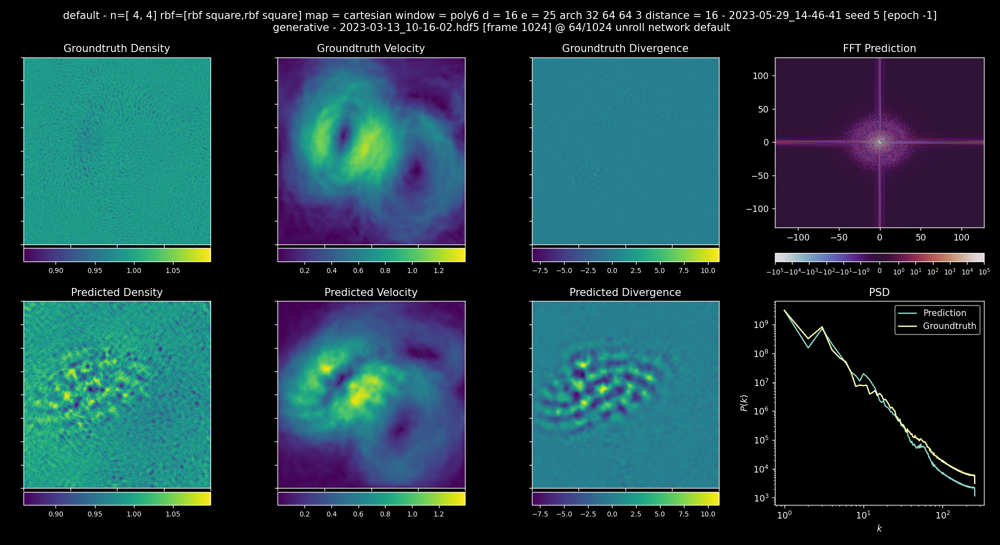

In [57]:
fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor = preparePlotGT(networkIndex)

In [58]:
unrollPlot(fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor, networkIndex)

  0%|          | 0/64 [00:00<?, ?it/s]

In [59]:
import subprocess
import shlex

In [60]:
# label = 'windowFunctionTestPentecoste'
# imageFolder = '../images/%s' % label
# if not os.path.exists(imageFolder):
#     os.makedirs(imageFolder)


In [61]:
# networkIndex = 0

In [62]:
# fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor = preparePlotGT(networkIndex)


In [63]:
import subprocess
import shlex

In [64]:
# for networkIndex in tqdm(range(len(subfolders))):
#     unrollPlot(fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor, networkIndex)

#     title = '%s = %s, %s = %s, %s = %s' %( which_x, dataDict[subfolders[networkIndex]]['hyperParameters'][which_x],which_y, dataDict[subfolders[networkIndex]]['hyperParameters'][which_y],which_z, dataDict[subfolders[networkIndex]]['hyperParameters'][which_z])
#     fig.suptitle(title) 

#     imagePath = '../images/%s/%s.png' % (label, title)
#     plt.savefig(imagePath, dpi = 200)

In [65]:

# import subprocess
# import shlex


In [66]:
# for networkIndex in tqdm(range(len(subfolders))):
#     unrollStep = 0
#     fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'] ))
#     model, hyperParams = loadRbfModel(simulationFiles[simulationIndex], 0, subfolders[networkIndex], epoch)
#     attributes, inputData, groundTruths = loadFrame(simulationFiles[simulationIndex], initialFrame, 1 + np.arange(unrollSteps), hyperParams['frameDistance'])
#     fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
#     fluidFeatures = fluidFeatures.to(device)
#     model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[networkIndex], -1)
#     predictedPositions = fluidPositions.to(device)
#     predictedVelocity = inputData['fluidVelocity'].to(device)
#     gravity = inputData['fluidGravity'][:,:2].to(device) 
#     label = 'baseFunctionTestBroadv2'
#     sim = simulationFiles[simulationIndex].split('/')[-1].split('.')[0]#.replace(' ', '_')
#     net = subfolders[networkIndex].split('/')[-1]#.replace(' ', '_')
#     imageFolder = '../images/%s/%s/%s/' % (label, sim, net)
#     if True:# not os.path.exists(imageFolder):
#         if not os.path.exists(imageFolder):
#             os.makedirs(imageFolder)
#             with torch.no_grad():
#                 for unrollStep in tqdm(range(unrollSteps), leave = False):
#                     loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[i], model, None, None, True)    
#                     positions = predictedPositions
#                     velocities = predictedVelocity
#                     gtPositions = groundTruths[unrollStep][:,:2].to(device)
#                     gtVelocities = groundTruths[unrollStep][:,2:4].to(device)
#                     gtDensity = groundTruths[unrollStep][:,4].to(device)
#                     fluidArea = inputData['fluidArea'].to(device)
#                     boundaryPositions = inputData['boundaryPosition'].to(device)
#                     boundaryArea = inputData['boundaryArea'].to(device)
#                     positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)
#                     fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
#                     fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)
#                     data = torch.linalg.norm(meshVelocity,dim=2)
#                     gtData = torch.linalg.norm(gtMeshVelocity,dim=2)
#                     ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)
#                     kvals,Abins = psd
#                     kvals,gtAbins = gtPsd
#                     fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'] ))
#                     updatePlot2(fig, axis, positions, density, velocities, colorGrad, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor)
#     #                 updatePlot(fig, axis, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence, fft, kvals, Abins, gtAbins)
#                     imagePath = '../images/%s/%s/%s/%04d.png' % (label, sim, net, unrollStep)
#                     plt.savefig(imagePath, dpi = 200)
#         p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -framerate 25 -f image2 -pattern_type glob -i '*.png' -c:v libx264 -b:v 20M -r 25 out.mp4"), cwd='../images/%s/%s/%s/' % (label, sim, net))
#         p.wait()
#         p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -i out.mp4 -filter_complex 'fps=50,scale=720:-1:flags=lanczos,split[s0][s1];[s0]palettegen=max_colors=32[p];[s1][p]paletteuse=dither=bayer' output.gif"), cwd='../images/%s/%s/%s/' % (label, sim, net))
#         p.wait()
#         p = subprocess.Popen(shlex.split('cp out.mp4 ../%s.mp4' % (net.replace(' ','_'))), cwd = '../images/%s/%s/%s/' % (label, sim, net))
#         p = subprocess.Popen(shlex.split('cp output.gif ../%s.gif' % (net.replace(' ','_'))), cwd = '../images/%s/%s/%s/' % (label, sim, net))
#         p.wait()
#     else:
#         print('nothing to do for %s/%s' % (sim, net))

In [67]:
import subprocess
import shlex

In [68]:
def getLosses(positions, velocities, gtPositions, gtDensity, gtVelocities, fluidArea, boundaryPositions, boundaryArea, attributes):
    positionLoss, velocityLoss, density, gtDensity, colorField, gtColorField, colorGrad, gtColorGrad = particleAnalysis(positions, gtPositions, boundaryPositions, velocities, gtVelocities, fluidArea, boundaryArea, attributes, plot = False)
    fp, meshDensity, meshVelocity, meshDivergence = getMeshQuantities(positions, boundaryPositions, fluidArea, boundaryArea, density, velocities, attributes, n = 512)
    fp, gtMeshDensity, gtMeshVelocity, gtMeshDivergence = getMeshQuantities(gtPositions, boundaryPositions, fluidArea, boundaryArea, gtDensity, gtVelocities, attributes, n = 512)
    # plotMeshData(fp, meshDensity, gtMeshDensity, meshVelocity, gtMeshVelocity, meshDivergence, gtMeshDivergence)

    data = torch.linalg.norm(meshVelocity,dim=2)
    gtData = torch.linalg.norm(gtMeshVelocity,dim=2)
    ffp, fft, gtFft, psd, gtPsd = meshAnalysis(fp, data, gtData,linThresh=1e0, linScale = 0.5, plot = False)
    kvals,Abins = psd
    kvals,gtAbins = gtPsd

    positionLossTerm = torch.mean(positionLoss)
    velocityLossTerm = torch.mean(velocityLoss)
    densityLossTerm = torch.mean(torch.abs(density - gtDensity))
    colorFieldLossTerm = torch.mean(torch.abs(colorField - gtColorField))
    colorGradLossTerm = torch.mean(torch.linalg.norm(colorGrad - gtColorGrad,dim=1))

    meshDensityLossTerm = torch.mean(torch.abs(meshDensity - gtMeshDensity))
    meshVelocityLossTerm = torch.mean(torch.abs(meshVelocity - gtMeshVelocity))
    meshDivergenceLossTerm = torch.mean(torch.abs(meshDivergence - gtMeshDivergence))

    psdLossTerm = np.sum(np.abs(np.log10(Abins) - np.log10(gtAbins)))
    
    return {\
            'position': positionLossTerm.item(), 
            'velocity': velocityLossTerm.item(), 
            'density': densityLossTerm.item(), 
            'color': colorFieldLossTerm.item(), 
            'colorGrad': colorGradLossTerm.item(), 
            'meshDensity': meshDensityLossTerm.item(), 
            'meshVelocity': meshVelocityLossTerm.item(), 
            'meshDivergence': meshDivergenceLossTerm.item(), 
            'psd': psdLossTerm.item(), 
            'kvals': kvals, 
            'Abins': Abins, 
            'gtAbins':gtAbins}
# lossDict = getLosses(positions, velocities, gtPositions, gtDensity, fluidArea, boundaryPositions, boundaryArea, attributes)

In [69]:
# trainFolder = '/mnt/c/Users/Rimuru/trainingData'
trainFolder = '~/trainingdata_2D_deltaSPH_001'
trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataBaseFunctions2'
trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste'
# trainFolder = '~/servus03/torchSPH2/Cconv/trainingData'
# trainFolder = '~/servus03/torchSPH2/Cconv/trainingDataNormalization'
# trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataSeedVariance'
# trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingDataLongEpoch'
trainFolder = os.path.expanduser(trainFolder)
subfolders = [ f.path for f in os.scandir(trainFolder) if f.is_dir() ]
# subfolders = [ f.path for f in os.scandir('./trainingDataBasisFunctions8x8') if f.is_dir() ]
print(len(subfolders))

subfolders = [s for s in subfolders if os.path.exists(s + '/results.json')]
print(len(subfolders))

dataDict = {}

# subfolders = [subfolders[0]]
for s in tqdm(subfolders):
    with open("%s/results.json" % s, "r") as read_file:
        decodedArray = json.load(read_file)
        dataDict[s] = decodedArray
#         print(decodedArray['hyperParameters'])   

204
204


  0%|          | 0/204 [00:00<?, ?it/s]

In [70]:

def loadFrame(filename, frame, frameOffsets = [1], frameDistance = 1, adjustForFrameDistance = True):
    if 'zst' in filename:
        return loadFrameZSTD(filename, frame, frameOffsets, frameDistance)
    inFile = h5py.File(filename)
    inGrp = inFile['simulationExport']['%05d' % frame]
#     debugPrint(inFile.attrs.keys())
    attributes = {
     'support': np.max(inGrp['fluidSupport'][:]),
     'targetNeighbors': inFile.attrs['targetNeighbors'],
     'restDensity': inFile.attrs['restDensity'],
     'dt': inGrp.attrs['dt'],
     'time': inGrp.attrs['time'],
     'radius': inFile.attrs['radius'],
     'area': inFile.attrs['radius'] **2 * np.pi,
    }
#     debugPrint(inGrp.attrs['timestep'])

    # support = inFile.attrs['support']
    # targetNeighbors = inFile.attrs['targetNeighbors']
    # restDensity = inFile.attrs['restDensity']
    # dt = inFile.attrs['initialDt']

    inputData = {
        'fluidPosition': torch.from_numpy(inGrp['fluidPosition'][:]).type(torch.float32),
        'fluidVelocity': torch.from_numpy(inGrp['fluidVelocity'][:]).type(torch.float32),
        'fluidArea' : torch.from_numpy(inGrp['fluidArea'][:]).type(torch.float32),
        'fluidDensity' : torch.from_numpy(inGrp['fluidDensity'][:]).type(torch.float32),
        'fluidSupport' : torch.from_numpy(inGrp['fluidSupport'][:]).type(torch.float32),
        'fluidGravity' : torch.from_numpy(inGrp['fluidGravity'][:]).type(torch.float32) if 'fluidGravity' not in inFile.attrs else torch.from_numpy(inFile.attrs['fluidGravity']).type(torch.float32) * torch.ones(inGrp['fluidDensity'][:].shape[0])[:,None],
        'boundaryPosition': torch.from_numpy(inFile['boundaryInformation']['boundaryPosition'][:]).type(torch.float32),
        'boundaryNormal': torch.from_numpy(inFile['boundaryInformation']['boundaryNormals'][:]).type(torch.float32),
        'boundaryArea': torch.from_numpy(inFile['boundaryInformation']['boundaryArea'][:]).type(torch.float32),
        'boundaryVelocity': torch.from_numpy(inFile['boundaryInformation']['boundaryVelocity'][:]).type(torch.float32),
        'boundaryDensity': torch.from_numpy(inGrp['boundaryDensity'][:]).type(torch.float32)
    }
    if adjustForFrameDistance:
        if frame >= frameDistance:
            priorGrp = inFile['simulationExport']['%05d' % (frame - frameDistance)]
            priorPosition = torch.from_numpy(priorGrp['fluidPosition'][:]).type(torch.float32)
            inputData['fluidVelocity'] = (inputData['fluidPosition'] - priorPosition) / (frameDistance * attributes['dt'])
            # priorVelocity = torch.from_numpy(priorGrp['fluidVelocity'][:]).type(torch.float32)

    groundTruthData = []
    for i in frameOffsets:
        gtGrp = inFile['simulationExport']['%05d' % (frame + i * frameDistance)]
#         debugPrint((frame + i * frameDistance))
#         debugPrint(gtGrp.attrs['timestep'])
        gtData = {
            'fluidPosition'    : torch.from_numpy(gtGrp['fluidPosition'][:]).type(torch.float32),
            'fluidVelocity'    : torch.from_numpy(gtGrp['fluidVelocity'][:]).type(torch.float32),
            'fluidDensity'     : torch.from_numpy(gtGrp['fluidDensity'][:]).type(torch.float32),
    #         'fluidPressure'    : torch.from_numpy(gtGrp['fluidPressure'][:]),
    #         'boundaryDensity'  : torch.from_numpy(gtGrp['fluidDensity'][:]),
    #         'boundaryPressure' : torch.from_numpy(gtGrp['fluidPressure'][:]),
        }
        
        groundTruthData.append(torch.hstack((gtData['fluidPosition'].type(torch.float32), gtData['fluidVelocity'], gtData['fluidDensity'][:,None])))
        
    
    inFile.close()
    
    return attributes, inputData, groundTruthData


In [71]:
unrollSteps = 64
overallDict = {}
for networkIndex in tqdm(range(len(subfolders))):
    unrollStep = 0
    if dataDict[subfolders[networkIndex]]['hyperParameters']['coordinateMapping'] != 'cartesian':
        continue
#     fig.suptitle('%s [epoch %2d]\n %s [frame %4d] @ %2d/%4d unroll' % (subfolders[networkIndex].split('/')[-1], epoch, simulationFiles[simulationIndex].split('/')[-1], initialFrame, unrollStep + 1, (unrollStep+1) * hyperParams['frameDistance'] ))
    model, hyperParams = loadRbfModel(simulationFiles[simulationIndex], 0, subfolders[networkIndex], epoch)
    attributes, inputData, groundTruths = loadFrame(simulationFiles[simulationIndex], initialFrame, 1 + np.arange(unrollSteps), hyperParams['frameDistance'], adjustForFrameDistance = False)
    fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
    fluidFeatures = fluidFeatures.to(device)
    model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[networkIndex], -1)
    predictedPositions = fluidPositions.to(device)
    predictedVelocity = inputData['fluidVelocity'].to(device)
    gravity = inputData['fluidGravity'][:,:2].to(device) 
    losses = []
    with torch.no_grad():
        for unrollStep in tqdm(range(unrollSteps), leave = False):
            _, _, groundTruths2 = loadFrame(simulationFiles[simulationIndex], initialFrame + unrollStep * hyperParams['frameDistance'], 1 + np.arange(hyperParams['frameDistance']), 1)
            loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[unrollStep], model, None, None, True)    
            positions = predictedPositions
            velocities = predictedVelocity
            gtPositions = groundTruths[unrollStep][:,:2].to(device)
            gtVelocity = torch.vstack([g[:,2:4][None,:] for g in groundTruths2])
            gtVelocities = torch.mean(gtVelocity, axis = 0).to(device)
            
            gtVelocities = groundTruths[unrollStep][:,2:4].to(device)
            gtDensity = groundTruths[unrollStep][:,4].to(device)
            fluidArea = inputData['fluidArea'].to(device)
            boundaryPositions = inputData['boundaryPosition'].to(device)
            boundaryArea = inputData['boundaryArea'].to(device)

            lossDict = getLosses(positions, velocities, gtPositions, gtDensity, gtVelocities, fluidArea, boundaryPositions, boundaryArea, attributes)
            losses.append(lossDict)
    overallDict[subfolders[networkIndex]] = losses

  0%|          | 0/204 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

In [72]:

labelDict = {}
for s in overallDict:
    params = dataDict[s]['hyperParameters']
    base = '%s' % params['rbf_x']
#     base = '%s[%d] x %s[%d] @ %s - %s' % (params['rbf_x'].split(' ')[-1] if len(params['rbf_x'].split(' ')) < 3 else (params['rbf_x'].split(' ')[1]), params['n'], (params['rbf_y'].split(' ')[-1] if len(params['rbf_y'].split(' ')) < 3 else (params['rbf_y'].split(' ')[1])), params['m'], params['coordinateMapping'], params['network'] if 'network' in params else 'default')
#     base = '%s[%d] x %s[%d] @ %s' % (params['arch'], params['n'], params['rbf_y'].split(' ')[-1], params['m'], params['coordinateMapping'])
#     base = params['rbf_x'] +  + ' x ' + params['rbf_y'] + ' @ ' + params['coordinateMapping']
#     print(params['rbf_x'],'\t\t', params['rbf_y'], '\n\t',base)
    labelDict[s] = base
    
    print(base)
#     print(dataDict[s]['hyperParameters'].keys())

fourier
rbf square
chebyshev
ubf quartic_spline
rbf square
rbf square
abf gaussian
ubf poly6
ubf gaussian
ubf wendland2
abf gaussian
rbf linear
rbf square
chebyshev 2
ubf cubic_spline
ubf quartic_spline
abf cubic_spline
abf poly6
chebyshev
ubf gaussian
chebyshev 2
abf bump
ubf quartic_spline
fourier
abf bump
abf wendland2
abf quartic_spline
abf gaussian
abf quartic_spline
abf cubic_spline
chebyshev 2
rbf spiky
ubf gaussian
abf cubic_spline
fourier
ubf wendland2
rbf spiky
rbf spiky
abf quartic_spline
rbf linear
ubf poly6
abf wendland2
fourier
rbf linear
abf cubic_spline
ubf cubic_spline
ubf wendland2
abf wendland2
abf gaussian
ubf wendland2
abf wendland2
abf quartic_spline
abf gaussian
fourier
abf bump
fourier
rbf linear
fourier
ubf poly6
abf gaussian
abf wendland2
rbf spiky
ubf poly6
fourier
ubf poly6
ubf cubic_spline
ubf cubic_spline
abf quartic_spline
abf bump
fourier
abf poly6
abf poly6
abf poly6
abf wendland2
abf poly6
rbf square
ubf poly6
ubf poly6
ubf wendland2
abf poly6
ubf gaus

In [73]:
print(labelDict.values())

dict_values(['fourier', 'rbf square', 'chebyshev', 'ubf quartic_spline', 'rbf square', 'rbf square', 'abf gaussian', 'ubf poly6', 'ubf gaussian', 'ubf wendland2', 'abf gaussian', 'rbf linear', 'rbf square', 'chebyshev 2', 'ubf cubic_spline', 'ubf quartic_spline', 'abf cubic_spline', 'abf poly6', 'chebyshev', 'ubf gaussian', 'chebyshev 2', 'abf bump', 'ubf quartic_spline', 'fourier', 'abf bump', 'abf wendland2', 'abf quartic_spline', 'abf gaussian', 'abf quartic_spline', 'abf cubic_spline', 'chebyshev 2', 'rbf spiky', 'ubf gaussian', 'abf cubic_spline', 'fourier', 'ubf wendland2', 'rbf spiky', 'rbf spiky', 'abf quartic_spline', 'rbf linear', 'ubf poly6', 'abf wendland2', 'fourier', 'rbf linear', 'abf cubic_spline', 'ubf cubic_spline', 'ubf wendland2', 'abf wendland2', 'abf gaussian', 'ubf wendland2', 'abf wendland2', 'abf quartic_spline', 'abf gaussian', 'fourier', 'abf bump', 'fourier', 'rbf linear', 'fourier', 'ubf poly6', 'abf gaussian', 'abf wendland2', 'rbf spiky', 'ubf poly6', 'fo

In [74]:
cm = plt.get_cmap('gist_rainbow')
NUM_COLORS = 34
cols = [cm(1.*i/NUM_COLORS) for i in range(NUM_COLORS)]

cols = plt.rcParams['axes.prop_cycle'].by_key()['color']

0
/home/winchenbach/servus05/dev/torchSPH2/Cconv/trainingDataPentecoste/default - n=[ 4, 4] rbf=[fourier,fourier] map = cartesian window = cubicSpline d = 16 e = 25 arch 32 64 64 3 distance = 16 - 2023-05-28_12-17-04 seed 4
xvars [list] = [4, 5, 3]
yvars [list] = ['fourier x fourier @ 4', 'rbf square x rbf square @ 4', 'chebyshev x chebyshev @ 4', 'ubf quartic_spline x ubf quartic_spline @ 4', 'abf gaussian x abf gaussian @ 4', 'ubf poly6 x ubf poly6 @ 4', 'ubf gaussian x ubf gaussian @ 4', 'ubf wendland2 x ubf wendland2 @ 4', 'rbf linear x rbf linear @ 4', 'chebyshev 2 x chebyshev 2 @ 4', 'ubf cubic_spline x ubf cubic_spline @ 4', 'abf cubic_spline x abf cubic_spline @ 4', 'abf poly6 x abf poly6 @ 4', 'abf bump x abf bump @ 4', 'abf wendland2 x abf wendland2 @ 4', 'abf quartic_spline x abf quartic_spline @ 4', 'rbf spiky x rbf spiky @ 4']
zvars [list] = ['cubicSpline', 'Linear', 'None', 'poly6']


<IPython.core.display.Javascript object>


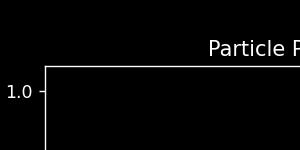

In [75]:
# # def plotIndividual(s):
    
#             'position': positionLossTerm.item(), 
#             'velocity': velocityLossTerm.item(), 
#             'density': densityLossTerm.item(), 
#             'color': colorFieldLossTerm.item(), 
#             'colorGrad': colorGradLossTerm.item(), 
#             'meshDensity': meshDensityLossTerm.item(), 
#             'meshVelocity': meshVelocityLossTerm.item(), 
#             'meshDivergence': meshDivergenceLossTerm.item(), 
#             'psd': psdLossTerm.item(), 
#             'kvals': kvals, 
#             'Abins': Abins, 
#             'gtAbins':gtAbins}
                
                
from matplotlib.lines import Line2D
# cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
print(subfolders.index(subfolders[0]))

# print([s for s in subfolders if dataDict[s]['hyperParameters'][which_x] == xvars[0]])

# legend_elements = [Line2D([0], [0], color=cols[[s for s in subfolders if dataDict[s]['hyperParameters'][which_x] == xvars[0]].index(x) % len(cols)], lw=4, label='%s' % (labelDict[x])) for x in subfolders]

# for i in range(len(zvars)):
    
    
    
s = subfolders[0]
print(s)

x = np.arange(initialFrame + dataDict[s]['hyperParameters']['frameDistance'], initialFrame + (unrollSteps+1) * dataDict[s]['hyperParameters']['frameDistance'], dataDict[s]['hyperParameters']['frameDistance'])

which_x = 'networkSeed'
which_z = 'windowFunction'
# which_z = 'rbf_x'
# which_x = 'networkSeed'
which_y = 'rbf_x'
# which_z = 'network'

xvars = []
yvars = []
zvars = []
for s in subfolders:
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
    yv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
    if xv not in xvars:
        xvars.append(xv)
    if yv not in yvars:
        yvars.append(yv)
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
xvars.sort()
yvars.sort()
zvars.sort()

fig = plt.figure(figsize=(24,8*1.09 * len(xvars)),constrained_layout = True)
# fig = plt.figure(figsize=(20,8*1.09 * len(xvars)))
# fig.suptitle('Mean Loss, Epoch %d' % -1)
subfigs = fig.subfigures(len(xvars), 1, wspace=0.07, squeeze = False)

axs = []
for i in range(len(xvars)):
    subfigs[i,0].suptitle('%s = %s' % (which_x, xvars[i]), fontsize='x-large')
    lax = subfigs[i,0].subplots(2, 5, sharey=False, squeeze = False)
    axs.append(lax)    
    axis = lax
    
    selected = [s for s in subfolders if dataDict[s]['hyperParameters'][which_x] == xvars[i]]
#     selected = [s for s in subfolders if (dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']) == xvars[i]]
#     print(selected)
    legend_elements = [Line2D([0], [0], color=cols[selected.index(x) % len(cols)], lw=4, label='%s' % (labelDict[x])) for x in selected]

#     subfigs[i,0].legend(handles=legend_elements, loc='lower center',ncols = 8, bbox_to_anchor=(0.5, 0.15))
#     axis[1,4].legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))

    axis[0,0].set_title('Particle Position Loss')
    axis[0,1].set_title('Particle Velocity Loss')
    axis[0,2].set_title('Particle Densitty Loss')
    axis[0,3].set_title('Particle Color Loss')
    axis[0,4].set_title('Particle ColorGrad Loss')
    axis[1,0].set_title('Mesh Density Loss')
    axis[1,1].set_title('Mesh Velocity Loss')
    axis[1,2].set_title('Mesh Divergence Loss')
    axis[1,3].set_title('Mesh PSD Loss')
    axis[1,4].set_title('PSD Loss')
    axis[1,4].loglog(overallDict[s][-1]['kvals'], overallDict[s][-1]['gtAbins'], label = 'gt', c = 'white')
    
    
    
# fig, axis = plt.subplots(2, 5, figsize=(24,8*1.09 * len(xvars)), sharex = False, sharey = False, squeeze = False)
for s in subfolders:
    if dataDict[s]['hyperParameters']['coordinateMapping'] != 'cartesian':
        continue
#     selected = [ss for ss in subfolders if dataDict[ss]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] == dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']]
    
    selected = [ss for ss in subfolders if dataDict[ss]['hyperParameters'][which_x] == dataDict[s]['hyperParameters'][which_x]]
#     selected = [ss for ss in subfolders if (dataDict[ss]['hyperParameters']['rbf_x'] + ' x ' + dataDict[ss]['hyperParameters']['rbf_y']) == (dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])]
    labels = [labelDict[s] for s in selected]
    
    labels = list(set(labels))
    label = labelDict[s]
#     print(selected)
#     labels = [labelDict[s] for s in selected]
#     print(labels)
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,0].plot(x, [lDict['position'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,1].plot(x, [lDict['velocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,2].plot(x, [lDict['density'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,3].plot(x, [lDict['color'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,4].plot(x, [lDict['colorGrad'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,0].plot(x, [lDict['meshDensity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,1].plot(x, [lDict['meshVelocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,2].plot(x, [lDict['meshDivergence'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,3].plot(x, [lDict['psd'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,4].loglog(overallDict[s][-1]['kvals'], overallDict[s][-1]['Abins'],  label = labelDict[s], c = cols[selected.index(s) % len(cols)])
    
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][0,0].plot(x, [lDict['position'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][0,1].plot(x, [lDict['velocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][0,2].plot(x, [lDict['density'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][0,3].plot(x, [lDict['color'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][0,4].plot(x, [lDict['colorGrad'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][1,0].plot(x, [lDict['meshDensity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][1,1].plot(x, [lDict['meshVelocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][1,2].plot(x, [lDict['meshDivergence'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][1,3].plot(x, [lDict['psd'] for lDict in overallDict[s]], label = labelDict[s], c = cols[labels.index(label) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])][1,4].loglog(overallDict[s][-1]['kvals'], overallDict[s][-1]['Abins'],  label = labelDict[s], c = cols[labels.index(label) % len(cols)])
    
for i in range(len(xvars)):
    axs[i][0,0].legend()
    
    handles, labels = axs[i][0,0].get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    axs[i][0,0].legend(by_label.values(), by_label.keys())
# axis[1,4].plot(x, [lDict['position'] for lDict in overallDict[s]], label = labelDict[s])

# for i in range(len(xvars)):
#     subfigs[i,0].tight_layout()
# fig.suptitle(labelDict[s])

# fig.tight_layout()

#     subfigs[i,0].suptitle('%s = %s' % (which_x, xvars[i]), fontsize='x-large')
#     lax = subfigs[i,0].subplots(2, 5, sharey=False, squeeze = False)
#     axs.append(lax)    
#     axis = lax
    
# for i in range(len(xvars)):
#     selected = [s for s in subfolders if dataDict[s]['hyperParameters'][which_x] == xvars[i]]
#     print(selected)
#     legend_elements = [Line2D([0], [0], color=cols[selected.index(x) % len(cols)], lw=4, label='%s' % (labelDict[x])) for x in selected]

#     subfigs[i,0].legend(handles=legend_elements, loc='upper center',ncols = 5, bbox_to_anchor=(0.5, 0.950))

In [76]:

which_z = 'coordinateMapping'
which_x = 'rbf_x'
which_y = 'rbf_y'

xvars = []
yvars = []
zvars = []
for s in subfolders:
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
#     xv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
    if xv not in xvars:
        xvars.append(xv)
    if yv not in yvars:
        yvars.append(yv)
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
xvars.sort()
yvars.sort()
zvars.sort()


xvars [list] = ['fourier', 'rbf square', 'chebyshev', 'ubf quartic_spline', 'abf gaussian', 'ubf poly6', 'ubf gaussian', 'ubf wendland2', 'rbf linear', 'chebyshev 2', 'ubf cubic_spline', 'abf cubic_spline', 'abf poly6', 'abf bump', 'abf wendland2', 'abf quartic_spline', 'rbf spiky']
yvars [list] = ['fourier', 'rbf square', 'chebyshev', 'ubf quartic_spline', 'abf gaussian', 'ubf poly6', 'ubf gaussian', 'ubf wendland2', 'rbf linear', 'chebyshev 2', 'ubf cubic_spline', 'abf cubic_spline', 'abf poly6', 'abf bump', 'abf wendland2', 'abf quartic_spline', 'rbf spiky']
zvars [list] = ['cartesian']


In [77]:

which_x = 'rbf_x'
which_y = 'windowFunction'
which_z = 'networkSeed'

xvars = []
yvars = []
zvars = []
for s in overallDict.keys():
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
#     yv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
    if xv not in xvars:
        xvars.append(xv)
    if yv not in yvars:
        yvars.append(yv)
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
xvars.sort()
yvars.sort()
zvars.sort()


xvars [list] = ['fourier', 'rbf square', 'chebyshev', 'ubf quartic_spline', 'abf gaussian', 'ubf poly6', 'ubf gaussian', 'ubf wendland2', 'rbf linear', 'chebyshev 2', 'ubf cubic_spline', 'abf cubic_spline', 'abf poly6', 'abf bump', 'abf wendland2', 'abf quartic_spline', 'rbf spiky']
yvars [list] = ['cubicSpline', 'Linear', 'None', 'poly6']
zvars [list] = [4, 5, 3]


xvars [list] = ['fourier', 'rbf square', 'chebyshev', 'ubf quartic_spline', 'abf gaussian', 'ubf poly6', 'ubf gaussian', 'ubf wendland2', 'rbf linear', 'chebyshev 2', 'ubf cubic_spline', 'abf cubic_spline', 'abf poly6', 'abf bump', 'abf wendland2', 'abf quartic_spline', 'rbf spiky']
yvars [list] = ['cubicSpline', 'Linear', 'None', 'poly6']
zvars [list] = [4, 5, 3]


<IPython.core.display.Javascript object>


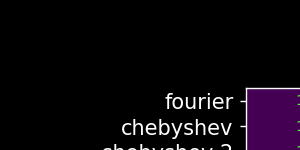

Text(0.5, 0.98, 'Meta Loss, Epoch -1')

In [78]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm

which_x = 'rbf_x'
which_y = 'windowFunction'
which_z = 'networkSeed'

xvars = []
yvars = []
zvars = []
for s in overallDict.keys():
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    zv = dataDict[s]['hyperParameters'][which_z]
#     yv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
    if xv not in xvars:
        xvars.append(xv)
    if yv not in yvars:
        yvars.append(yv)
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
xvars.sort()
yvars.sort()
zvars.sort()

def lToMat2(key, reduce = 'median'):
    lMats = None
#     for z in zvars:
    lMats = np.zeros((len(xvars), len(yvars))) *np.nan
    losses = [[lDict[key] for lDict in overallDict[s]] for s in subfolders if s in overallDict]
    # print(len(losses))
    for i, (l,s) in enumerate(zip(losses, overallDict.keys())):
        if dataDict[s]['hyperParameters']['coordinateMapping'] != 'cartesian':
            continue
    #     print(i, l, s)
        xs = dataDict[s]['hyperParameters'][which_x]
        
        ys = dataDict[s]['hyperParameters'][which_y]
        zs = dataDict[s]['hyperParameters'][which_z]
#         ys = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
#         print(i, xs, ys, zs)
#         lMats[zs][xvars.index(xs), yvars.index(ys)] = l[-1]
        if reduce == 'mean':
            lMats[xvars.index(xs), yvars.index(ys)] = np.mean(l)
        if reduce == 'sum':
            lMats[xvars.index(xs), yvars.index(ys)] = np.sum(l)
        if reduce == 'median':
            lMats[xvars.index(xs), yvars.index(ys)] = np.median(l)
        if reduce == 'max':
            lMats[xvars.index(xs), yvars.index(ys)] = np.max(l)
    # print(lMats['cartesian'])
    # for z in zvars:
    #     print(np.sum(lMats[z]))
    return lMats / 3
# lMats = lToMat('position')


idx = np.argsort(np.min(lToMat2('position'), axis = 1))
xvars = [xvars[i] for i in idx]

idx2 = np.argsort(np.min(lToMat2('position'), axis = 0))
yvars = [yvars[i] for i in idx2]

def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx, array[idx]

# which_y = 'arch'
# which_x = 'n'
# which_z = 'frameDistance'

# xvars = []
# yvars = []
# zvars = []
# for s in subfolders:
#     xv = dataDict[s]['hyperParameters'][which_x]
#     if xv not in xvars:
#         xvars.append(xv)
#     yv = dataDict[s]['hyperParameters'][which_y]
#     if yv not in yvars:
#         yvars.append(yv)
#     zv = dataDict[s]['hyperParameters'][which_z]
#     if zv not in zvars:
#         zvars.append(zv)
# debugPrint(xvars)
# debugPrint(yvars)
# debugPrint(zvars)
# xvars.sort()
# yvars.sort()
# zvars.sort()
def lToMat(key, reduce = 'median'):
    lMats = {}
    for z in zvars:
        lMats[z] = np.zeros((len(xvars), len(yvars))) *np.nan
    losses = [[lDict[key] for lDict in overallDict[s]] for s in subfolders if s in overallDict]
    # print(len(losses))
    for i, (l,s) in enumerate(zip(losses, overallDict.keys())):
        if dataDict[s]['hyperParameters']['coordinateMapping'] != 'cartesian':
            continue
    #     print(i, l, s)
        xs = dataDict[s]['hyperParameters'][which_x]
        
        ys = dataDict[s]['hyperParameters'][which_y]
        zs = dataDict[s]['hyperParameters'][which_z]
#         ys = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
#         print(i, xs, ys, zs)
#         lMats[zs][xvars.index(xs), yvars.index(ys)] = l[-1]
        if reduce == 'mean':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.mean(l)
        if reduce == 'sum':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.sum(l)
        if reduce == 'median':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.median(l)
        if reduce == 'max':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.max(l)
    # print(lMats['cartesian'])
    # for z in zvars:
    #     print(np.sum(lMats[z]))
    return lMats

import matplotlib.patheffects as path_effects
txtLabels = []
def plotToAxis(axis, mat, bounds = None, label = None):
#     print(mat)
    if label is not None:
        axis.set_title(label)
    if bounds is None:
        im = axis.imshow(mat, vmin=mat[np.logical_not(np.isnan(mat))].min(), vmax=mat[np.logical_not(np.isnan(mat))].max(), aspect = 'auto')
#         im = axis.imshow(mat)
#         im = axis.imshow(mat, norm=colors.LogNorm(vmin=np.min(np.logical_not(np.isnan(mat))][0], vmax=bounds[1]))
    else:
        im = axis.imshow(mat, norm=colors.LogNorm(vmin=bounds[0], vmax=bounds[1]))
#         im = axis.imshow(mat, vmin=bounds[0], vmax=bounds[1])
    for (j,i),label in np.ndenumerate(mat):
        if not np.isnan(label):
            idx, x = find_nearest(np.sort(mat.flatten()), label)
            st = '%1.2e' % label
            color = 'white'
            if idx < 5:
                color = '#5df542'
            if idx >= len(mat.flatten()) - 5:
                color = '#d91a1a'
            txtLabels.append(axis.text(i,j,st,ha='center',va='center', color = color, fontsize=8, rotation = 0))       
#             txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])

    axis.set_yticks(np.arange(len(xvars)))
    axis.set_yticklabels(xvars, minor = False, rotation =0, fontsize = 12)
    axis.set_ylabel('%s' % which_x, fontsize = 12)
    axis.set_xlabel('%s' % which_y, fontsize = 12)
    axis.set_xticks(np.arange(len(yvars)))
    axis.set_xticklabels(yvars, minor = False, rotation =90, fontsize = 12)
    
    return im

def plot_funcMeta(epoch, shareCmap = True):
    global txtLabels
    for lbl in txtLabels:
        lbl.remove()
        
    fig.suptitle('Meta Loss, Epoch %d' % (epoch))
    for i in range(len(zvars)):
        for j, a in enumerate(axs[0,:]):
            a.cla()
#             a.set_title('%s = %s' %(which_y, yvars[j]))
#         axs[i][0,0].set_title('Mean Loss')
#         axs[i][0,1].set_title('Max Loss')
#         axs[i][0,2.set_title('Stddev Loss')
#     meanDict = {}
#     maxDict = {}
#     stdDict = {}
#     for i in range(len(zvars)):
#         meanDict[zvars[i]] = np.ones((len(xvars), len(yvars)))
#         maxDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
#         stdDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
    
#     for s in subfolders:
#         xs = dataDict[s]['hyperParameters'][which_x]
#         xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
#         ys = dataDict[s]['hyperParameters'][which_y]
#         zs = dataDict[s]['hyperParameters'][which_z]
#         print('xs:', xs, 'ys:', ys, 'zs:', zs)
#         meanDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,0])
#         maxDict[zs][xvars.index(xs), yvars.index(ys)] = np.max(losses[s][epoch,:,1])
#         stdDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,3])
#     print(meanDict)
#     minMaxMean = np.array([1e10,-1e10])
#     minMaxMax = np.array([1e10,-1e10])
#     minMaxStd = np.array([1e10,-1e10])
#     for i in range(len(zvars)):
#         minMaxMean[0] = min(minMaxMean[0], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
#         minMaxMean[1] = max(minMaxMean[1], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
#         minMaxMax[0] = min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
#         minMaxMax[1] = max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
#         minMaxStd[0] = min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxStd[1] = max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxMax  = (min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])), max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])))
#         minMaxStd  = (min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])),max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
        
#     print(minMaxMean)
#     print(minMaxMax)
#     print(minMaxStd)
    z = 3
#     z = 'cartesian'
    if shareCmap:
        
#         for i in range(len(zvars)):
#             means = meanDict[zvars[i]]
    #         print(means, means.shape)
        plotToAxis(axs[0,0],lToMat('position')[z], label = 'Position Loss', bounds = minMaxMean)
#             plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss', bounds = minMaxMax)
#             plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss', bounds = minMaxStd)
    else:        
#         for i in range(len(zvars)):
#             means = meanDict[zvars[i]]
    #         print(means, means.shape)
        plotToAxis(axs[0,0],lToMat2('position'), label = 'Position Loss')
        plotToAxis(axs[0,1],lToMat2('density'), label = 'Density Loss')
        plotToAxis(axs[0,2],lToMat2('meshVelocity'), label = 'Mesh Velocity Loss')
        plotToAxis(axs[0,3],lToMat2('meshDensity'), label = 'Mesh Density Loss')
        plotToAxis(axs[1,0],lToMat2('color'), label = 'Color Loss')
        plotToAxis(axs[1,1],lToMat2('colorGrad'), label = 'Color Gradient Loss')
        plotToAxis(axs[1,2],lToMat2('meshDivergence'), label = 'Divergence Loss')
        plotToAxis(axs[1,3],lToMat2('psd', reduce = 'sum'), label = 'PSD Loss')
        
#         plotToAxis(axs[0,0],lToMat('position')[z], label = 'Position Loss')
#         plotToAxis(axs[0,1],lToMat('density')[z], label = 'Density Loss')
#         plotToAxis(axs[0,2],lToMat('meshVelocity')[z], label = 'Mesh Velocity Loss')
#         plotToAxis(axs[0,3],lToMat('meshDensity')[z], label = 'Mesh Density Loss')
#         plotToAxis(axs[1,0],lToMat('color')[z], label = 'Color Loss')
#         plotToAxis(axs[1,1],lToMat('colorGrad')[z], label = 'Color Gradient Loss')
#         plotToAxis(axs[1,2],lToMat('meshDivergence')[z], label = 'Divergence Loss')
#         plotToAxis(axs[1,3],lToMat('psd', reduce = 'sum')[z], label = 'PSD Loss')
#         plotToAxis(axs[0,0], meanDict['cartesian'], label = 'Mean Loss')
#         plotToAxis(axs[1,0], meanDict['cartesian'], label = 'Mean Loss')
#         print('...')
#             plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss')
#             plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss')
    fig.canvas.draw_idle()
    
fig, axs = plt.subplots(2, 4, figsize=(24,9*1.09), sharex = True, sharey = True, squeeze = False)

# fig = plt.figure(layout='constrained', figsize=(4 * 4, 4))
fig.suptitle('Mean Loss, Epoch %d' % -1)
# subfigs = fig.subfigures(len(zvars), 1, wspace=0.07, squeeze = False)

epoch = -1

# axs = []
# for i in range(len(zvars)):
#     subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
#     lax = subfigs[i,0].subplots(1, 3, sharey=True, squeeze = False)
#     axs.append(lax)    
    
plot_funcMeta(-1, shareCmap = False)
fig.tight_layout()
    
fig.suptitle('Meta Loss, Epoch %d' % -1)
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,0].plot(x, [lDict['position'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,1].plot(x, [lDict['velocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,2].plot(x, [lDict['density'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,3].plot(x, [lDict['color'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,4].plot(x, [lDict['colorGrad'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,0].plot(x, [lDict['meshDensity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,1].plot(x, [lDict['meshVelocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,2].plot(x, [lDict['meshDivergence'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,3].plot(x, [lDict['psd'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,4].loglog(overallDict[s][-1]['kvals'], overallDict[s][-1]['Abins'],  label = labelDict[s], c = cols[selected.index(s) % len(cols)])

In [79]:

def lToMat(key, reduce = 'median'):
    lMats = {}
    for z in zvars:
        lMats[z] = np.zeros((len(xvars), len(yvars))) *np.nan
    losses = [[lDict[key] for lDict in overallDict[s]] for s in subfolders if s in overallDict]
    # print(len(losses))
    for i, (l,s) in enumerate(zip(losses, overallDict.keys())):
        if dataDict[s]['hyperParameters']['coordinateMapping'] != 'cartesian':
            continue
    #     print(i, l, s)
        xs = dataDict[s]['hyperParameters'][which_x]
        
        ys = dataDict[s]['hyperParameters'][which_y]
        zs = dataDict[s]['hyperParameters'][which_z]
#         ys = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'] + ' @ ' + str(dataDict[s]['hyperParameters']['n'])
#         print(i, xs, ys, zs)
#         lMats[zs][xvars.index(xs), yvars.index(ys)] = l[-1]
        if reduce == 'mean':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.mean(l)
        if reduce == 'sum':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.sum(l)
        if reduce == 'median':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.median(l)
        if reduce == 'max':
            lMats[zs][xvars.index(xs), yvars.index(ys)] = np.max(l)
    # print(lMats['cartesian'])
    # for z in zvars:
    #     print(np.sum(lMats[z]))
    return lMats

In [80]:
losses = [np.mean([lDict['position'] for lDict in overallDict[s]]) for s in subfolders]
idx = np.argsort(losses)
print(idx)

[ 34 172 185 197 171 129 110 193  40  55  23 144  83  42  15 173 203  78
 196  69  63 113  96 179  57   5  53  30  26  89 131 194 108 175  85   0
 192 116 125 200 101  86  14 190  64 123 152 143 161 198 118 162  98  62
 146  11 184  51 105 138  19  79 137  49  76  33 126  66 151   7  35 150
 124  16 176  12   1 170 163 111   3  46 174 201 160 134 130 140 141  77
 182  82 145  90   9 120 153  75  39  99 103  43 168  65 157 135  32  70
 189  22  45   4  56  59 104 183 139 158  84 167  88  41  74 100  31 191
   8 132  91  58  93 177 169 156  36  29  17 188 159 106  52 115  48 119
 195  61  97  37 121  72  92  80 199  44 180 164  95 114  38  94 154  67
  20  60  10 102 127 147 128 165 181 107 148 155  25 149 117  50  87 133
  18 186 142 112  71  13  27  73   2 122 202 109   6  47  28  81 136  68
  24 178  21 166 187  54]


In [81]:
idx = idx[::-1]

In [96]:
cmd = 'ffmpeg -framerate 30 '
for n in range(len(subfolders)):
    networkIndex = idx[n]
    title = '%s = %s, %s = %s, %s = %s' %( which_x, dataDict[subfolders[networkIndex]]['hyperParameters'][which_x],which_y, dataDict[subfolders[networkIndex]]['hyperParameters'][which_y],which_z, dataDict[subfolders[networkIndex]]['hyperParameters'][which_z])
    cmd = cmd + "-i '%s.png' " % title
#     print(losses[idx[n]])
    print("cp '%s.png' copied/%04d.png" % (title, n))

cmd = cmd + '-c:v libx264 -b:v 20M out.mp4'
# print(cmd)

cp 'rbf_x = abf bump, windowFunction = Linear, networkSeed = 4.png' copied/0000.png
cp 'rbf_x = abf bump, windowFunction = Linear, networkSeed = 5.png' copied/0001.png
cp 'rbf_x = abf bump, windowFunction = cubicSpline, networkSeed = 4.png' copied/0002.png
cp 'rbf_x = abf gaussian, windowFunction = Linear, networkSeed = 4.png' copied/0003.png
cp 'rbf_x = abf bump, windowFunction = Linear, networkSeed = 3.png' copied/0004.png
cp 'rbf_x = abf bump, windowFunction = cubicSpline, networkSeed = 5.png' copied/0005.png
cp 'rbf_x = abf bump, windowFunction = poly6, networkSeed = 4.png' copied/0006.png
cp 'rbf_x = abf bump, windowFunction = poly6, networkSeed = 3.png' copied/0007.png
cp 'rbf_x = abf poly6, windowFunction = None, networkSeed = 3.png' copied/0008.png
cp 'rbf_x = abf quartic_spline, windowFunction = None, networkSeed = 5.png' copied/0009.png
cp 'rbf_x = abf wendland2, windowFunction = poly6, networkSeed = 5.png' copied/0010.png
cp 'rbf_x = abf gaussian, windowFunction = cubicSplin

In [ ]:
# for networkIndex in tqdm(range(len(subfolders))):
#     unrollPlot(fig, axis, scDensity, cbarDensity, imPredDensity, cbarPredDensity, scVelocity, cbarvelocity, imPredVelocity, cbarPredVelocity, imPredDivergence, cbarPredDivergence,imPredFFT, cbarPredFFT,scColor, cbarColor, networkIndex)

#     title = '%s = %s, %s = %s, %s = %s' %( which_x, dataDict[subfolders[networkIndex]]['hyperParameters'][which_x],which_y, dataDict[subfolders[networkIndex]]['hyperParameters'][which_y],which_z, dataDict[subfolders[networkIndex]]['hyperParameters'][which_z])
#     fig.suptitle(title) 

#     imagePath = '../images/%s/%s.png' % (label, title)
#     plt.savefig(imagePath, dpi = 200)

In [97]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return idx, array[idx]

data = np.sort(lToMat2('position').flatten())
print(len(data))
find_nearest(data, 1)

68


(67, 0.08944704135258992)

In [ ]:
cm = plt.get_cmap('gist_rainbow')

In [94]:
for l in np.mean(lToMat('meshDivergence')['cartesian'], axis = 0):
    print('%.2e' % l)

2.65e+00
1.94e+00
2.73e+00
6.48e-01
3.21e+00
4.03e+00
3.43e+00
2.70e+00
3.87e+00
3.24e+00
3.21e+00
1.06e+00
3.43e+00


In [111]:
len(overallDict.keys())

10

<IPython.core.display.Javascript object>


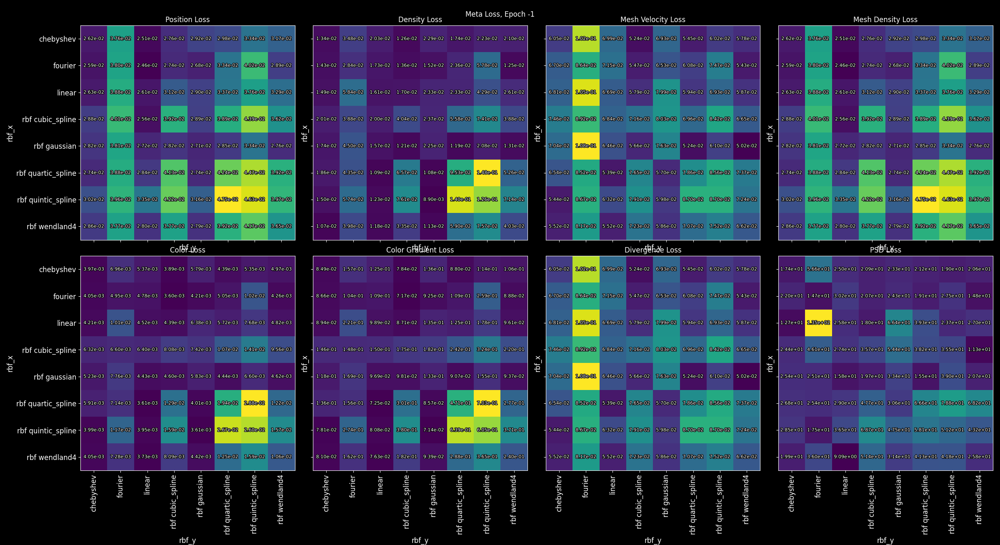

In [120]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm


# which_y = 'arch'
# which_x = 'n'
# which_z = 'frameDistance'

# xvars = []
# yvars = []
# zvars = []
# for s in subfolders:
#     xv = dataDict[s]['hyperParameters'][which_x]
#     if xv not in xvars:
#         xvars.append(xv)
#     yv = dataDict[s]['hyperParameters'][which_y]
#     if yv not in yvars:
#         yvars.append(yv)
#     zv = dataDict[s]['hyperParameters'][which_z]
#     if zv not in zvars:
#         zvars.append(zv)
# debugPrint(xvars)
# debugPrint(yvars)
# debugPrint(zvars)
# xvars.sort()
# yvars.sort()
# zvars.sort()
def lToMat(key):
    lMats = {}
    for z in zvars:
        lMats[z] = np.zeros((len(xvars), len(yvars)))
    losses = [[lDict[key] for lDict in overallDict[s]] for s in subfolders]
    # print(len(losses))
    for i, (l,s) in enumerate(zip(losses, subfolders)):
    #     print(i, l, s)
        xs = dataDict[s]['hyperParameters'][which_x]
    #         xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
        ys = dataDict[s]['hyperParameters'][which_y]
        zs = dataDict[s]['hyperParameters'][which_z]
    #     print(i, xs, ys, zs)
#         lMats[zs][xvars.index(xs), yvars.index(ys)] = l[-1]
        lMats[zs][xvars.index(xs), yvars.index(ys)] = np.median(l)
    # print(lMats['cartesian'])
    # for z in zvars:
    #     print(np.sum(lMats[z]))
    return lMats
# lMats = lToMat('position')

import matplotlib.patheffects as path_effects
txtLabels = []
def plotToAxis(axis, mat, bounds = None, label = None):
#     print(mat)
    if label is not None:
        axis.set_title(label)
    if bounds is None:
        im = axis.imshow(mat, vmin=mat[np.logical_not(np.isnan(mat))].min(), vmax=mat[np.logical_not(np.isnan(mat))].max())
#         im = axis.imshow(mat)
#         im = axis.imshow(mat, norm=colors.LogNorm(vmin=np.min(np.logical_not(np.isnan(mat))][0], vmax=bounds[1]))
    else:
        im = axis.imshow(mat, norm=colors.LogNorm(vmin=bounds[0], vmax=bounds[1]))
#         im = axis.imshow(mat, vmin=bounds[0], vmax=bounds[1])
    for (j,i),label in np.ndenumerate(mat):
        if not np.isnan(label):
            st = '%1.2e' % label
            txtLabels.append(axis.text(i,j,st,ha='center',va='center', color = 'white', fontsize=8, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])

    axis.set_yticks(np.arange(len(xvars)))
    axis.set_yticklabels(xvars, minor = False, rotation =0, fontsize = 12)
    axis.set_ylabel('%s' % which_x, fontsize = 12)
    axis.set_xlabel('%s' % which_y, fontsize = 12)
    axis.set_xticks(np.arange(len(yvars)))
    axis.set_xticklabels(yvars, minor = False, rotation =90, fontsize = 12)
    
    return im

def plot_funcMeta(epoch, shareCmap = True):
    global txtLabels
    for lbl in txtLabels:
        lbl.remove()
        
    fig.suptitle('Meta Loss, Epoch %d' % (epoch))
    for i in range(len(zvars)):
        for j, a in enumerate(axs[0,:]):
            a.cla()
#             a.set_title('%s = %s' %(which_y, yvars[j]))
#         axs[i][0,0].set_title('Mean Loss')
#         axs[i][0,1].set_title('Max Loss')
#         axs[i][0,2.set_title('Stddev Loss')
#     meanDict = {}
#     maxDict = {}
#     stdDict = {}
#     for i in range(len(zvars)):
#         meanDict[zvars[i]] = np.ones((len(xvars), len(yvars)))
#         maxDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
#         stdDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
    
#     for s in subfolders:
#         xs = dataDict[s]['hyperParameters'][which_x]
#         xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
#         ys = dataDict[s]['hyperParameters'][which_y]
#         zs = dataDict[s]['hyperParameters'][which_z]
#         print('xs:', xs, 'ys:', ys, 'zs:', zs)
#         meanDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,0])
#         maxDict[zs][xvars.index(xs), yvars.index(ys)] = np.max(losses[s][epoch,:,1])
#         stdDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,3])
#     print(meanDict)
#     minMaxMean = np.array([1e10,-1e10])
#     minMaxMax = np.array([1e10,-1e10])
#     minMaxStd = np.array([1e10,-1e10])
#     for i in range(len(zvars)):
#         minMaxMean[0] = min(minMaxMean[0], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
#         minMaxMean[1] = max(minMaxMean[1], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
#         minMaxMax[0] = min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
#         minMaxMax[1] = max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
#         minMaxStd[0] = min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxStd[1] = max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxMax  = (min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])), max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])))
#         minMaxStd  = (min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])),max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
        
#     print(minMaxMean)
#     print(minMaxMax)
#     print(minMaxStd)
    z = 'polar'
    if shareCmap:
        
#         for i in range(len(zvars)):
#             means = meanDict[zvars[i]]
    #         print(means, means.shape)
        plotToAxis(axs[0,0],lToMat('position')[z], label = 'Position Loss', bounds = minMaxMean)
#             plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss', bounds = minMaxMax)
#             plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss', bounds = minMaxStd)
    else:        
#         for i in range(len(zvars)):
#             means = meanDict[zvars[i]]
    #         print(means, means.shape)
        plotToAxis(axs[0,0],lToMat('position')[z], label = 'Position Loss')
        plotToAxis(axs[0,1],lToMat('density')[z], label = 'Density Loss')
        plotToAxis(axs[0,2],lToMat('meshVelocity')[z], label = 'Mesh Velocity Loss')
        plotToAxis(axs[0,3],lToMat('position')[z], label = 'Mesh Density Loss')
        plotToAxis(axs[1,0],lToMat('color')[z], label = 'Color Loss')
        plotToAxis(axs[1,1],lToMat('colorGrad')[z], label = 'Color Gradient Loss')
        plotToAxis(axs[1,2],lToMat('meshVelocity')[z], label = 'Divergence Loss')
        plotToAxis(axs[1,3],lToMat('psd')[z], label = 'PSD Loss')
#         plotToAxis(axs[0,0], meanDict['cartesian'], label = 'Mean Loss')
#         plotToAxis(axs[1,0], meanDict['cartesian'], label = 'Mean Loss')
#         print('...')
#             plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss')
#             plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss')
    fig.canvas.draw_idle()
    
fig, axs = plt.subplots(2, 4, figsize=(24,12*1.09), sharex = True, sharey = True, squeeze = False)

# fig = plt.figure(layout='constrained', figsize=(4 * 4, 4))
fig.suptitle('Mean Loss, Epoch %d' % -1)
# subfigs = fig.subfigures(len(zvars), 1, wspace=0.07, squeeze = False)

epoch = -1

# axs = []
# for i in range(len(zvars)):
#     subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
#     lax = subfigs[i,0].subplots(1, 3, sharey=True, squeeze = False)
#     axs.append(lax)    
    
plot_funcMeta(-1, shareCmap = False)
fig.tight_layout()
    
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,0].plot(x, [lDict['position'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,1].plot(x, [lDict['velocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,2].plot(x, [lDict['density'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,3].plot(x, [lDict['color'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,4].plot(x, [lDict['colorGrad'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,0].plot(x, [lDict['meshDensity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,1].plot(x, [lDict['meshVelocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,2].plot(x, [lDict['meshDivergence'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,3].plot(x, [lDict['psd'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,4].loglog(overallDict[s][-1]['kvals'], overallDict[s][-1]['Abins'],  label = labelDict[s], c = cols[selected.index(s) % len(cols)])

<IPython.core.display.Javascript object>


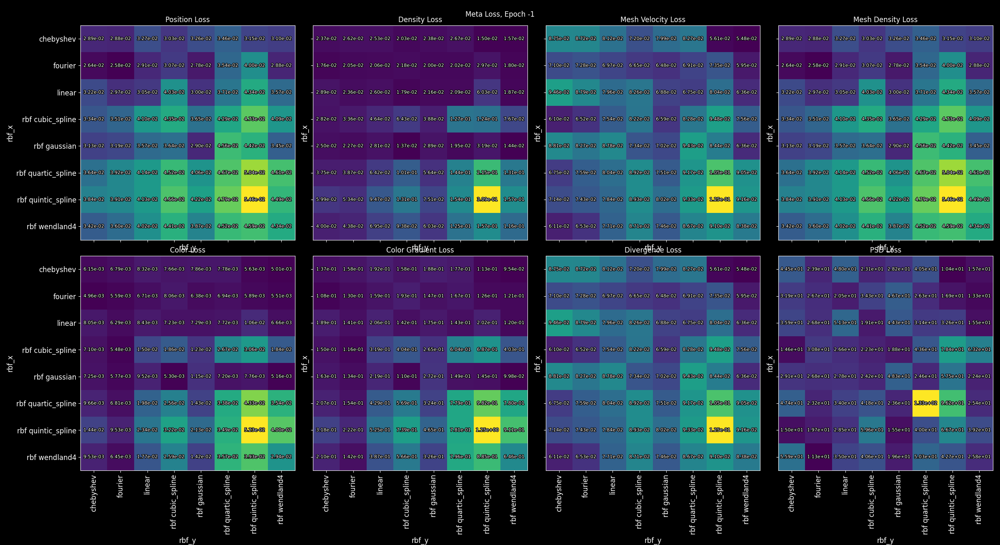

In [121]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook
from matplotlib import cm


# which_y = 'arch'
# which_x = 'n'
# which_z = 'frameDistance'

# xvars = []
# yvars = []
# zvars = []
# for s in subfolders:
#     xv = dataDict[s]['hyperParameters'][which_x]
#     if xv not in xvars:
#         xvars.append(xv)
#     yv = dataDict[s]['hyperParameters'][which_y]
#     if yv not in yvars:
#         yvars.append(yv)
#     zv = dataDict[s]['hyperParameters'][which_z]
#     if zv not in zvars:
#         zvars.append(zv)
# debugPrint(xvars)
# debugPrint(yvars)
# debugPrint(zvars)
# xvars.sort()
# yvars.sort()
# zvars.sort()
def lToMat(key):
    lMats = {}
    for z in zvars:
        lMats[z] = np.zeros((len(xvars), len(yvars)))
    losses = [[lDict[key] for lDict in overallDict[s]] for s in subfolders]
    # print(len(losses))
    for i, (l,s) in enumerate(zip(losses, subfolders)):
    #     print(i, l, s)
        xs = dataDict[s]['hyperParameters'][which_x]
    #         xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
        ys = dataDict[s]['hyperParameters'][which_y]
        zs = dataDict[s]['hyperParameters'][which_z]
    #     print(i, xs, ys, zs)
#         lMats[zs][xvars.index(xs), yvars.index(ys)] = l[-1]
        lMats[zs][xvars.index(xs), yvars.index(ys)] = np.median(l)
    # print(lMats['cartesian'])
    # for z in zvars:
    #     print(np.sum(lMats[z]))
    return lMats
# lMats = lToMat('position')

import matplotlib.patheffects as path_effects
txtLabels = []
def plotToAxis(axis, mat, bounds = None, label = None):
#     print(mat)
    if label is not None:
        axis.set_title(label)
    if bounds is None:
        im = axis.imshow(mat, vmin=mat[np.logical_not(np.isnan(mat))].min(), vmax=mat[np.logical_not(np.isnan(mat))].max())
#         im = axis.imshow(mat)
#         im = axis.imshow(mat, norm=colors.LogNorm(vmin=np.min(np.logical_not(np.isnan(mat))][0], vmax=bounds[1]))
    else:
        im = axis.imshow(mat, norm=colors.LogNorm(vmin=bounds[0], vmax=bounds[1]))
#         im = axis.imshow(mat, vmin=bounds[0], vmax=bounds[1])
    for (j,i),label in np.ndenumerate(mat):
        if not np.isnan(label):
            st = '%1.2e' % label
            txtLabels.append(axis.text(i,j,st,ha='center',va='center', color = 'white', fontsize=8, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])

    axis.set_yticks(np.arange(len(xvars)))
    axis.set_yticklabels(xvars, minor = False, rotation =0, fontsize = 12)
    axis.set_ylabel('%s' % which_x, fontsize = 12)
    axis.set_xlabel('%s' % which_y, fontsize = 12)
    axis.set_xticks(np.arange(len(yvars)))
    axis.set_xticklabels(yvars, minor = False, rotation =90, fontsize = 12)
    
    return im

def plot_funcMeta(epoch, shareCmap = True):
    global txtLabels
    for lbl in txtLabels:
        lbl.remove()
        
    fig.suptitle('Meta Loss, Epoch %d' % (epoch))
    for i in range(len(zvars)):
        for j, a in enumerate(axs[0,:]):
            a.cla()
#             a.set_title('%s = %s' %(which_y, yvars[j]))
#         axs[i][0,0].set_title('Mean Loss')
#         axs[i][0,1].set_title('Max Loss')
#         axs[i][0,2.set_title('Stddev Loss')
#     meanDict = {}
#     maxDict = {}
#     stdDict = {}
#     for i in range(len(zvars)):
#         meanDict[zvars[i]] = np.ones((len(xvars), len(yvars)))
#         maxDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
#         stdDict[zvars[i]] = np.zeros((len(xvars), len(yvars))) * np.nan
    
#     for s in subfolders:
#         xs = dataDict[s]['hyperParameters'][which_x]
#         xs = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']
#         ys = dataDict[s]['hyperParameters'][which_y]
#         zs = dataDict[s]['hyperParameters'][which_z]
#         print('xs:', xs, 'ys:', ys, 'zs:', zs)
#         meanDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,0])
#         maxDict[zs][xvars.index(xs), yvars.index(ys)] = np.max(losses[s][epoch,:,1])
#         stdDict[zs][xvars.index(xs), yvars.index(ys)] = np.mean(losses[s][epoch,:,3])
#     print(meanDict)
#     minMaxMean = np.array([1e10,-1e10])
#     minMaxMax = np.array([1e10,-1e10])
#     minMaxStd = np.array([1e10,-1e10])
#     for i in range(len(zvars)):
#         minMaxMean[0] = min(minMaxMean[0], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
#         minMaxMean[1] = max(minMaxMean[1], np.min(meanDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
#         minMaxMax[0] = min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
#         minMaxMax[1] = max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(maxDict[zvars[i]]))]))
#         minMaxStd[0] = min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxStd[1] = max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(stdDict[zvars[i]]))]))
#         minMaxMax  = (min(minMaxMax[0], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])), max(minMaxMax[1], np.min(maxDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])))
#         minMaxStd  = (min(minMaxStd[0], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))])),max(minMaxStd[1], np.min(stdDict[zvars[i]][np.logical_not(np.isnan(meanDict[zvars[i]]))]))
        
#     print(minMaxMean)
#     print(minMaxMax)
#     print(minMaxStd)
    z = 'preserving'
    if shareCmap:
        
#         for i in range(len(zvars)):
#             means = meanDict[zvars[i]]
    #         print(means, means.shape)
        plotToAxis(axs[0,0],lToMat('position')[z], label = 'Position Loss', bounds = minMaxMean)
#             plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss', bounds = minMaxMax)
#             plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss', bounds = minMaxStd)
    else:        
#         for i in range(len(zvars)):
#             means = meanDict[zvars[i]]
    #         print(means, means.shape)
        plotToAxis(axs[0,0],lToMat('position')[z], label = 'Position Loss')
        plotToAxis(axs[0,1],lToMat('density')[z], label = 'Density Loss')
        plotToAxis(axs[0,2],lToMat('meshVelocity')[z], label = 'Mesh Velocity Loss')
        plotToAxis(axs[0,3],lToMat('position')[z], label = 'Mesh Density Loss')
        plotToAxis(axs[1,0],lToMat('color')[z], label = 'Color Loss')
        plotToAxis(axs[1,1],lToMat('colorGrad')[z], label = 'Color Gradient Loss')
        plotToAxis(axs[1,2],lToMat('meshVelocity')[z], label = 'Divergence Loss')
        plotToAxis(axs[1,3],lToMat('psd')[z], label = 'PSD Loss')
#         plotToAxis(axs[0,0], meanDict['cartesian'], label = 'Mean Loss')
#         plotToAxis(axs[1,0], meanDict['cartesian'], label = 'Mean Loss')
#         print('...')
#             plotToAxis(axs[i][0,1], maxDict[zvars[i]], label = 'Max Loss')
#             plotToAxis(axs[i][0,2], stdDict[zvars[i]], label = 'Std Loss')
    fig.canvas.draw_idle()
    
fig, axs = plt.subplots(2, 4, figsize=(24,12*1.09), sharex = True, sharey = True, squeeze = False)

# fig = plt.figure(layout='constrained', figsize=(4 * 4, 4))
fig.suptitle('Mean Loss, Epoch %d' % -1)
# subfigs = fig.subfigures(len(zvars), 1, wspace=0.07, squeeze = False)

epoch = -1

# axs = []
# for i in range(len(zvars)):
#     subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
#     lax = subfigs[i,0].subplots(1, 3, sharey=True, squeeze = False)
#     axs.append(lax)    
    
plot_funcMeta(-1, shareCmap = False)
fig.tight_layout()
    
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,0].plot(x, [lDict['position'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,1].plot(x, [lDict['velocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,2].plot(x, [lDict['density'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,3].plot(x, [lDict['color'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][0,4].plot(x, [lDict['colorGrad'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,0].plot(x, [lDict['meshDensity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,1].plot(x, [lDict['meshVelocity'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,2].plot(x, [lDict['meshDivergence'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,3].plot(x, [lDict['psd'] for lDict in overallDict[s]], label = labelDict[s], c = cols[selected.index(s) % len(cols)])
#     axs[xvars.index(dataDict[s]['hyperParameters'][which_x])][1,4].loglog(overallDict[s][-1]['kvals'], overallDict[s][-1]['Abins'],  label = labelDict[s], c = cols[selected.index(s) % len(cols)])

<IPython.core.display.Javascript object>


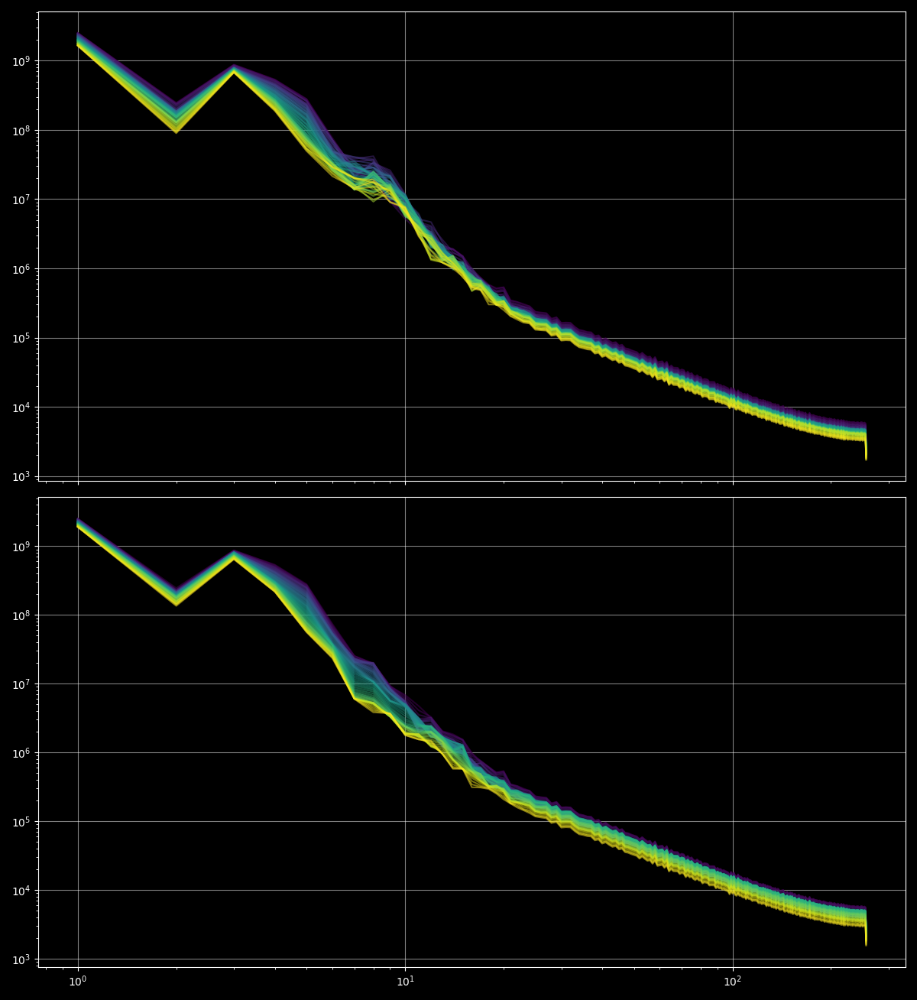

In [309]:

fig, axis = plt.subplots(2, 1, figsize=(12,12*1.09), sharex = True, sharey = False, squeeze = False)

cm = mpl.colormaps['viridis']

for i in range(unrollSteps):
    axis[0,0].loglog(overallDict[s][i]['kvals'], overallDict[s][i]['Abins'], label = 'pred', c = cm(i / (unrollSteps - 1)), alpha = 0.5)
    axis[1,0].loglog(overallDict[s][i]['kvals'], overallDict[s][i]['gtAbins'], label = 'pred', c = cm(i / (unrollSteps - 1)), alpha = 0.5)
    
    axis[0,0].grid(which = 'major',visible = True, axis = 'both', alpha = 0.5)
    axis[1,0].grid(which = 'major',visible = True, axis = 'both', alpha = 0.5)
    
fig.tight_layout()

In [141]:
positionLossTerm = torch.mean(positionLoss)
velocityLossTerm = torch.mean(velocityLoss)
densityLossTerm = torch.mean(torch.abs(density - gtDensity))
colorFieldLossTerm = torch.mean(torch.abs(colorField - gtColorField))
colorGradLossTerm = torch.mean(torch.linalg.norm(colorGrad - gtColorGrad,dim=1))

meshDensityLossTerm = torch.mean(torch.abs(meshDensity - gtMeshDensity))
meshVelocityLossTerm = torch.mean(torch.abs(meshVelocity - gtMeshVelocity))
meshDivergenceLossTerm = torch.mean(torch.abs(meshDivergence - gtMeshDivergence))

psdLossTerm = np.sum(np.log10(Abins) - np.log10(gtAbins))

In [142]:
debugPrint(positionLossTerm)
debugPrint(velocityLossTerm)
debugPrint(densityLossTerm)
debugPrint(colorFieldLossTerm)
debugPrint(colorGradLossTerm)

debugPrint(meshDensityLossTerm)
debugPrint(meshVelocityLossTerm)
debugPrint(meshDivergenceLossTerm)

debugPrint(psdLossTerm)

positionLossTerm [Tensor] = 0.036061275750398636
velocityLossTerm [Tensor] = 0.18331050872802734
densityLossTerm [Tensor] = 0.022173237055540085
colorFieldLossTerm [Tensor] = 0.005944413132965565
colorGradLossTerm [Tensor] = 0.13910959661006927
meshDensityLossTerm [Tensor] = 0.024325717240571976
meshVelocityLossTerm [Tensor] = 0.08270946890115738
meshDivergenceLossTerm [Tensor] = 1.8934519290924072
psdLossTerm [float64] = 269.6499277889957


In [134]:
debugPrint(positionLossTerm)
debugPrint(velocityLossTerm)
debugPrint(densityLossTerm)
debugPrint(colorFieldLossTerm)
debugPrint(colorGradLossTerm)

debugPrint(meshDensityLossTerm)
debugPrint(meshVelocityLossTerm)
debugPrint(meshDivergenceLossTerm)

debugPrint(psdLossTerm)

positionLossTerm [Tensor] = 0.03606116771697998
velocityLossTerm [Tensor] = 0.1833099126815796
densityLossTerm [Tensor] = 0.022173158824443817
colorFieldLossTerm [Tensor] = 0.005944404751062393
colorGradLossTerm [Tensor] = 0.13911107182502747
meshDensityLossTerm [Tensor] = 0.024325484409928322
meshVelocityLossTerm [Tensor] = 0.08271002024412155
meshDivergenceLossTerm [Tensor] = 1.8934574127197266
psdLossTerm [float64] = 264.92820115917056


<IPython.core.display.Javascript object>


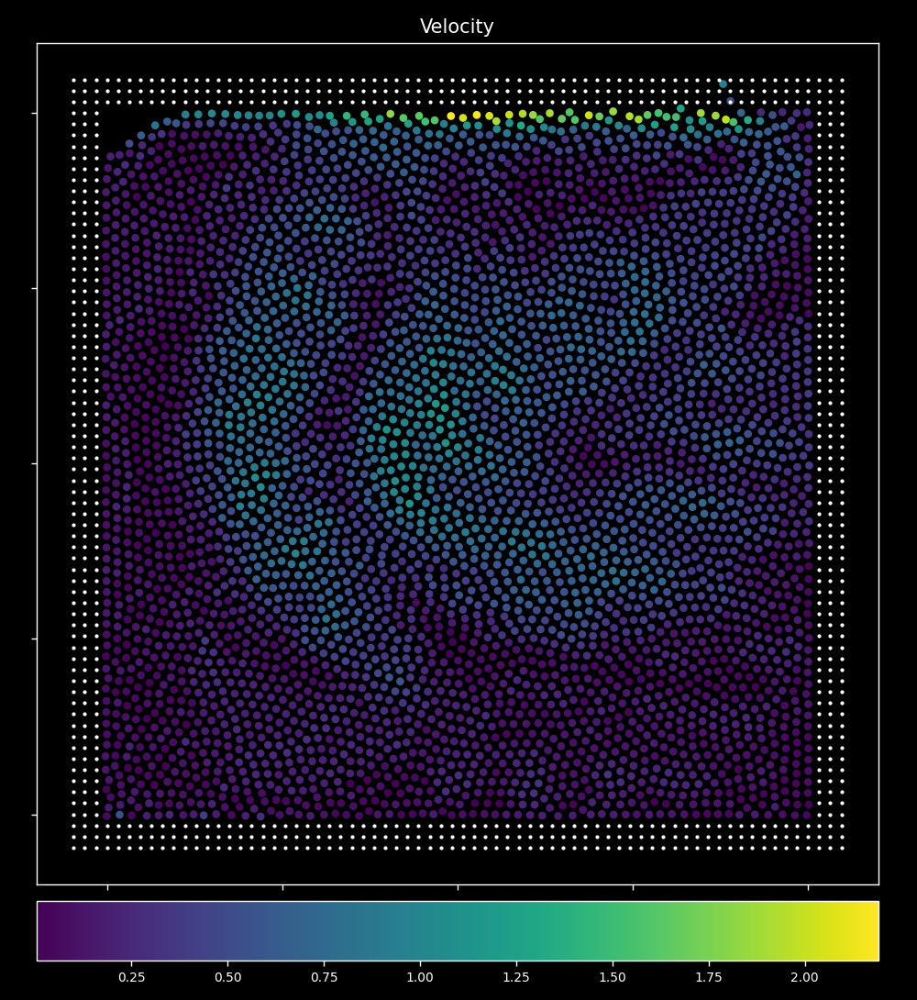

 34%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                                                                                                                                                                                                                                                                                                                                              | 43/128 [00:22<00:44,  1.89it/s]


KeyboardInterrupt: 

In [52]:
attributes, inputData, groundTruths = loadFrame(simulationFiles[0], 1024, 1 + np.arange(128), hyperParams['frameDistance'])
# attributes['support'] = 0.01 /4 * 4.5 
fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)

fluidFeatures = fluidFeatures.to(device)

model, hyperParams = loadRbfModel(simulationFiles[0], 0, subfolders[1], -1)

predictedPositions = fluidPositions.to(device)
predictedVelocity = inputData['fluidVelocity'].to(device)

gravity = inputData['fluidGravity'][:,:2].to(device) #torch.zeros_like(predictedVelocity)
# debugPrint(gravity.shape)
# gravity[:,1] = -9.81

# print(hyperParams['frameDistance'])


x = predictedPositions[:,0].detach().cpu().numpy()
y = predictedPositions[:,1].detach().cpu().numpy()

# v = (gt[:,-1:] - modelOutput) ** 2
v = torch.linalg.norm(predictedVelocity,dim=1)

fig, axis = plt.subplots(1, 1, figsize=(8,8*1.09), sharex = False, sharey = False, squeeze = False)

axis[0,0].set_title('Velocity')
# sc = axis[1,0].scatter(x,y,c = v,s=0.25)
GTsc = axis[0,0].scatter(x,y,c = v.detach().cpu().numpy(), s= 16)
axis[0,0].axis('equal')
axis[0,0].set_xlim(-1.2,1.2)
axis[0,0].set_ylim(-1.2,1.2)
# axis[0,1].axvline(-2)
# axis[0,1].axvline(2)
# axis[0,1].axhline(-2)
# axis[0,1].axhline(2)
axis[0,0].scatter(inputData['boundaryPosition'][:,0], inputData['boundaryPosition'][:,1], c = 'white', s =2 )
axis[0,0].set_xticklabels([])
axis[0,0].set_yticklabels([])
ax1_divider = make_axes_locatable(axis[0,0])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
GTcbar = fig.colorbar(GTsc, cax=cax1,orientation='horizontal')
GTcbar.ax.tick_params(labelsize=8) 
fig.tight_layout()

# inFile = h5py.File(file, 'r')
# frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
# inFile.close()

label = 'unrollTest spline x spline network'
imageFolder = '../images/%s/' % label
#     print(imageFolder)
#     break

if not os.path.exists(imageFolder):
    os.makedirs(imageFolder)
#     for i in tqdm(range(0, frameCount, 8), leave = False):
#         plotNetwork(simulationFile, i)

losses = []
with torch.no_grad():
    for i in tqdm(range(128)):
        loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[i], model, None, None, True)
        
#         predictedPositions = groundTruths[i][:,:2].to(device)
#         loss = torch.linalg.norm(predictedVelocity - groundTruths[i][:,2:4].to(device), dim = 1)
        losses.append(torch.mean(loss).detach().cpu().numpy())
        
        
        data = torch.linalg.norm(predictedVelocity,dim=1).detach().cpu().numpy()
        GTsc.set_offsets(predictedPositions.detach().cpu().numpy())
        GTsc.set_array(data)
        GTcbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))
        fig.canvas.draw()
        fig.canvas.flush_events()
        imagePath = '../images/%s/%04d.png' % (label, i)
        plt.savefig(imagePath, dpi = 200)

    losses = np.hstack(losses)

loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[1], model, None, None, True)
print(torch.mean(loss))
print(losses)

In [182]:
def evalNetwork(sim, initialframe, rollout, modelpath, modelepoch):    
    model, hyperParams = loadRbfModel(sim, initialframe, modelpath, modelepoch)
    model.train(False)
    model.eval()
    with torch.no_grad():
        attributes, inputData, groundTruths = loadFrame(sim, initialframe, 1 + np.arange(rollout) / hyperParams['frameDistance'], hyperParams['frameDistance'])
        fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
        fluidFeatures = fluidFeatures.to(device)

        predictedPositions = fluidPositions.to(device)
        predictedVelocity = inputData['fluidVelocity'].to(device)
        predictedPositions.requires_grad = False
        predictedVelocity.requires_grad = False
        fluidFeatures.requires_grad = False

        gravity = inputData['fluidGravity'][:,:2].to(device) #torch.zeros_like(predictedVelocity)
        losses = []
        running = True
        t = tqdm(range(rollout // hyperParams['frameDistance']), leave = False)
        for i in t:
            
            if not running:
                losses.append(1)
                continue
            loss, predictedPositions, predictedVelocity = runNetwork(predictedPositions, predictedVelocity, attributes, hyperParams['frameDistance'], gravity, fluidFeatures, boundaryPositions.to(device), boundaryFeatures.to(device), groundTruths[i], model, None, None, True)
#             print(loss)
#             predictedPositions = groundTruths[i][:,:2].to(device)
#             loss = torch.linalg.norm(predictedVelocity - groundTruths[i][:,2:4].to(device), dim = 1)

            l = torch.mean(loss).detach().cpu().numpy()
            losses.append(l)
            if l > 1.0:
                running = False
            t.set_description('%s: %s - %s: %s - %s: %s : Loss: %g running %d ' % (which_x, str(hyperParams[which_x]), which_y, str(hyperParams[which_y]),which_z, str(hyperParams[which_z]),   l, 1 if running else 0))
    return np.hstack(losses)


# losses = evalNetwork(simulationFiles[0], 0, 32, subfolders[0], -1)
# losses = evalNetwork(simulationFiles[0], 1600, 32, subfolders[0], -1)
# print(losses)


In [183]:
from tqdm.notebook import tqdm

In [184]:
# trainFolder = '/mnt/c/Users/Rimuru/trainingData'
# trainFolder = '~/trainingdata_2D_deltaSPH_001'
# trainFolder = '~/servus05/dev/torchSPH2/Cconv/trainingData'
trainFolder = os.path.expanduser(trainFolder)
subfolders = [ f.path for f in os.scandir(trainFolder) if f.is_dir() ]
# subfolders = [ f.path for f in os.scandir('./trainingDataBasisFunctions8x8') if f.is_dir() ]
print(len(subfolders))

subfolders = [s for s in subfolders if os.path.exists(s + '/results.json')]
print(len(subfolders))

dataDict = {}

subfolders[0]
for s in tqdm(subfolders):
    with open("%s/results.json" % s, "r") as read_file:
        decodedArray = json.load(read_file)
        dataDict[s] = decodedArray
#         print(decodedArray['hyperParameters'])   

15
15


  0%|          | 0/15 [00:00<?, ?it/s]

In [190]:

simulation = simulationFiles[0]
initialFrame = 1024
unrollSteps = 2048

In [191]:
# evalNetwork(simulation, initialFrame, 128, '/home/winchenbach/trainingdata_2D_deltaSPH_001/generative2D - n=[ 2, 2] rbf=[linear,linear] map = preserving window = poly6 d =  1 e = 10 arch 4 8 8 3 distance =  1 - 2023-03-14_10-10-45',-1)
# del losses

In [192]:
print(torch.max(model.ni))

AttributeError: 'RbfNet' object has no attribute 'ni'

In [234]:
unrollDict = {}

for s in tqdm(subfolders):
    losses = evalNetwork(simulation, initialFrame, unrollSteps, s, -1)
    unrollDict[s] = losses

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

  0%|          | 0/128 [00:00<?, ?it/s]

xvars [list] = ['64 32 16 8 4 2 1 2 4 8 16 32 64 3', '2 4 8 16 32 64 64 32 16 8 4 3', '32 64 64 3', '96 32 32 3', '4 8 16 32 64 128 3', '64 44 32 16 8 3', '32 32 32 32 32 32 32 32 32 3']
yvars [list] = ['polar']
zvars [list] = [16]


<IPython.core.display.Javascript object>


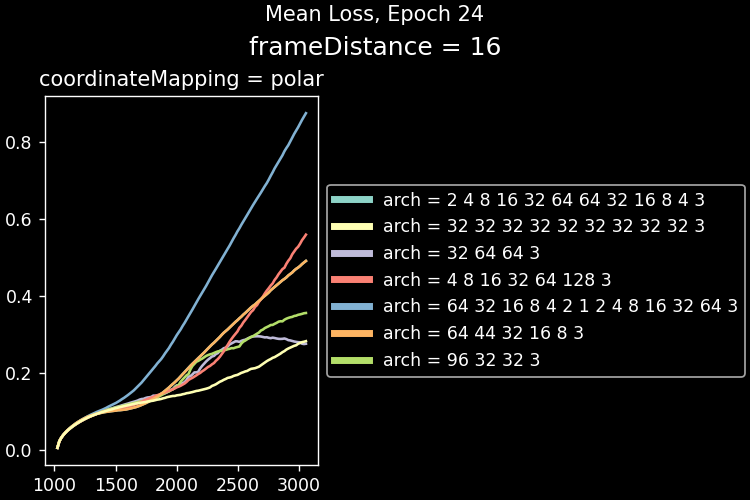

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

<function __main__.<lambda>(epoch)>

In [238]:
which_x = 'arch'
which_y = 'coordinateMapping'
which_z = 'frameDistance'
# which_x = 'arch'
# which_y = 'n'
# which_z = 'frameDistance'

xvars = []
yvars = []
zvars = []
for s in subfolders:
    xv = dataDict[s]['hyperParameters'][which_x]
#     xv = dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y']

    if xv not in xvars:
        xvars.append(xv)
    yv = dataDict[s]['hyperParameters'][which_y]
    if yv not in yvars:
        yvars.append(yv)
    zv = dataDict[s]['hyperParameters'][which_z]
    if zv not in zvars:
        zvars.append(zv)
debugPrint(xvars)
debugPrint(yvars)
debugPrint(zvars)
xvars.sort()
yvars.sort()
zvars.sort()

from matplotlib.lines import Line2D
cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
legend_elements = [Line2D([0], [0], color=cols[xvars.index(x) % len(cols)], lw=4, label='%s = %s' % (which_x, x)) for x in xvars]

def plot_func(epoch, index, label):
    fig.suptitle('%s Loss, Epoch %d' % (label, epoch))
    for i in range(len(zvars)):
        for j, a in enumerate(axs[i][0,:]):
            a.cla()
            a.set_title('%s = %s' %(which_y, yvars[j]))

    for s in subfolders:
#         c = xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])
        c = xvars.index(dataDict[s]['hyperParameters'][which_x])
        r = yvars.index(dataDict[s]['hyperParameters'][which_y])
        d = zvars.index(dataDict[s]['hyperParameters'][which_z])
#         axs[d][0,r].plot(np.arange(initialFrame, initialFrame + unrollSteps * dataDict[s]['hyperParameters']['frameDistance'], dataDict[s]['hyperParameters']['frameDistance']), unrollDict[s], c = cols[c % len(cols)])
        axs[d][0,r].plot(initialFrame + np.arange(len(unrollDict[s])) * dataDict[s]['hyperParameters']['frameDistance'], unrollDict[s], c = cols[c % len(cols)])
#         axs[d][0,r].set_yscale('log')
        
#         sns.kdeplot(losses[s][epoch,:,index], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)], ax = axs[d][0,r])

    for i in range(len(zvars)):
        axs[i][0,-1].legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))

    minx = 1e10
    maxx = -1e10
    for i in range(len(zvars)):
        for y in range(len(yvars)):
            xmin, xmax = axs[i][0,y].get_xlim()
            if xmin == 0. and xmax == 1.:
                axs[i][0,y].set_xscale('log')
                continue
            minx = min(xmin, minx)
            maxx = max(xmax, maxx)

    for i in range(len(zvars)):
        for y in range(len(yvars)):
            axs[i][0,y].set_xlim(minx, maxx)

    for i in range(len(zvars) - 1):
        for y in range(len(yvars)):
            axs[i][0,y].set_xticklabels([])
        
    fig.canvas.draw_idle()
    
fig = plt.figure(layout='constrained', figsize=(4 * len(yvars) + 2, 4 * len(zvars)))
fig.suptitle('Mean Loss, Epoch %d' % -1)
subfigs = fig.subfigures(len(zvars), 1, wspace=0.07, squeeze = False)

epoch = -1

axs = []
for i in range(len(zvars)):
    subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
    lax = subfigs[i,0].subplots(1, len(yvars), sharey=True, squeeze = False)
    axs.append(lax)    
    

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(lambda epoch: plot_func(epoch, 0, 'Mean'), epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

In [152]:
from tqdm.notebook import tqdm

In [153]:
unrollDict = {}

for s in tqdm(subfolders):
    sims = {}
    for simulation in tqdm(simulationFiles, leave = False):
        sims[simulation] = evalNetwork(simulation, initialFrame, unrollSteps, s, -1)
    unrollDict[s] = sims

  0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/36 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

In [71]:
# print(len(simulationFiles))

36


In [118]:
indexDict = {}
for i in range(6):
    for j in range(6):
        indexDict[simulationFiles[i * 6 + j]] = (i, j)

In [119]:
# print(indexDict)

<IPython.core.display.Javascript object>


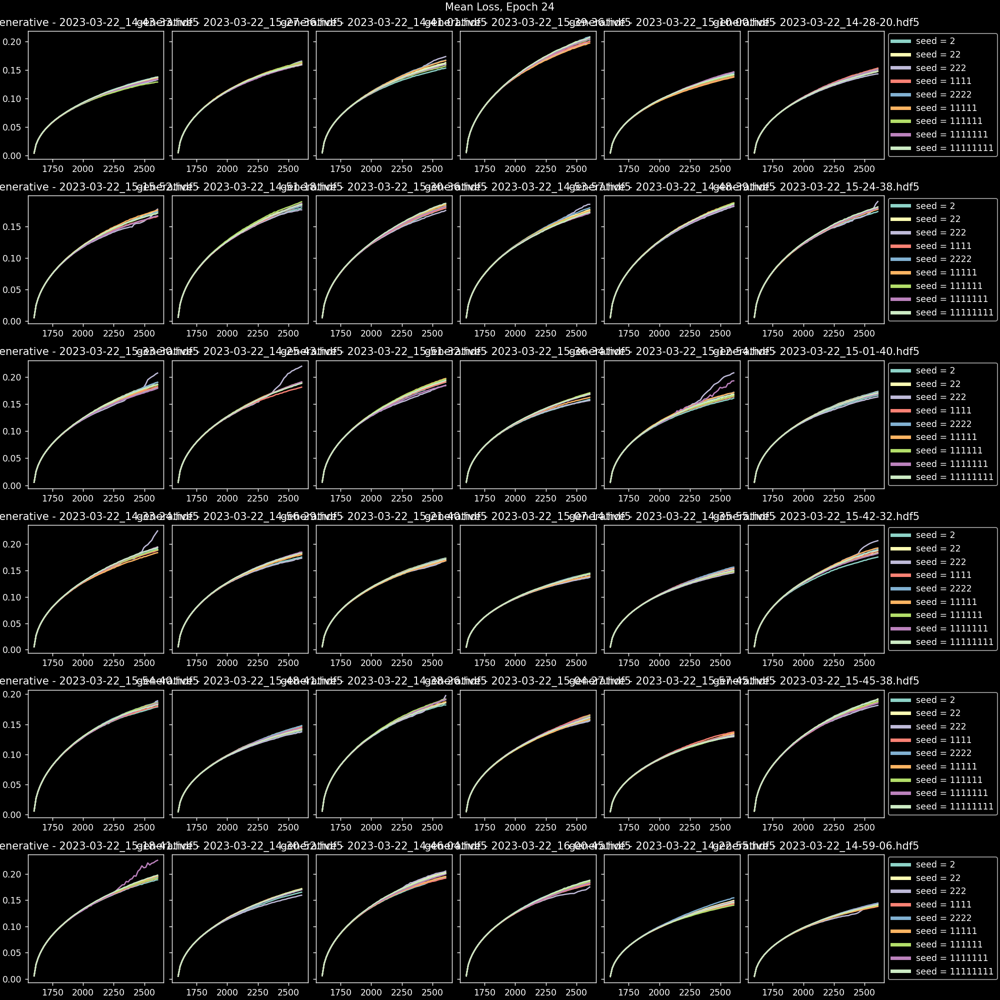

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

<function __main__.<lambda>(epoch)>

In [120]:

from matplotlib.lines import Line2D
cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
legend_elements = [Line2D([0], [0], color=cols[xvars.index(x) % len(cols)], lw=4, label='%s = %s' % (which_x, x)) for x in xvars]

def plot_stacked_func(epoch, index, label):
    fig.suptitle('%s Loss, Epoch %d' % (label, epoch))
    for i in range(6):
        for j, a in enumerate(axs[i][0,:]):
            a.cla()
    for s in simulationFiles:
        x,y = indexDict[s]
#         print(x,y)
        axs[x][0,y].set_title(s.split('/')[-1])
#         print(x,y,s)
#             a.set_title('%s = %s' %(which_y, yvars[j]))

    for c, s in enumerate(subfolders):
#         for e in tqdm(range(dataDict[s]['hyperParameters']['epochs']), leave=False):
#         c = yvars.index(dataDict[s]['hyperParameters'][which_x])
        for sim in simulationFiles:
            if sim in indexDict:
                x,y = indexDict[sim]
                if s in unrollDict:
                    axs[x][0,y].plot(initialFrame + np.arange(len(unrollDict[s][sim])) * dataDict[s]['hyperParameters']['frameDistance'], unrollDict[s][sim], c = cols[c % len(subfolders)])

#         c = xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])
#         r = yvars.index(dataDict[s]['hyperParameters'][which_y])
#         d = zvars.index(dataDict[s]['hyperParameters'][which_z])
#         axs[d][0,r].plot(np.arange(initialFrame, initialFrame + unrollSteps * dataDict[s]['hyperParameters']['frameDistance'], dataDict[s]['hyperParameters']['frameDistance']), unrollDict[s], c = cols[c % len(cols)])
#         axs[0][0,0].plot(initialFrame + np.arange(len(unrollDict[s])) * dataDict[s]['hyperParameters']['frameDistance'], unrollDict[s], c = cm.viridis(c/len(subfolders)))
#         axs[d][0,r].set_yscale('log')
        
#         sns.kdeplot(losses[s][epoch,:,index], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)], ax = axs[d][0,r])

    for s in simulationFiles:
        x,y = indexDict[s]
        
        axs[y][0,-1].legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))

#     minx = 1e10
#     maxx = -1e10
#     for i in range(len(zvars)):
#         for y in range(len(yvars)):
#             xmin, xmax = axs[i][0,y].get_xlim()
#             if xmin == 0. and xmax == 1.:
#                 axs[i][0,y].set_xscale('log')
#                 continue
#             minx = min(xmin, minx)
#             maxx = max(xmax, maxx)

#     for i in range(len(zvars)):
#         for y in range(len(yvars)):
#             axs[i][0,y].set_xlim(minx, maxx)

#     for i in range(len(zvars) - 1):
#         for y in range(len(yvars)):
#             axs[i][0,y].set_xticklabels([])
        
    fig.canvas.draw_idle()
    
fig = plt.figure(layout='constrained', figsize=(16,16))
# fig.suptitle('Mean Loss, Epoch %d' % -1)
subfigs = fig.subfigures(6, 1, wspace=0.07, squeeze = False)

epoch = -1

axs = []
for i in range(6):
#     subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
    lax = subfigs[i,0].subplots(1, 6, sharey=True, squeeze = False)
    axs.append(lax)    
    

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(lambda epoch: plot_stacked_func(epoch, 0, 'Mean'), epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

In [86]:
unrollDict = {}

for s in tqdm(subfolders):
    epochs = {}
    for e in tqdm(range(dataDict[s]['hyperParameters']['epochs']), leave=False):
        sims = {}
        for simulation in tqdm(simulationFiles, leave = False):
            sims[simulation] = evalNetwork(simulation, initialFrame, unrollSteps, s, e)
        epochs[e] = sims
    unrollDict[s] = epochs

  0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/16 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

  0%|          | 0/64 [00:00<?, ?it/s]

In [47]:
indexDict = {}
for i in range(4):
    for j in range(4):
        indexDict[simulationFiles[i * 4 + j]] = (i, j)

<IPython.core.display.Javascript object>


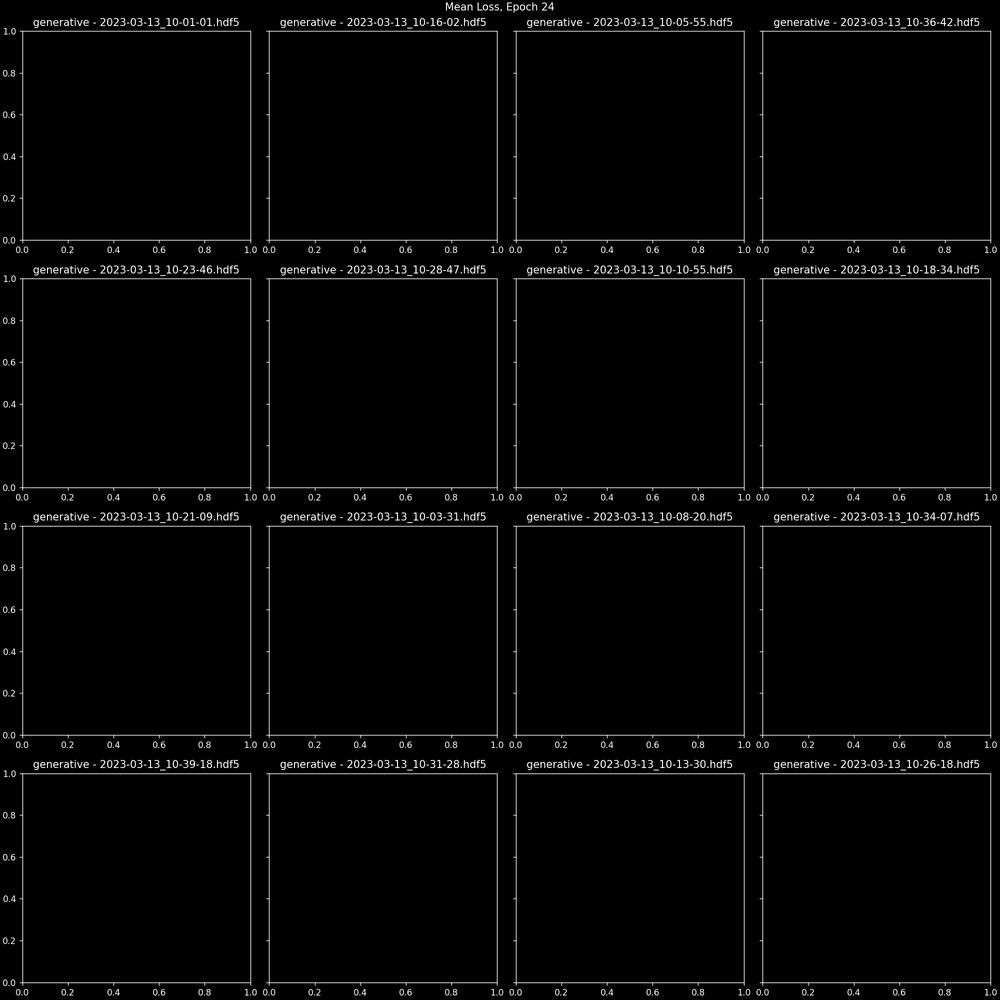

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

<function __main__.<lambda>(epoch)>

In [48]:

def plot_stacked_func(epoch, index, label):
    fig.suptitle('%s Loss, Epoch %d' % (label, epoch))
    for i in range(4):
        for j, a in enumerate(axs[i][0,:]):
            a.cla()
    for s in simulationFiles:
        x,y = indexDict[s]
        axs[x][0,y].set_title(s.split('/')[-1])
#         print(x,y,s)
#             a.set_title('%s = %s' %(which_y, yvars[j]))

    for c, s in enumerate(subfolders):
        for e in tqdm(range(dataDict[s]['hyperParameters']['epochs']), leave=False):
            for sim in simulationFiles:
                if sim in indexDict:
                    x,y = indexDict[sim]
                    if s in unrollDict:
                        axs[x][0,y].plot(initialFrame + np.arange(len(unrollDict[s][e][sim])) * dataDict[s]['hyperParameters']['frameDistance'], unrollDict[s][e][sim], c = cm.viridis(e/(epochs - 1)))

#         c = xvars.index(dataDict[s]['hyperParameters']['rbf_x'] + ' x ' + dataDict[s]['hyperParameters']['rbf_y'])
#         r = yvars.index(dataDict[s]['hyperParameters'][which_y])
#         d = zvars.index(dataDict[s]['hyperParameters'][which_z])
#         axs[d][0,r].plot(np.arange(initialFrame, initialFrame + unrollSteps * dataDict[s]['hyperParameters']['frameDistance'], dataDict[s]['hyperParameters']['frameDistance']), unrollDict[s], c = cols[c % len(cols)])
#         axs[0][0,0].plot(initialFrame + np.arange(len(unrollDict[s])) * dataDict[s]['hyperParameters']['frameDistance'], unrollDict[s], c = cm.viridis(c/len(subfolders)))
#         axs[d][0,r].set_yscale('log')
        
#         sns.kdeplot(losses[s][epoch,:,index], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)], ax = axs[d][0,r])

#     for i in range(len(zvars)):
#         axs[i][0,-1].legend(handles=legend_elements, loc='center left', bbox_to_anchor=(1, 0.5))

#     minx = 1e10
#     maxx = -1e10
#     for i in range(len(zvars)):
#         for y in range(len(yvars)):
#             xmin, xmax = axs[i][0,y].get_xlim()
#             if xmin == 0. and xmax == 1.:
#                 axs[i][0,y].set_xscale('log')
#                 continue
#             minx = min(xmin, minx)
#             maxx = max(xmax, maxx)

#     for i in range(len(zvars)):
#         for y in range(len(yvars)):
#             axs[i][0,y].set_xlim(minx, maxx)

#     for i in range(len(zvars) - 1):
#         for y in range(len(yvars)):
#             axs[i][0,y].set_xticklabels([])
        
    fig.canvas.draw_idle()
    
fig = plt.figure(layout='constrained', figsize=(16,16))
# fig.suptitle('Mean Loss, Epoch %d' % -1)
subfigs = fig.subfigures(4, 1, wspace=0.07, squeeze = False)

epoch = -1

axs = []
for i in range(4):
#     subfigs[i,0].suptitle('%s = %s' % (which_z, zvars[i]), fontsize='x-large')
    lax = subfigs[i,0].subplots(1, 4, sharey=True, squeeze = False)
    axs.append(lax)    
    

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(lambda epoch: plot_stacked_func(epoch, 0, 'Mean'), epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

<IPython.core.display.Javascript object>


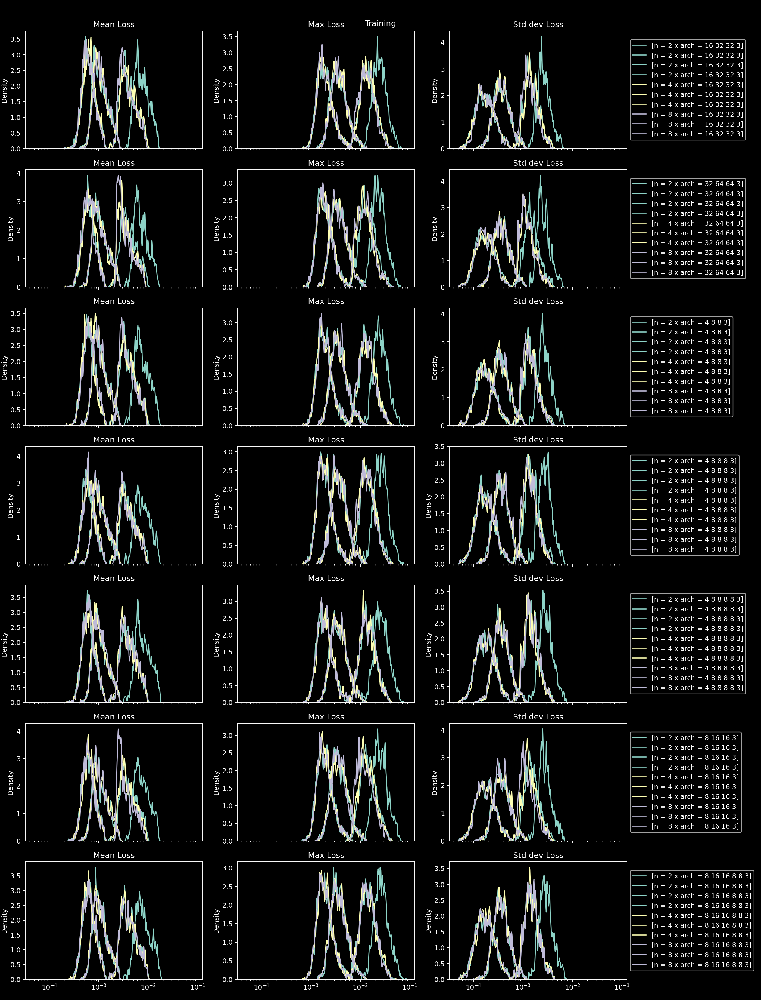

/home/winchenbach/anaconda3/envs/torch_env/lib/python3.9/site-packages/ipykernel/pylab/backend_inline.py:10: DeprecationWarning: `ipykernel.pylab.backend_inline` is deprecated, directly use `matplotlib_inline.backend_inline`
  warnings.warn(


interactive(children=(IntSlider(value=9, description='epoch', max=9), Output()), _dom_classes=('widget-interac…

In [18]:
trainingEpochLosses = trainingLosses[subfolders[0]]
fig, axis = plt.subplots(len(yvars), 3, figsize=(16,3 * len(yvars)), sharex = True, sharey = False, squeeze = False)

# for y in yvars:
fig.suptitle('Training')

losses = {}
for s in subfolders:
    trainingEpochLosses = trainingLosses[s]
    overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])
    losses[s] = overallLosses

epoch = -1

def plot_func(epoch):    
    plt.sca(axis[0,0])
    for i in range(len(yvars)):
        for j in range(3):        
            axis[i,j].cla()
#             plt.sca(axis[i,j])
        axis[i,0].set_title('Mean Loss')
        axis[i,1].set_title('Max Loss')
        axis[i,2].set_title('Std dev Loss')

    cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
    for s in subfolders:
        c = xvars.index(dataDict[s]['hyperParameters'][which_x])
        r = yvars.index(dataDict[s]['hyperParameters'][which_y])
        plt.sca(axis[r,0])
        sns.kdeplot(losses[s][epoch,:,0], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)])
        plt.sca(axis[r,1])
        sns.kdeplot(losses[s][epoch,:,1], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)])
        plt.sca(axis[r,2])
        sns.kdeplot(losses[s][epoch,:,3], bw_adjust=.2, log_scale=True, label = '[%s = %s x %s = %s]' % (which_x, dataDict[s]['hyperParameters'][which_x], which_y, dataDict[s]['hyperParameters'][which_y]), c = cols[c % len(cols)])
        axis[r,2].legend(loc='center left', bbox_to_anchor=(1, 0.5))

    for c in range(len(yvars)):
        handles, labels = axis[c,2].get_legend_handles_labels()
        labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
        axis[c,2].legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5))

    fig.canvas.draw_idle()

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(plot_func, epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

fig.tight_layout()


<IPython.core.display.Javascript object>


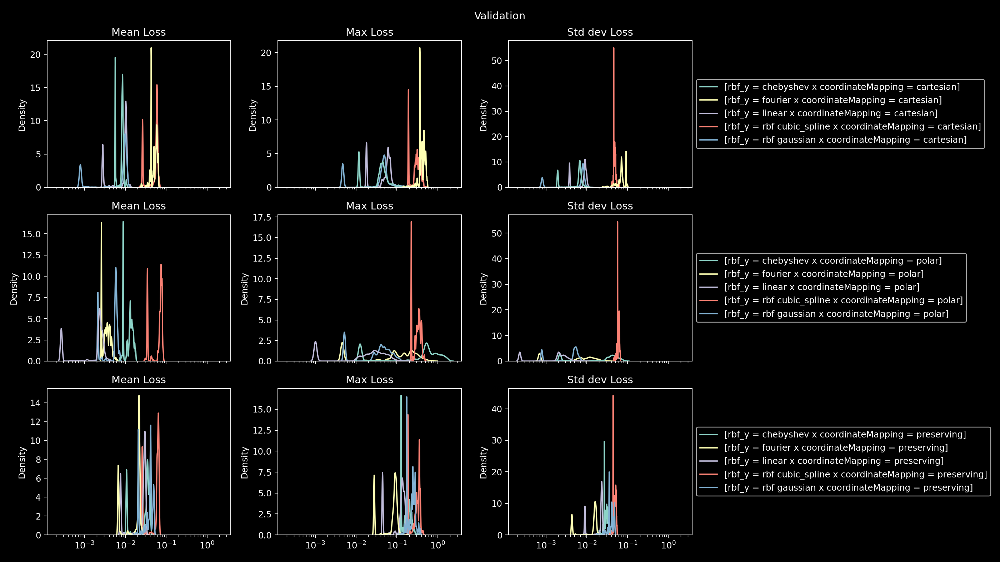

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

In [124]:
trainingEpochLosses = trainingLosses[subfolders[0]]
fig, axis = plt.subplots(len(yvars), 3, figsize=(16,3 * len(yvars)), sharex = True, sharey = False, squeeze = False)

# for y in yvars:
fig.suptitle('Validation')

losses = {}
for s in subfolders:
    trainingEpochLosses = validationLosses[s]
    overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])
    losses[s] = overallLosses

epoch = -1

def plot_func(epoch):    
    plt.sca(axis[0,0])
    for i in range(len(yvars)):
        for j in range(3):        
            axis[i,j].cla()
#             plt.sca(axis[i,j])
        axis[i,0].set_title('Mean Loss')
        axis[i,1].set_title('Max Loss')
        axis[i,2].set_title('Std dev Loss')

    cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
    for s in subfolders:
        c = xvars.index(dataDict[s]['hyperParameters'][which_x])
        r = yvars.index(dataDict[s]['hyperParameters'][which_y])
        plt.sca(axis[r,0])
        sns.kdeplot(losses[s][epoch,:,0], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)])
        plt.sca(axis[r,1])
        sns.kdeplot(losses[s][epoch,:,1], bw_adjust=.2, log_scale=True, label = 'epoch: %2d' % epoch, c = cols[c % len(cols)])
        plt.sca(axis[r,2])
        sns.kdeplot(losses[s][epoch,:,3], bw_adjust=.2, log_scale=True, label = '[%s = %s x %s = %s]' % (which_x, dataDict[s]['hyperParameters'][which_x], which_y, dataDict[s]['hyperParameters'][which_y]), c = cols[c % len(cols)])
        axis[r,2].legend(loc='center left', bbox_to_anchor=(1, 0.5))

    for c in range(len(yvars)):
        handles, labels = axis[c,2].get_legend_handles_labels()
        labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
        axis[c,2].legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5))

    fig.canvas.draw_idle()

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(plot_func, epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

fig.tight_layout()


In [86]:

import matplotlib.patheffects as path_effects

<IPython.core.display.Javascript object>


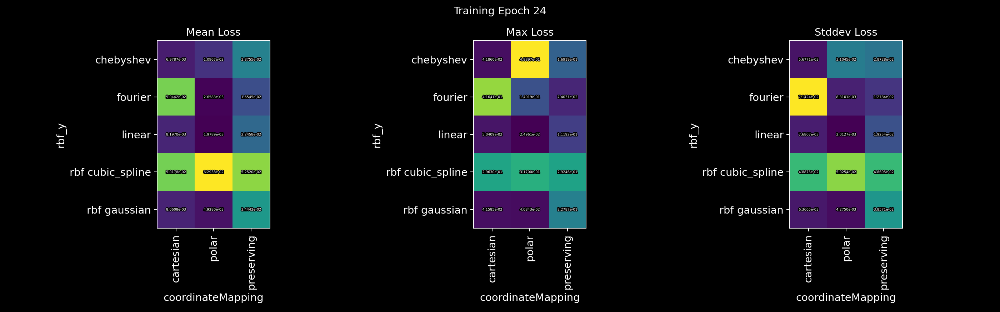

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

<function __main__.plot_func(epoch)>

In [89]:
def plotToAxis(axis, mat, label = None):
    if label is not None:
        axis.set_title(label)
    im = axis.imshow(mat, vmin=mat[np.logical_not(np.isnan(mat))].min(), vmax=mat[np.logical_not(np.isnan(mat))].max())
    for (j,i),label in np.ndenumerate(mat):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis.text(i,j,st,ha='center',va='center', color = 'white', fontsize=8, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])

    axis.set_yticks(np.arange(len(xvars)))
    axis.set_yticklabels(xvars, minor = False, rotation =0, fontsize = 12)
    axis.set_ylabel('%s' % which_x, fontsize = 12)
    axis.set_xlabel('%s' % which_y, fontsize = 12)
    axis.set_xticks(np.arange(len(yvars)))
    axis.set_xticklabels(yvars, minor = False, rotation =90, fontsize = 12)
    
    return im
    

fig, axis = plt.subplots(1, 3, figsize=(16,5), sharex = False, sharey = False, squeeze = False)

epoch = -1

meanLoss = np.ones((len(xvars),len(yvars))) * np.nan
maxLoss = np.ones((len(xvars),len(yvars))) * np.nan
stdDevLoss = np.ones((len(xvars),len(yvars))) * np.nan


for s in subfolders:
    trainingEpochLosses = trainingLosses[s]
    overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])
    
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    xi = xvars.index(xv)
    yi = yvars.index(yv)
    
    meanLoss[xi,yi] = np.mean(overallLosses[epoch,:,0])
    maxLoss[xi,yi] = np.mean(overallLosses[epoch,:,1])
    stdDevLoss[xi,yi] = np.mean(overallLosses[epoch,:,3])

txtLabels = []


fig.suptitle('Training')
    
imMean = plotToAxis(axis[0,0], meanLoss, label = 'Mean Loss')
imMax= plotToAxis(axis[0,1], maxLoss, label = 'Max Loss')
imStd = plotToAxis(axis[0,2], stdDevLoss, label = 'Stddev Loss')

fig.tight_layout()

def plot_func(epoch):
    global txtLabels
    meanLoss = np.ones((len(xvars),len(yvars))) * np.nan
    maxLoss = np.ones((len(xvars),len(yvars))) * np.nan
    stdDevLoss = np.ones((len(xvars),len(yvars))) * np.nan


    for s in subfolders:
        trainingEpochLosses = trainingLosses[s]
        overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])

        xv = dataDict[s]['hyperParameters'][which_x]
        yv = dataDict[s]['hyperParameters'][which_y]
        xi = xvars.index(xv)
        yi = yvars.index(yv)

        meanLoss[xi,yi] = np.mean(overallLosses[epoch,:,0])
        maxLoss[xi,yi] = np.mean(overallLosses[epoch,:,1])
        stdDevLoss[xi,yi] = np.mean(overallLosses[epoch,:,3])
    
#     debugPrint(meanLoss.min())
#     debugPrint(meanLoss.max())
    
    imMean.set_clim(vmin=meanLoss[np.logical_not(np.isnan(meanLoss))].min(), vmax=meanLoss[np.logical_not(np.isnan(meanLoss))].max())
    imMax.set_clim(vmin=maxLoss[np.logical_not(np.isnan(meanLoss))].min(), vmax=maxLoss[np.logical_not(np.isnan(meanLoss))].max())
    imStd.set_clim(vmin=stdDevLoss[np.logical_not(np.isnan(meanLoss))].min(), vmax=stdDevLoss[np.logical_not(np.isnan(meanLoss))].max())
    
    imMean.set_data(meanLoss)
    imMax.set_data(maxLoss)
    imStd.set_data(stdDevLoss)
    
    for lbl in txtLabels:
        lbl.remove()
    txtLabels = []
    fig.suptitle('Training Epoch %d'%epoch)
    
    for (j,i),label in np.ndenumerate(meanLoss):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis[0,0].text(i,j,st,ha='center',va='center', color = 'white', fontsize=4, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])
    for (j,i),label in np.ndenumerate(maxLoss):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis[0,1].text(i,j,st,ha='center',va='center', color = 'white', fontsize=4, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])
    for (j,i),label in np.ndenumerate(stdDevLoss):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis[0,2].text(i,j,st,ha='center',va='center', color = 'white', fontsize=4, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])
            
    fig.canvas.draw_idle()

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(plot_func, epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

<IPython.core.display.Javascript object>


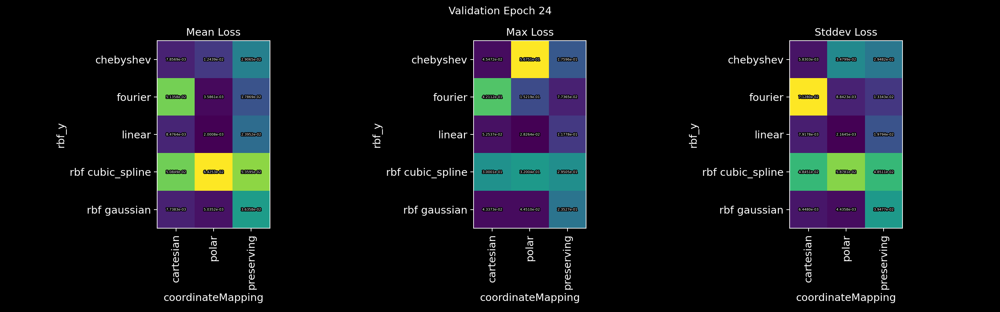

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

<function __main__.plot_func(epoch)>

In [90]:
fig, axis = plt.subplots(1, 3, figsize=(16,5), sharex = False, sharey = False, squeeze = False)

epoch = -1

meanLoss = np.ones((len(xvars),len(yvars))) * np.nan
maxLoss = np.ones((len(xvars),len(yvars))) * np.nan
stdDevLoss = np.ones((len(xvars),len(yvars))) * np.nan


for s in subfolders:
    trainingEpochLosses = validationLosses[s]
    overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])
    
    xv = dataDict[s]['hyperParameters'][which_x]
    yv = dataDict[s]['hyperParameters'][which_y]
    xi = xvars.index(xv)
    yi = yvars.index(yv)
    
    meanLoss[xi,yi] = np.mean(overallLosses[epoch,:,0])
    maxLoss[xi,yi] = np.mean(overallLosses[epoch,:,1])
    stdDevLoss[xi,yi] = np.mean(overallLosses[epoch,:,3])

txtLabels = []


fig.suptitle('Validation')
    
imMean = plotToAxis(axis[0,0], meanLoss, label = 'Mean Loss')
imMax= plotToAxis(axis[0,1], maxLoss, label = 'Max Loss')
imStd = plotToAxis(axis[0,2], stdDevLoss, label = 'Stddev Loss')

fig.tight_layout()

def plot_func(epoch):
    global txtLabels
    meanLoss = np.ones((len(xvars),len(yvars))) * np.nan
    maxLoss = np.ones((len(xvars),len(yvars))) * np.nan
    stdDevLoss = np.ones((len(xvars),len(yvars))) * np.nan


    for s in subfolders:
        trainingEpochLosses = validationLosses[s]
        overallLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])

        xv = dataDict[s]['hyperParameters'][which_x]
        yv = dataDict[s]['hyperParameters'][which_y]
        xi = xvars.index(xv)
        yi = yvars.index(yv)

        meanLoss[xi,yi] = np.mean(overallLosses[epoch,:,0])
        maxLoss[xi,yi] = np.mean(overallLosses[epoch,:,1])
        stdDevLoss[xi,yi] = np.mean(overallLosses[epoch,:,3])
    
#     debugPrint(meanLoss.min())
#     debugPrint(meanLoss.max())
    
    imMean.set_clim(vmin=meanLoss[np.logical_not(np.isnan(meanLoss))].min(), vmax=meanLoss[np.logical_not(np.isnan(meanLoss))].max())
    imMax.set_clim(vmin=maxLoss[np.logical_not(np.isnan(meanLoss))].min(), vmax=maxLoss[np.logical_not(np.isnan(meanLoss))].max())
    imStd.set_clim(vmin=stdDevLoss[np.logical_not(np.isnan(meanLoss))].min(), vmax=stdDevLoss[np.logical_not(np.isnan(meanLoss))].max())
    
    imMean.set_data(meanLoss)
    imMax.set_data(maxLoss)
    imStd.set_data(stdDevLoss)
    
    for lbl in txtLabels:
        lbl.remove()
    txtLabels = []
    fig.suptitle('Validation Epoch %d'%epoch)
    
    for (j,i),label in np.ndenumerate(meanLoss):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis[0,0].text(i,j,st,ha='center',va='center', color = 'white', fontsize=4, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])
    for (j,i),label in np.ndenumerate(maxLoss):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis[0,1].text(i,j,st,ha='center',va='center', color = 'white', fontsize=4, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])
    for (j,i),label in np.ndenumerate(stdDevLoss):
        if not np.isnan(label):
            st = '%1.4e' % label
            txtLabels.append(axis[0,2].text(i,j,st,ha='center',va='center', color = 'white', fontsize=4, rotation = 0))       
            txtLabels[-1].set_path_effects([path_effects.Stroke(linewidth=2, foreground='black'), path_effects.Normal()])
            
    fig.canvas.draw_idle()

epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
interact(plot_func, epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1))

In [116]:
from densityNet import *
simulationFiles = dataDict[subfolders[0]]['files']
# cutoff = dataDict[subfolders[0]]['hyperParameters']['cutoff']
cutoff = 1800
epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
try:
    inFile = h5py.File(simulationFiles[0], 'r')
    frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
    inFile.close()
    debugPrint(frameCount)
    if cutoff < 0:
        cutoff = frameCount - 100
except Exception:
    print('data not available defaulting to 1800')

data not available defaulting to 1800


In [91]:
networks = len(subfolders)
epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
simulationFiles = dataDict[subfolders[0]]['files']

frameCounts = []

for s in simulationFiles:    
    try:
        inFile = h5py.File(s, 'r')
        frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
        inFile.close()
        frameCounts.append(frameCount)
    except Exception:
        frameCounts.append(cutoff)

In [92]:
debugPrint(frameCounts)

frameCounts [list] = [1800, 1800]


In [93]:
# def parseSimulationData()

In [94]:
simulationData = []
for s in simulationFiles:    
    try:
        inFile = h5py.File(s, 'r')
        frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
        inFile.close()
        simulationData.append(np.zeros((len(subfolders), frameCount, epochs, 4))* np.nan) 
    except Exception:
        simulationData.append(np.zeros((len(subfolders), cutoff, epochs, 4))* np.nan) 
# debugPrint(simulationData)

In [95]:
from tqdm.notebook import tqdm

In [96]:
dataDict[subfolders[0]]['dataSet']['training']['00000']

# ['training']).shape

for si, s in tqdm(enumerate(subfolders)):
    trainingDataSet = dataDict[s]['dataSet']['training']
    validationDataSet = dataDict[s]['dataSet']['validation']
    
#     debugPrint(len(trainingDataSet))
    trainingEpochLosses = trainingLosses[s]
    validationEpochLosses = validationLosses[s]
    
    overallTrainingLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in trainingEpochLosses])
    overallValidationLosses = np.vstack([np.expand_dims(np.vstack((np.mean(e[:,:,0], axis = 1), np.max(e[:,:,1], axis = 1), np.min(e[:,:,2], axis = 1) , np.mean(e[:,:,3], axis = 1))),2).T for e in validationEpochLosses])

#     debugPrint(overallTrainingLosses.shape)
#     debugPrint(overallValidationLosses.shape)
    
    for i in tqdm(range(overallTrainingLosses.shape[1]), leave = False):
        ds = trainingDataSet['%05d' % i]
        file = ds['file']
        frame = ds['t']
        simulationData[simulationFiles.index(file)][si,frame,:] = overallTrainingLosses[:,i,:]
        
    for i in tqdm(range(overallValidationLosses.shape[1]), leave = False):
        ds = validationDataSet['%05d' % i]
        file = ds['file']
        frame = ds['t']
        simulationData[simulationFiles.index(file)][si,frame,:] = overallValidationLosses[:,i,:]
    
    

0it [00:00, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

  0%|          | 0/2600 [00:00<?, ?it/s]

  0%|          | 0/640 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>


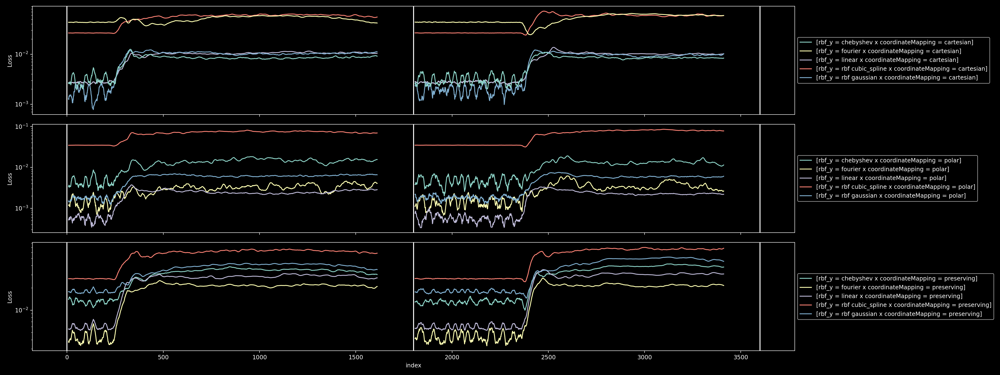

interactive(children=(IntSlider(value=24, description='epoch', max=24), Output()), _dom_classes=('widget-inter…

In [123]:

fig, axis = plt.subplots(len(yvars), 1, figsize=(24,3 * len(yvars)), sharex = True, sharey = False, squeeze = False)

epoch = -1
plotMinMax = False
smoothing = True
window_width = 17

def plotLoss(epoch):
    for i in range(len(yvars)):
        axis[i,0].cla()
        axis[i,0].set_yscale('log')
        axis[i,0].set_ylabel('Loss')

    axis[len(yvars) - 1,0].set_xlabel('index')


    cols = plt.rcParams['axes.prop_cycle'].by_key()['color']
    for n in range(len(subfolders)):
        for i in range(len(simulationData)):
            begin = 0 if i == 0 else begin + l
            end = begin + np.sum(np.logical_not(np.isnan(simulationData[i][n,:,epoch,0])))
            l = simulationData[i].shape[1]
            
            r = yvars.index(dataDict[subfolders[n]]['hyperParameters'][which_y])
            c = xvars.index(dataDict[subfolders[n]]['hyperParameters'][which_x])

            d = simulationData[i][n,:,epoch,0]
            if smoothing:
                data = d[np.logical_not(np.isnan(d))]
                cumsum_vec = np.cumsum(np.insert(data, 0, 0)) 
                data = (cumsum_vec[window_width:] - cumsum_vec[:-window_width]) / window_width
            else:
                data = d[np.logical_not(np.isnan(d))]
            
            axis[r,0].plot(np.arange(begin,end) if not smoothing else np.arange(begin + window_width // 2, end + window_width//2 - window_width + 1), data, c = cols[c % len(cols)], label = '[%s = %s x %s = %s]' % (which_x, dataDict[subfolders[n]]['hyperParameters'][which_x], which_y, dataDict[subfolders[n]]['hyperParameters'][which_y]) if i == 0 else None)
            axis[r,0].axvline(begin + l)
            axis[r,0].axvline(begin)
            if plotMinMax:
                d = simulationData[i][n,:,epoch,1]
                if smoothing:
                    data = d[np.logical_not(np.isnan(d))]
                    cumsum_vec = np.cumsum(np.insert(data, 0, 0)) 
                    data = (cumsum_vec[window_width:] - cumsum_vec[:-window_width]) / window_width
                else:
                    data = d[np.logical_not(np.isnan(d))]
                axis[r,0].plot(np.arange(begin,end) if not smoothing else np.arange(begin + window_width // 2, end + window_width//2 - window_width + 1), data, c = cols[c % len(cols)], ls = '--', alpha = 0.5)
                axis[r,0].axvline(begin + l)
                d = simulationData[i][n,:,epoch,2]
                if smoothing:
                    data = d[np.logical_not(np.isnan(d))]
                    cumsum_vec = np.cumsum(np.insert(data, 0, 0)) 
                    data = (cumsum_vec[window_width:] - cumsum_vec[:-window_width]) / window_width
                else:
                    data = d[np.logical_not(np.isnan(d))]
                axis[r,0].plot(np.arange(begin,end) if not smoothing else np.arange(begin + window_width // 2, end + window_width//2 - window_width + 1), data, c = cols[c % len(cols)], ls = '--', alpha = 0.5)
                axis[r,0].axvline(begin + l)

    for c in range(len(yvars)):
        axis[c,0].legend(loc='center left', bbox_to_anchor=(1, 0.5))
        handles, labels = axis[c,0].get_legend_handles_labels()
        labels, handles = zip(*sorted(zip(labels, handles), key=lambda t: t[0]))
        axis[c,0].legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5))
#         axis[c,0].grid(which='both', ls = ':', alpha = 0.5, axis = 'y')
    fig.canvas.draw()
    fig.canvas.flush_events()

# plotLoss(0)
    
interact(plotLoss, epoch = widgets.IntSlider(value=epochs - 1, min=0, max=epochs -1, step=1) )

fig.tight_layout()

In [ ]:


fig, axis = plt.subplots(1, 3, figsize=(12,5), sharex = False, sharey = False, squeeze = False)

def loadModel(file, frame, networkPath, epoch):
    n = dataDict[networkPath]['hyperParameters']['n']
    m = dataDict[networkPath]['hyperParameters']['m']
    coordinateMapping = dataDict[networkPath]['hyperParameters']['coordinateMapping']
    windowFn = getWindowFunction(dataDict[networkPath]['hyperParameters']['windowFunction'])
    rbf_x = dataDict[networkPath]['hyperParameters']['rbf_x']
    rbf_y = dataDict[networkPath]['hyperParameters']['rbf_y']
    dist = dataDict[networkPath]['hyperParameters']['frameDistance']
    unroll = dataDict[networkPath]['hyperParameters']['maxRollOut']

    attributes, inputData, groundTruthData = loadFrame(file, frame, 1 + np.arange(unroll), dist)
    fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)
    
    model = DensityNet(fluidFeatures.shape[1], boundaryFeatures.shape[1], coordinateMapping = coordinateMapping, n = n, m = m, windowFn = windowFn, rbf_x = rbf_x, rbf_y = rbf_y, batchSize = 32)
    model.load_state_dict(torch.load('%s/model_%03d.torch' % (networkPath, epoch)))
    model = model.to(device)
    return model
    

model = loadModel(simulationFiles[0], 0, subfolders[0], 0)
n = dataDict[subfolders[0]]['hyperParameters']['n']
m = dataDict[subfolders[0]]['hyperParameters']['m']
coordinateMapping = dataDict[subfolders[0]]['hyperParameters']['coordinateMapping']
windowFn = getWindowFunction(dataDict[subfolders[0]]['hyperParameters']['windowFunction'])
rbf_x = dataDict[subfolders[0]]['hyperParameters']['rbf_x']
rbf_y = dataDict[subfolders[0]]['hyperParameters']['rbf_y']
dist = dataDict[subfolders[0]]['hyperParameters']['frameDistance']
unroll = dataDict[subfolders[0]]['hyperParameters']['maxRollOut']

attributes, inputData, groundTruthData = loadFrame(simulationFiles[0], 0, 1 + np.arange(unroll), dist)
fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)

predictedPositions = fluidPositions.to(device)
predictedVelocity = inputData['fluidVelocity'].to(device)

modelOutput = model(fluidPositions.to(device), boundaryPositions.to(device), fluidFeatures.to(device), boundaryFeatures.to(device), attributes, None, None)

gt = groundTruthData[0]

predictedPositions, predictedVelocities = integrateState(attributes, predictedPositions, predictedVelocity, modelOutput)
loss = computeLoss(predictedPositions, predictedVelocities, groundTruthData[0].to(device), modelOutput)



axis[0,0].set_title('prediction')
x = inputData['fluidPosition'][:,0].detach().cpu().numpy()
y = inputData['fluidPosition'][:,1].detach().cpu().numpy()
v = torch.linalg.norm(modelOutput,dim=1).detach().cpu().numpy()
# debugPrint(v)
predSC = axis[0,0].scatter(x,y,c = v,s=2)
axis[0,0].axis('equal')
axis[0,0].set_xlim(-2.5,2.5)
axis[0,0].set_ylim(-2.5,2.5)
axis[0,0].axvline(-2)
axis[0,0].axvline(2)
axis[0,0].axhline(-2)
axis[0,0].axhline(2)
ax1_divider = make_axes_locatable(axis[0,0])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")

predCbar = fig.colorbar(predSC, cax=cax1,orientation='horizontal')
predCbar.ax.tick_params(labelsize=8) 


x = inputData['fluidPosition'][:,0].detach().cpu().numpy()
y = inputData['fluidPosition'][:,1].detach().cpu().numpy()

# v = (gt[:,-1:] - modelOutput) ** 2
v = torch.linalg.norm((gt[:,-1:] ),dim=1)

axis[0,1].set_title('GT')
# sc = axis[1,0].scatter(x,y,c = v,s=0.25)
GTsc = axis[0,1].scatter(x,y,c = v.detach().cpu().numpy(), s= 2)
axis[0,1].axis('equal')
axis[0,1].set_xlim(-2.5,2.5)
axis[0,1].set_ylim(-2.5,2.5)
axis[0,1].axvline(-2)
axis[0,1].axvline(2)
axis[0,1].axhline(-2)
axis[0,1].axhline(2)
ax1_divider = make_axes_locatable(axis[0,1])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
GTcbar = fig.colorbar(GTsc, cax=cax1,orientation='horizontal')
GTcbar.ax.tick_params(labelsize=8) 

fig.tight_layout()


axis[0,2].set_title('Loss')
# sc = axis[1,0].scatter(x,y,c = v,s=0.25)
lossSC = axis[0,2].scatter(x,y,c = loss.detach().cpu().numpy(), s= 2)
axis[0,2].axis('equal')
axis[0,2].set_xlim(-2.5,2.5)
axis[0,2].set_ylim(-2.5,2.5)
axis[0,2].axvline(-2)
axis[0,2].axvline(2)
axis[0,2].axhline(-2)
axis[0,2].axhline(2)
ax1_divider = make_axes_locatable(axis[0,2])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
lossCbar = fig.colorbar(lossSC, cax=cax1,orientation='horizontal')
lossCbar.ax.tick_params(labelsize=8) 

fig.suptitle('%s @ %2d -\n %s @ %5d' % (subfolders[0], epoch, simulationFiles[0], 0))
    
def plotNetwork(file, frame, networkPath, epoch):
#     axis[0,0].cla()
#     axis[0,1].cla()
#     axis[0,2].cla()
    model = loadModel(file, frame, networkPath, epoch)
    n = dataDict[networkPath]['hyperParameters']['n']
    m = dataDict[networkPath]['hyperParameters']['m']
    coordinateMapping = dataDict[networkPath]['hyperParameters']['coordinateMapping']
    windowFn = getWindowFunction(dataDict[networkPath]['hyperParameters']['windowFunction'])
    rbf_x = dataDict[networkPath]['hyperParameters']['rbf_x']
    rbf_y = dataDict[networkPath]['hyperParameters']['rbf_y']
    dist = dataDict[networkPath]['hyperParameters']['frameDistance']
    unroll = dataDict[networkPath]['hyperParameters']['maxRollOut']
    
    attributes, inputData, groundTruthData = loadFrame(file, frame, 1 + np.arange(unroll), dist)
    fluidPositions, boundaryPositions, fluidFeatures, boundaryFeatures = constructFluidFeatures(attributes, inputData)


    predictedPositions = fluidPositions.to(device)
    predictedVelocity = fluidFeatures[:,1:3].to(device)

    modelOutput = model(fluidPositions.to(device), boundaryPositions.to(device), fluidFeatures.to(device), boundaryFeatures.to(device), attributes, None, None)

    gt = groundTruthData[0]

    predictedPositions, predictedVelocities = integrateState(attributes, predictedPositions, predictedVelocity, modelOutput)
    loss = computeLoss(predictedPositions, predictedVelocities, groundTruthData[0].to(device), modelOutput)

    data = torch.linalg.norm(modelOutput,dim=1).detach().cpu().numpy()
    positions = fluidPositions.detach().cpu().numpy()
    predSC.set_offsets(positions)
    predSC.set_array(data)
    predCbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))
    
    data = torch.linalg.norm((gt[:,-1:] ),dim=1).detach().cpu().numpy()
    debugPrint(data.shape)
    positions = fluidPositions.detach().cpu().numpy()
    GTsc.set_offsets(positions)
    GTsc.set_array(data)
    GTcbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))

    data = loss.detach().cpu().numpy()[:,0]
    positions = fluidPositions.detach().cpu().numpy()
    lossSC.set_offsets(positions)
    lossSC.set_array(data)
    lossCbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))
    
    fig.suptitle('%s @ %2d -\n %s @ %5d' % (networkPath, epoch, file, frame))
    fig.canvas.draw()
    fig.canvas.flush_events()



plotNetwork(simulationFiles[0], 0, subfolders[0], epochs - 1)

interact(plotNetwork, file = simulationFiles, frame = widgets.IntSlider(value=0, min=0, max=cutoff -1, step=1), networkPath = subfolders, epoch = widgets.IntSlider(value=epochs -1, min=0, max=epochs -1, step=1), )

fig.tight_layout()

In [10]:
from densityNet import *
simulationFiles = dataDict[subfolders[0]]['files']
# cutoff = dataDict[subfolders[0]]['hyperParameters']['cutoff']
cutoff = 1800
epochs = dataDict[subfolders[0]]['hyperParameters']['epochs']
try:
    inFile = h5py.File(simulationFiles[0], 'r')
    frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
    inFile.close()
    debugPrint(frameCount)
    if cutoff < 0:
        cutoff = frameCount - 100
except Exception:
    print('data not available defaulting to 1800')

NameError: name 'dataDict' is not defined

simulationFiles [list] = ['../export/collision 0 x 2 - 2023-02-17_15-59-58.hdf5', '../export/collision 5 x 0 - 2023-02-17_16-14-02.hdf5', '../export/collision 0 x 3 - 2023-02-17_16-00-21.hdf5', '../export/collision 4 x 4 - 2023-02-17_16-12-34.hdf5', '../export/collision 3 x 5 - 2023-02-17_16-10-01.hdf5', '../export/collision 4 x 7 - 2023-02-17_16-13-40.hdf5', '../export/collision 6 x 4 - 2023-02-17_16-18-21.hdf5', '../export/collision 5 x 6 - 2023-02-17_16-16-10.hdf5', '../export/collision 1 x 0 - 2023-02-17_16-02-12.hdf5', '../export/collision 1 x 3 - 2023-02-17_16-03-20.hdf5', '../export/collision 0 x 6 - 2023-02-17_16-01-27.hdf5', '../export/collision 4 x 1 - 2023-02-17_16-11-29.hdf5', '../export/collision 4 x 2 - 2023-02-17_16-11-51.hdf5', '../export/collision 0 x 1 - 2023-02-17_15-59-36.hdf5', '../export/collision 0 x 5 - 2023-02-17_16-01-05.hdf5', '../export/collision 6 x 6 - 2023-02-17_16-19-05.hdf5', '../export/collision 5 x 7 - 2023-02-17_16-16-32.hdf5', '../export/collision 2

<IPython.core.display.Javascript object>


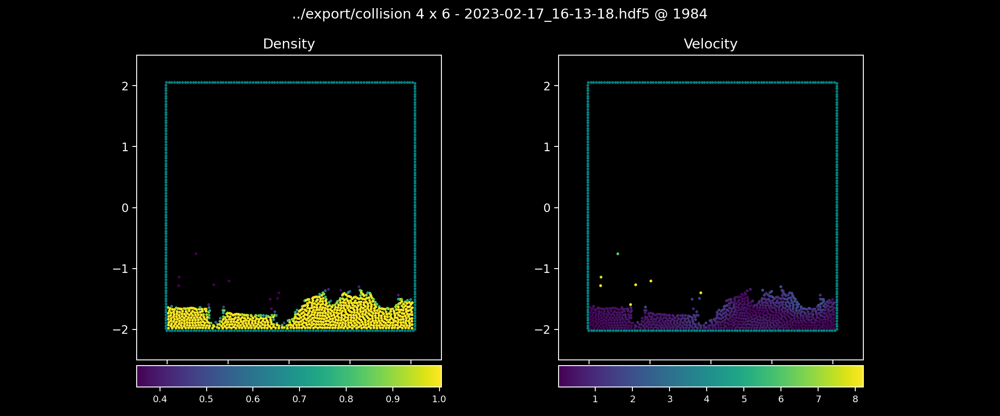

/home/winchenbach/anaconda3/envs/torch_env/lib/python3.9/site-packages/ipykernel/pylab/backend_inline.py:10: DeprecationWarning: `ipykernel.pylab.backend_inline` is deprecated, directly use `matplotlib_inline.backend_inline`
  warnings.warn(


interactive(children=(Dropdown(description='file', options=('../export/collision 0 x 2 - 2023-02-17_15-59-58.h…

In [9]:
basePath = '../export'
basePath = os.path.expanduser(basePath)

simulationFiles = [basePath + '/' + f for f in os.listdir(basePath) if f.endswith('.hdf5')]
debugPrint(simulationFiles)

fig, axis = plt.subplots(1, 2, figsize=(12,5), sharex = False, sharey = False, squeeze = False)

attributes, inputData, groundTruthData = loadFrame(simulationFiles[0], 0, 1 + np.arange(1), 1)

axis[0,0].set_title('Density')
x = inputData['fluidPosition'][:,0].detach().cpu().numpy()
y = inputData['fluidPosition'][:,1].detach().cpu().numpy()
v = (inputData['fluidDensity']).detach().cpu().numpy()
# debugPrint(v)
predSC = axis[0,0].scatter(x,y,c = v,s=2)
axis[0,0].axis('equal')
axis[0,0].set_xlim(-2.5,2.5)
axis[0,0].set_ylim(-2.5,2.5)
# axis[0,0].axvline(-2)
# axis[0,0].axvline(2)
# axis[0,0].axhline(-2)
# axis[0,0].axhline(2)
ax1_divider = make_axes_locatable(axis[0,0])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")

axis[0,0].scatter(inputData['boundaryPosition'][:,0], inputData['boundaryPosition'][:,1], c = 'teal', s =2 )

predCbar = fig.colorbar(predSC, cax=cax1,orientation='horizontal')
predCbar.ax.tick_params(labelsize=8) 


x = inputData['fluidPosition'][:,0].detach().cpu().numpy()
y = inputData['fluidPosition'][:,1].detach().cpu().numpy()

# v = (gt[:,-1:] - modelOutput) ** 2
v = torch.linalg.norm(inputData['fluidVelocity'],dim=1)

axis[0,1].set_title('Velocity')
# sc = axis[1,0].scatter(x,y,c = v,s=0.25)
GTsc = axis[0,1].scatter(x,y,c = v.detach().cpu().numpy(), s= 2)
axis[0,1].axis('equal')
axis[0,1].set_xlim(-2.5,2.5)
axis[0,1].set_ylim(-2.5,2.5)
# axis[0,1].axvline(-2)
# axis[0,1].axvline(2)
# axis[0,1].axhline(-2)
# axis[0,1].axhline(2)
axis[0,1].scatter(inputData['boundaryPosition'][:,0], inputData['boundaryPosition'][:,1], c = 'teal', s =2 )
ax1_divider = make_axes_locatable(axis[0,1])
cax1 = ax1_divider.append_axes("bottom", size="7%", pad="2%")
GTcbar = fig.colorbar(GTsc, cax=cax1,orientation='horizontal')
GTcbar.ax.tick_params(labelsize=8) 

fig.tight_layout()

def plotNetwork(file, frame):
    attributes, inputData, groundTruthData = loadFrame(file, frame, 1 + np.arange(1), 1)

    data = inputData['fluidDensity'].detach().cpu().numpy()
    positions = inputData['fluidPosition'].detach().cpu().numpy()
    predSC.set_offsets(positions)
    predSC.set_array(data)
    predCbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))
    
    data = torch.linalg.norm(inputData['fluidVelocity'],dim=1).detach().cpu().numpy()
#     debugPrint(data.shape)
    positions = inputData['fluidPosition'].detach().cpu().numpy()
    GTsc.set_offsets(positions)
    GTsc.set_array(data)
    GTcbar.mappable.set_clim(vmin=np.min(data), vmax=np.max(data))

    fig.suptitle('%s @ %2d' % (file, frame))
    fig.canvas.draw()
    fig.canvas.flush_events()



# plotNetwork(simulationFiles[0], 0, subfolders[0], epochs - 1)

interact(plotNetwork, file = simulationFiles, frame = widgets.IntSlider(value=0, min=0, max=2000 -1, step=1))

fig.tight_layout()



In [12]:
from tqdm.notebook import tqdm

In [16]:
import subprocess
import shlex

simulationFile = simulationFiles[0]

for simulationFile in tqdm(simulationFiles):
    inFile = h5py.File(simulationFile, 'r')
    frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
    inFile.close()

    imageFolder = '../images/%s/' % simulationFile.split('/')[-1].split('.')[0]
    if not os.path.exists(imageFolder):
        os.makedirs(imageFolder)
        for i in tqdm(range(0, frameCount, 16), leave = False):
            plotNetwork(simulationFile, i)
            imagePath = '../images/%s/%04d.png' % (simulationFile.split('/')[-1].split('.')[0], i)
            plt.savefig(imagePath, dpi = 200)
#         print('Creating video file')
        p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -framerate 60 -f image2 -pattern_type glob -i '*.png' -c:v libx264 -b:v 20M -r 60 out.mp4"), cwd='../images/%s/' % simulationFile.split('/')[-1].split('.')[0])
        p.wait()
#         print('Creating video gif')
        p = subprocess.Popen(shlex.split("/usr/bin/ffmpeg -y -hide_banner -loglevel error -i out.mp4 -filter_complex 'fps=60,scale=720:-1:flags=lanczos,split[s0][s1];[s0]palettegen=max_colors=32[p];[s1][p]paletteuse=dither=bayer' output.gif"), cwd='../images/%s/' % simulationFile.split('/')[-1].split('.')[0])
        p.wait()
#         print('Copying output')
        p = subprocess.Popen(shlex.split('cp output.gif ../%s.gif' % ' '.join(simulationFile.split('/')[-1].split(' ')[:-2]).replace(' ','_')), cwd = '../images/%s/' % simulationFile.split('/')[-1].split('.')[0])
        p.wait()
    else:
        print('nothing to do for %s' % simulationFile)


  0%|          | 0/65 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

  0%|          | 0/125 [00:00<?, ?it/s]

In [15]:
import subprocess
import shlex


In [27]:
import subprocess
import shlex

simulationFile = simulationFiles[0]

for simulationFile in tqdm(simulationFiles):
    inFile = h5py.File(simulationFile, 'r')
    frameCount = int(len(inFile['simulationExport'].keys()) -1) # adjust for bptcls
    inFile.close()

    imageFolder = '../images/%s/' % simulationFile.split('/')[-1].split('.')[0]
    p = subprocess.Popen(shlex.split('cp output.gif ../%s.gif' % ' '.join(simulationFile.split('/')[-1].split(' ')[:-2]).replace(' ','_')), cwd = '../images/%s/' % simulationFile.split('/')[-1].split('.')[0])
    p.wait()

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 64/64 [00:01<00:00, 47.36it/s]


In [19]:
shlex.split(' '.join('cp output.gif ../%s.gif' % simulationFiles[0].split('/')[-1].split(' ')[:-2]).split('.')[0].replace(' ', '_'))

['c_p___o_u_t_p_u_t_']

In [25]:
('cp output.gif ../%s.gif' % ' '.join(simulationFiles[0].split('/')[-1].split(' ')[:-2]).replace(' ','_'))

'cp output.gif ../collision_2_x_1.gif'